In [1]:
import math
import pandas as pd
import tensorflow as tf
# import keras_tuner.tuners as kt
import matplotlib.pyplot as plt
import keras
from tensorflow.keras import Model
from tensorflow.keras import Sequential
from sklearn.preprocessing import StandardScaler
from tensorflow.keras.layers import Dense, Dropout
from sklearn.model_selection import train_test_split
from tensorflow.keras.losses import MeanSquaredLogarithmicError
import numpy as np
import pickle
np.random.seed(123)
from tensorflow.keras import Input
from tensorflow.keras.layers import Conv1D, Conv2D, LeakyReLU, MaxPool1D, AveragePooling1D, UpSampling1D, Flatten, Dense, Reshape, BatchNormalization
# https://towardsdatascience.com/improve-your-model-performance-with-auto-encoders-d4ee543b4154
from tensorflow.keras import initializers
from sklearn.decomposition import PCA
from matplotlib.pyplot import figure
from scipy.spatial.distance import cdist
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score

import matplotlib.pyplot as plt
import matplotlib.cm as cm
import numpy as np
from keras.wrappers.scikit_learn import KerasRegressor
from sklearn.model_selection import GridSearchCV

from keras.optimizers import Adam, SGD, Adadelta
from sklearn.metrics import accuracy_score, f1_score

In [2]:
x_train_scaled = pd.read_csv('data/260_sample_train_scaled.csv').set_index("Patient_ID")
x_train_scaled

,AADAC,APOA1,APOA4,APOB,APOC3,AQP9,C6,CEACAM7,CHI3L1,ABCC2,...,HDLBP,PIAS4,ADH1B,LOC100507531,FAM83A,NXF4,RNF125,DARS,DNAI1,MBTPS1
Patient_ID,,,,,,,,,,,,,,,,,,,,,
55_control,0.702813,0.799052,0.719665,0.729547,0.794953,0.256451,1.000000,0.363133,0.374212,0.611161,...,0.308725,0.235825,0.566757,0.982782,0.707526,1.000000,0.410887,0.671068,1.000000,0.438527
168_CD_plain,0.751408,0.603707,0.622768,0.627712,0.606860,0.520576,0.311962,0.251356,0.553554,0.441131,...,0.000000,0.000000,0.861588,0.000000,0.640911,0.020238,0.220356,0.632252,0.000000,0.488578
72_control,0.786508,0.755331,0.739605,0.756170,0.819875,0.391132,0.648401,0.134017,0.200420,0.679453,...,0.491401,0.279122,0.555258,0.000000,0.392175,0.000000,0.116289,0.000000,0.260194,0.531400
120_control,0.707491,0.662993,0.648072,0.764621,0.654276,0.633929,0.579519,0.248934,0.759250,0.755407,...,0.604918,0.598850,0.621841,0.000000,0.519941,0.000000,0.342185,0.416527,0.000000,0.545708
258_CD_plain,0.701039,0.662511,0.707208,0.834562,0.670160,0.410612,0.370517,0.244987,0.445387,0.798000,...,0.470835,0.670696,0.555250,0.000000,0.390923,0.000000,0.498504,0.449224,0.000000,0.689242
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15_CD_plain,0.382762,0.384030,0.377332,0.360165,0.300915,0.340090,0.077348,0.890965,0.261140,0.205779,...,0.669319,0.770253,0.702931,0.000000,0.451846,0.000000,0.319644,0.549587,0.000000,0.935108
182_CD_plain,0.679910,0.584723,0.722426,0.643867,0.740014,0.650358,0.468650,0.295686,0.649939,0.609862,...,0.747236,0.742399,0.730485,0.000000,0.680460,0.000000,0.280413,0.529434,0.000000,0.606330
164_CD_plain,0.754656,0.556562,0.694062,0.748334,0.535534,0.133869,0.319071,0.154562,0.440487,0.824013,...,0.422981,0.769213,0.625325,0.000000,0.374319,0.000000,0.396084,0.590976,0.238307,0.753111


In [3]:
x_test_scaled = pd.read_csv('data/260_sample_test_scaled.csv').set_index("Patient_ID")
x_test_scaled

,AADAC,APOA1,APOA4,APOB,APOC3,AQP9,C6,CEACAM7,CHI3L1,ABCC2,...,HDLBP,PIAS4,ADH1B,LOC100507531,FAM83A,NXF4,RNF125,DARS,DNAI1,MBTPS1
Patient_ID,,,,,,,,,,,,,,,,,,,,,
253_CD_plain,0.869185,0.841880,0.930171,0.886737,0.835678,0.297964,0.668498,0.266670,0.278122,0.933520,...,0.775985,0.973492,0.472825,0.0,0.269797,0.0,0.539781,0.290165,0.000000,0.722611
105_CD_plain,0.853562,0.933532,0.942213,0.794578,0.890482,0.206529,0.298987,0.350745,0.495663,0.849038,...,0.582213,0.531660,0.540145,0.0,0.322049,0.0,0.303573,0.133159,0.000000,0.537012
2_CD_plain,0.165531,0.141475,0.263684,0.198091,0.160503,0.888878,0.000000,0.134461,0.989132,0.202203,...,0.907365,0.736128,-0.336653,0.0,-0.069528,0.0,0.176989,0.766373,0.000000,1.094845
184_CD_plain,0.717121,0.660314,0.769417,0.752737,0.694874,0.514735,0.692365,0.271127,0.650742,0.694599,...,0.648501,0.789699,0.836996,0.0,0.285660,0.0,0.320280,0.488913,0.000000,0.674738
312_CD_plain,0.730072,0.722909,0.713076,0.743545,0.679258,0.308459,0.399235,0.129019,0.597529,0.720390,...,0.493294,0.566990,0.807264,0.0,0.471971,0.0,0.462733,0.508932,0.000000,0.693707
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
107_CD_plain,0.736123,0.658232,0.772323,0.685637,0.658755,0.250970,0.247307,0.422075,0.555944,0.603675,...,0.550182,0.719685,0.701615,0.0,0.225656,0.0,0.295914,0.701896,0.000000,0.709542
279_CD_plain,0.220614,0.202090,0.182810,0.113245,0.105744,0.699851,0.000000,0.908485,0.688912,0.178259,...,0.819116,0.689739,0.213157,0.0,0.969447,0.0,0.134090,0.710444,0.000000,0.846294
179_CD_plain,0.724476,0.726774,0.766943,0.776284,0.690339,0.380637,0.440449,0.318944,0.558600,0.738787,...,0.417027,0.734039,0.683655,0.0,0.369566,0.0,0.405814,0.575430,0.000000,0.653918


In [4]:
full_ds = pd.concat([x_train_scaled, x_test_scaled])
full_ds

,AADAC,APOA1,APOA4,APOB,APOC3,AQP9,C6,CEACAM7,CHI3L1,ABCC2,...,HDLBP,PIAS4,ADH1B,LOC100507531,FAM83A,NXF4,RNF125,DARS,DNAI1,MBTPS1
Patient_ID,,,,,,,,,,,,,,,,,,,,,
55_control,0.702813,0.799052,0.719665,0.729547,0.794953,0.256451,1.000000,0.363133,0.374212,0.611161,...,0.308725,0.235825,0.566757,0.982782,0.707526,1.000000,0.410887,0.671068,1.000000,0.438527
168_CD_plain,0.751408,0.603707,0.622768,0.627712,0.606860,0.520576,0.311962,0.251356,0.553554,0.441131,...,0.000000,0.000000,0.861588,0.000000,0.640911,0.020238,0.220356,0.632252,0.000000,0.488578
72_control,0.786508,0.755331,0.739605,0.756170,0.819875,0.391132,0.648401,0.134017,0.200420,0.679453,...,0.491401,0.279122,0.555258,0.000000,0.392175,0.000000,0.116289,0.000000,0.260194,0.531400
120_control,0.707491,0.662993,0.648072,0.764621,0.654276,0.633929,0.579519,0.248934,0.759250,0.755407,...,0.604918,0.598850,0.621841,0.000000,0.519941,0.000000,0.342185,0.416527,0.000000,0.545708
258_CD_plain,0.701039,0.662511,0.707208,0.834562,0.670160,0.410612,0.370517,0.244987,0.445387,0.798000,...,0.470835,0.670696,0.555250,0.000000,0.390923,0.000000,0.498504,0.449224,0.000000,0.689242
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
107_CD_plain,0.736123,0.658232,0.772323,0.685637,0.658755,0.250970,0.247307,0.422075,0.555944,0.603675,...,0.550182,0.719685,0.701615,0.000000,0.225656,0.000000,0.295914,0.701896,0.000000,0.709542
279_CD_plain,0.220614,0.202090,0.182810,0.113245,0.105744,0.699851,0.000000,0.908485,0.688912,0.178259,...,0.819116,0.689739,0.213157,0.000000,0.969447,0.000000,0.134090,0.710444,0.000000,0.846294
179_CD_plain,0.724476,0.726774,0.766943,0.776284,0.690339,0.380637,0.440449,0.318944,0.558600,0.738787,...,0.417027,0.734039,0.683655,0.000000,0.369566,0.000000,0.405814,0.575430,0.000000,0.653918


In [5]:
x_test_scaled.isnull().values.any()

False

In [6]:
# np.random.seed(37)
# full_ds = full_ds.sample(frac=1)

In [7]:
val_split_pt = int(0.85*len(full_ds))
split_pt = int(0.7*len(full_ds))

In [8]:
train_set = full_ds[:split_pt]
val_set = full_ds[split_pt:val_split_pt]
test_set = full_ds[val_split_pt:]

In [9]:
train_set

,AADAC,APOA1,APOA4,APOB,APOC3,AQP9,C6,CEACAM7,CHI3L1,ABCC2,...,HDLBP,PIAS4,ADH1B,LOC100507531,FAM83A,NXF4,RNF125,DARS,DNAI1,MBTPS1
Patient_ID,,,,,,,,,,,,,,,,,,,,,
55_control,0.702813,0.799052,0.719665,0.729547,0.794953,0.256451,1.000000,0.363133,0.374212,0.611161,...,0.308725,0.235825,0.566757,0.982782,0.707526,1.000000,0.410887,0.671068,1.000000,0.438527
168_CD_plain,0.751408,0.603707,0.622768,0.627712,0.606860,0.520576,0.311962,0.251356,0.553554,0.441131,...,0.000000,0.000000,0.861588,0.000000,0.640911,0.020238,0.220356,0.632252,0.000000,0.488578
72_control,0.786508,0.755331,0.739605,0.756170,0.819875,0.391132,0.648401,0.134017,0.200420,0.679453,...,0.491401,0.279122,0.555258,0.000000,0.392175,0.000000,0.116289,0.000000,0.260194,0.531400
120_control,0.707491,0.662993,0.648072,0.764621,0.654276,0.633929,0.579519,0.248934,0.759250,0.755407,...,0.604918,0.598850,0.621841,0.000000,0.519941,0.000000,0.342185,0.416527,0.000000,0.545708
258_CD_plain,0.701039,0.662511,0.707208,0.834562,0.670160,0.410612,0.370517,0.244987,0.445387,0.798000,...,0.470835,0.670696,0.555250,0.000000,0.390923,0.000000,0.498504,0.449224,0.000000,0.689242
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15_CD_plain,0.382762,0.384030,0.377332,0.360165,0.300915,0.340090,0.077348,0.890965,0.261140,0.205779,...,0.669319,0.770253,0.702931,0.000000,0.451846,0.000000,0.319644,0.549587,0.000000,0.935108
182_CD_plain,0.679910,0.584723,0.722426,0.643867,0.740014,0.650358,0.468650,0.295686,0.649939,0.609862,...,0.747236,0.742399,0.730485,0.000000,0.680460,0.000000,0.280413,0.529434,0.000000,0.606330
164_CD_plain,0.754656,0.556562,0.694062,0.748334,0.535534,0.133869,0.319071,0.154562,0.440487,0.824013,...,0.422981,0.769213,0.625325,0.000000,0.374319,0.000000,0.396084,0.590976,0.238307,0.753111


### Dimensionality reduction with PCA

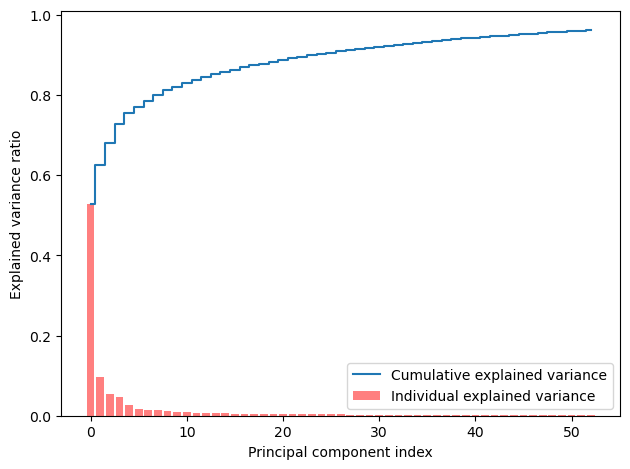

In [10]:
#https://vitalflux.com/pca-explained-variance-concept-python-example/#google_vignette

pca = PCA()
pca = PCA(n_components=.96)
#
# Determine transformed features
#
X_train_pca = pca.fit_transform(train_set)
#
# Determine explained variance using explained_variance_ration_ attribute
#
exp_var_pca = pca.explained_variance_ratio_
#
# Cumulative sum of eigenvalues; This will be used to create step plot
# for visualizing the variance explained by each principal component.
#
cum_sum_eigenvalues = np.cumsum(exp_var_pca)
#
# Create the visualization plot
#
plt.bar(range(0,len(exp_var_pca)), exp_var_pca, alpha=0.5, align='center', color='r',label='Individual explained variance')
plt.step(range(0,len(cum_sum_eigenvalues)), cum_sum_eigenvalues, where='mid',label='Cumulative explained variance')
plt.ylabel('Explained variance ratio')
plt.xlabel('Principal component index')
plt.legend(loc='best')
plt.tight_layout()
plt.show()

In [11]:
# https://www.datacamp.com/tutorial/principal-component-analysis-in-python

def encode_pca(dataset):
    pca_x_test = PCA(n_components=32)
    principalComponents_x_test = pca_x_test.fit_transform(dataset)
    if isinstance(dataset,np.ndarray):
        index = None
    else:
        index=dataset.index
    pca_x_test_ds = pd.DataFrame(data = principalComponents_x_test, 
                                       index=index)
    return pca_x_test_ds, pca_x_test

# full_pca_dataset, pca_x = encode_pca(full_ds)
# split_pt = int(0.7 * len(full_pca_dataset))
# pca_test_dataset = full_pca_dataset[split_pt:]
# pca_train_dataset = full_pca_dataset[:split_pt]

In [12]:
full_pca_dataset, pca_x = encode_pca(full_ds)
pca_train_dataset = full_pca_dataset[:split_pt]
pca_val_dataset = full_pca_dataset[split_pt:val_split_pt]
pca_test_dataset = full_pca_dataset[val_split_pt:]

In [13]:
train_patient_ids = np.array(pca_train_dataset.index)
val_patient_ids = np.array(pca_val_dataset.index)
test_patient_ids = np.array(pca_test_dataset.index)

In [14]:
train_patient_ids.shape

(182,)

In [15]:
val_patient_ids.shape

(39,)

In [16]:
test_patient_ids.shape

(39,)

In [17]:
# pca_train_dataset.to_csv("pca_train_dataset.csv")

In [18]:
print('Explained variation per principal component: {}'.format(pca_x.explained_variance_ratio_))
print("Total variance explained:",np.sum(pca_x.explained_variance_ratio_))

Explained variation per principal component: [0.53112694 0.08953467 0.05690518 0.04343321 0.03161113 0.0161957
 0.01522149 0.0133907  0.01024134 0.0089587  0.00836116 0.00785337
 0.00678376 0.00610539 0.00589868 0.00548949 0.00512124 0.00477333
 0.00472984 0.00440751 0.00416521 0.00389001 0.00384853 0.00367727
 0.00347579 0.00325876 0.00311362 0.00297802 0.00282803 0.00277358
 0.0026678  0.00255771]
Total variance explained: 0.9153771541811655


In [19]:
# pc1_var, pc2_var = np.round(pca_x_test.explained_variance_ratio_ * 100, 1)
# pc1_var

### Dimensionality reduction with autoencoder

In [20]:
def load_encoder():
    n_inputs = 220
    n_bottleneck = 32
    encoder = Sequential(
                [

#                     Input(shape=(n_inputs,)),
                    # encoder level 1
                    Dense(n_inputs*2),
                    BatchNormalization(),
                    LeakyReLU(),
                    # encoder level 2
                    Dense(n_inputs),
                    BatchNormalization(),
                    LeakyReLU(),
                    # bottleneck
                    Dense(n_bottleneck)
                ]
            )

    sh = test_set.head(1).shape
    encoder.load_weights("data/models/cd_encoder")
    encoder.build(sh) 
#     encoder.summary()
    return encoder

In [21]:
def ae_encode_dataset(dataset):
    encoder = load_encoder()
    latent_var = np.arange(32)
    print(type(dataset))
    if isinstance(dataset,np.ndarray):
        recon = encoder(dataset)
        index=None
    else:
        recon = encoder(dataset.values)
        index = dataset.index
    r = pd.DataFrame(recon, columns=latent_var, index=index)
    return r
    
full_ae_dataset = ae_encode_dataset(full_ds)

# split_pt = int(0.7 * len(full_ae_dataset))
# ae_test_dataset = full_ae_dataset[split_pt:]
# ae_train_dataset = full_ae_dataset[:split_pt]

<class 'pandas.core.frame.DataFrame'>


In [22]:
# ae_train_dataset

## True labels

In [23]:
def classify(x):
    if "_control" in x: # control
        return 0
    elif "CD_plain" in x: # Crohn's Disease no deep ulcer
#         print(x)
        return 1
    elif "CD_deep_ulcer" in x: # Crohn's Disease deep ulcer
#         print(x)
        return 2
    else:
        return 3 # Ulcerative Collitis

vec = np.vectorize(classify)

train_disease_labels = vec(train_patient_ids)
val_disease_labels = vec(val_patient_ids)
test_disease_labels = vec(test_patient_ids)

In [24]:
full_disease_labels = np.concatenate([train_disease_labels, val_disease_labels, test_disease_labels])

In [25]:
full_disease_labels.shape

(260,)

In [26]:
with open("data/d_labels", "wb") as fp:   #Pickling
    pickle.dump(full_disease_labels, fp)

In [27]:
import matplotlib.pyplot as plt

from matplotlib.ticker import NullFormatter
from sklearn import manifold, datasets
from time import time

## KMeans clustering

### Fit KMeans (PCA & tSNE dimensionality reduction)

In [28]:
def compute_silh_scores(datapoints, cluster_labels):
    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(datapoints, cluster_labels)


    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(datapoints, cluster_labels)
    
    return silhouette_avg, sample_silhouette_values

def plot_silhouette(n_clusters, cluster_labels, sample_silhouette_values, silhouette_avg, ax):
    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax.fill_betweenx(
            np.arange(y_lower, y_upper),
            0,
            ith_cluster_silhouette_values,
            facecolor=color,
            edgecolor=color,
            alpha=0.7,
        )

        # Label the silhouette plots with their cluster numbers at the middle
        ax.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax.set_title("The silhouette plot for the various clusters.")
    ax.set_xlabel("The silhouette coefficient values")
    ax.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax.set_yticks([])  # Clear the yaxis labels / ticks
    ax.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

In [29]:
train_disease_labels.shape

(182,)

In [30]:
# https://jakevdp.github.io/PythonDataScienceHandbook/05.12-gaussian-mixtures.html


def plot_kmeans(X, X_val, disease_labels, val_disease_labels, k_labels, k_labels_val, centers, radii, reduction, num_c=4, test_set=True, plot_sil=False):

    num_rows = 2 if plot_sil else 1
    dim_h = 12 if plot_sil else 6
    dim_w = 15 if plot_sil else 15
    (fig, subplots) = plt.subplots(num_rows, 2, figsize=(dim_w, dim_h))
    


    label_sets = [k_labels, disease_labels]
    num_clusters = 3
    dset = "test" if test_set else "train"


    for i, label_set in enumerate(label_sets):
        
        ax = subplots[0][i] if plot_sil else subplots[i]

        dset = "test" if test_set else "train"

        if i==0:
            num_clusters = num_c
            cluster_names = ["Cluster " + str(i) for i in range(num_clusters)]
            colours = ["chocolate", "darkblue", "magenta", "yellow", "blue"]
            ax.set_title("KMeans clustering on " + dset + " set with cluster labels shown \n (" + reduction + " dimensionality reduction)",
                         wrap=True)
        else:
            num_clusters = 3
            cluster_names = ["Control", "CD no ulcer", "CD deep ulcer"]
            colours = ["green", "orange", "red"]
            ax.set_title("KMeans clustering on " + dset + " set with true labels shown \n (" + reduction + " dimensionality reduction)",
                         wrap=True)
        for i in range(num_clusters):
            ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2) 



        for c, r in zip(centers, radii):
            ax.add_patch(plt.Circle(c, r, fc='#CCCCCC', lw=3, alpha=0.5, zorder=1))

#         if selected_patient_idx is not None:
#             ax.scatter(Y[selected_patient_idx, 0], Y[selected_patient_idx, 1], c="cyan", s=400, marker='*',edgecolor='black', linewidth=.7, label="Selected patient")

        ax.legend()

        ax.axis("tight")
        
    if plot_sil:
        silhouette_avg, sample_silhouette_values = compute_silh_scores(X_val, k_labels_val)
        plot_silhouette(num_c, k_labels_val, sample_silhouette_values, silhouette_avg, subplots[1][0])
        acc = accuracy_score(val_disease_labels, k_labels_val)
        f1 = f1_score(val_disease_labels, k_labels_val, average='weighted')
        ax = subplots[1][1]
        num_clusters = num_c
        cluster_names = ["Cluster " + str(i) for i in range(num_clusters)]
        colours = ["chocolate", "darkblue", "magenta", "yellow", "blue"]
        ax.set_title("KMeans clustering on validation set with cluster labels shown \n (" + reduction + " dimensionality reduction)",
                     wrap=True)
        for i in range(num_clusters):
            ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2) 
        for c, r in zip(centers, radii):
            ax.add_patch(plt.Circle(c, r, fc='#CCCCCC', lw=3, alpha=0.5, zorder=1))

        ax.legend()

    
    plt.show()
    if plot_sil:
        print("The average silhouette_score is :",silhouette_avg)
        print("Accuracy:",acc)
        print("F1 score:",f1)
        
        return silhouette_avg, acc, f1
        




### Training

In [31]:
def train_kmeans(full_dataset, perplexity):
    # compress to 2D with tSNE
    tsne = manifold.TSNE(
        n_components=2,
        init="random",
        random_state=0,
        perplexity=perplexity,
        n_iter=750,
        method='exact'
    )
    X = tsne.fit_transform(full_dataset)
    split_pt = int(0.85 * len(full_dataset))
    val_split_pt = int(0.7 * len(full_dataset))
    X_test = X[split_pt:]
    X_train = X[:val_split_pt]
    X_val = X[val_split_pt:split_pt]
    # X_train = np.concatenate([X[:split_pt], X[-num_c:]])

    num_c=4
    kmeans = KMeans(num_c, random_state=0).fit(X_train)
    k_labels_train = kmeans.predict(X_train)
    k_labels_val = kmeans.predict(X_val)
    k_labels_test = kmeans.predict(X_test)


    # representation of the KMeans model (both)
    # centers = X[-num_c:]
    centers = kmeans.cluster_centers_
    radii = [cdist(X_train[k_labels_train == i], [center]).max()
             for i, center in enumerate(centers)]
    
    return kmeans, X_train, X_val, X_test, k_labels_train, k_labels_val, k_labels_test, centers, radii

In [32]:
def plot_val_scores(sil_scores, acc_scores, f1_scores, reduction):
    plt.figure()
    plt.plot(perplexities, sil_scores, label="Avg silhouette score")
    plt.plot(perplexities, acc_scores, label="Accuracy")
    plt.plot(perplexities, f1_scores, label="F1-score")
    plt.xlabel("Perplexity")
    plt.ylabel("Score")
    plt.title("Effect of tSNE perplexity value on clustering evaluation over validation set ("+reduction+" reduction)")

    plt.legend()
    plt.show()

In [33]:
np.arange(0, 251, 10)[1:]

array([ 10,  20,  30,  40,  50,  60,  70,  80,  90, 100, 110, 120, 130,
       140, 150, 160, 170, 180, 190, 200, 210, 220, 230, 240, 250])

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Perplexity = 10


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


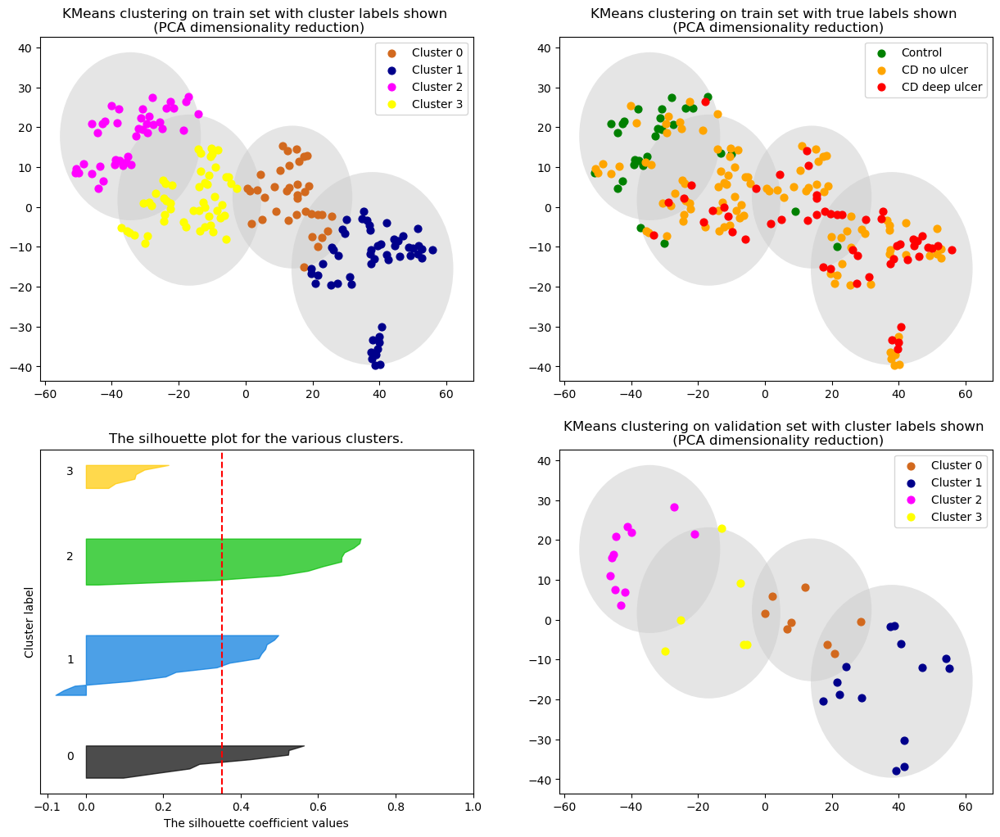

The average silhouette_score is : 0.35074526
Accuracy: 0.20512820512820512
F1 score: 0.24612907221602873


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Perplexity = 20


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


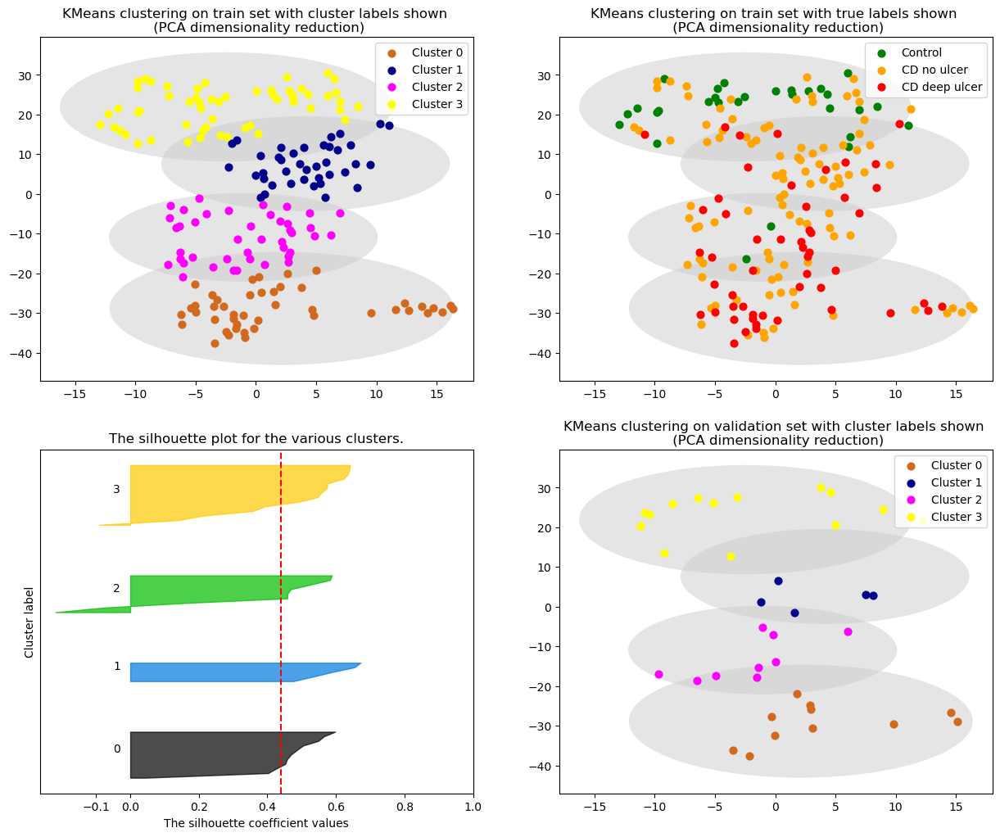

The average silhouette_score is : 0.4390966
Accuracy: 0.20512820512820512
F1 score: 0.284357617690951


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Perplexity = 30


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


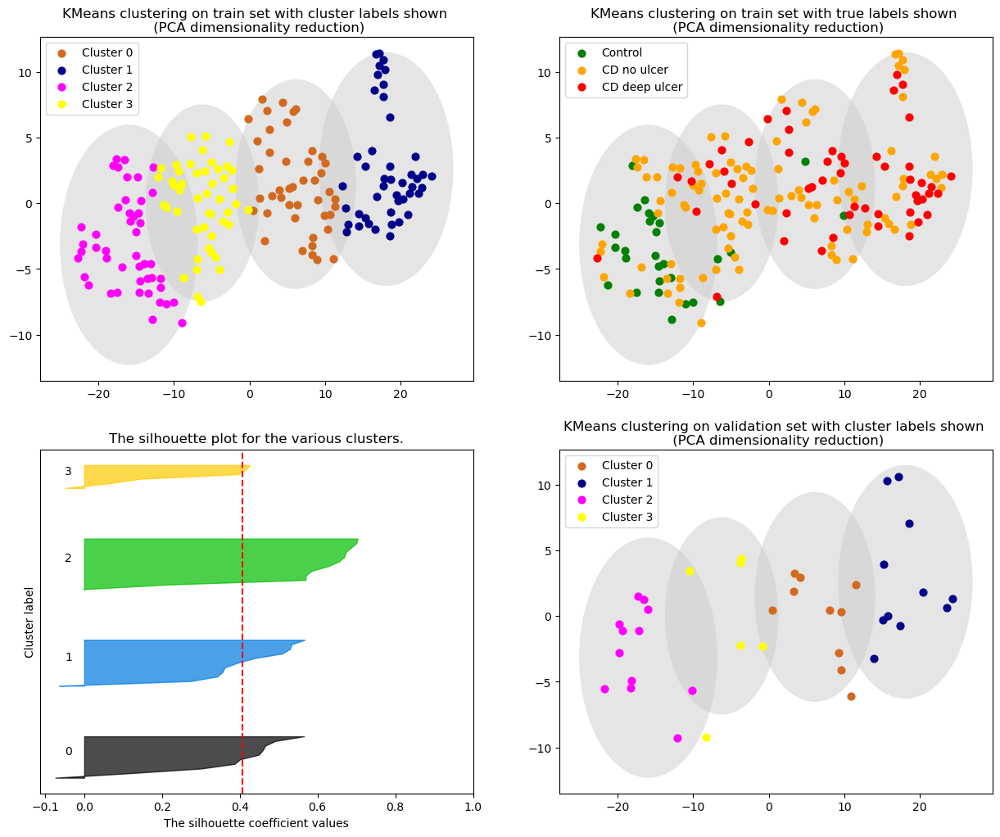

The average silhouette_score is : 0.4062845
Accuracy: 0.15384615384615385
F1 score: 0.19658119658119658


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Perplexity = 40


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


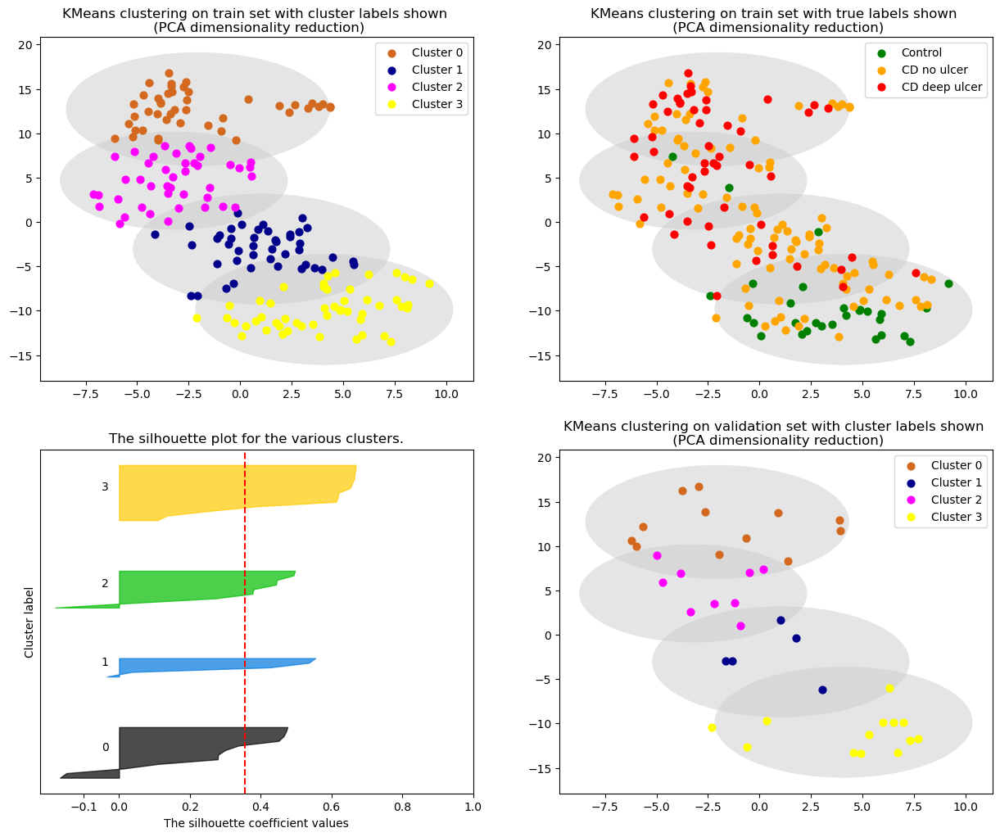

The average silhouette_score is : 0.35544485
Accuracy: 0.20512820512820512
F1 score: 0.284357617690951


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Perplexity = 50


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


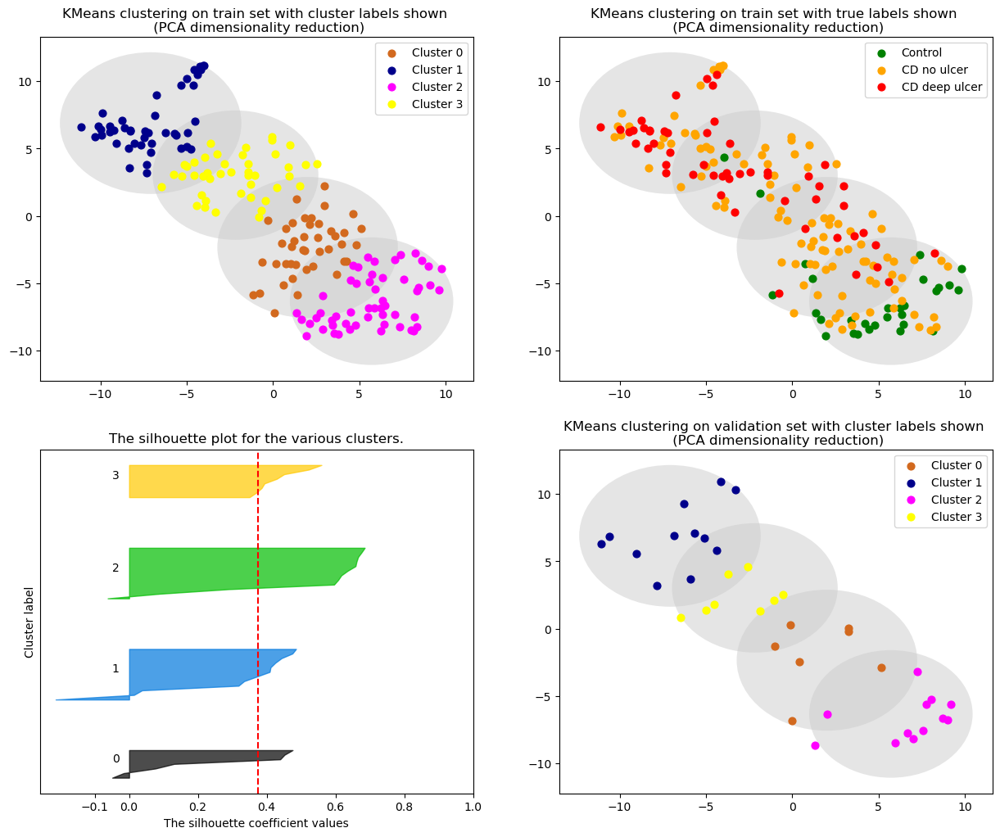

The average silhouette_score is : 0.3742644
Accuracy: 0.15384615384615385
F1 score: 0.19155354449472098


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Perplexity = 60


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


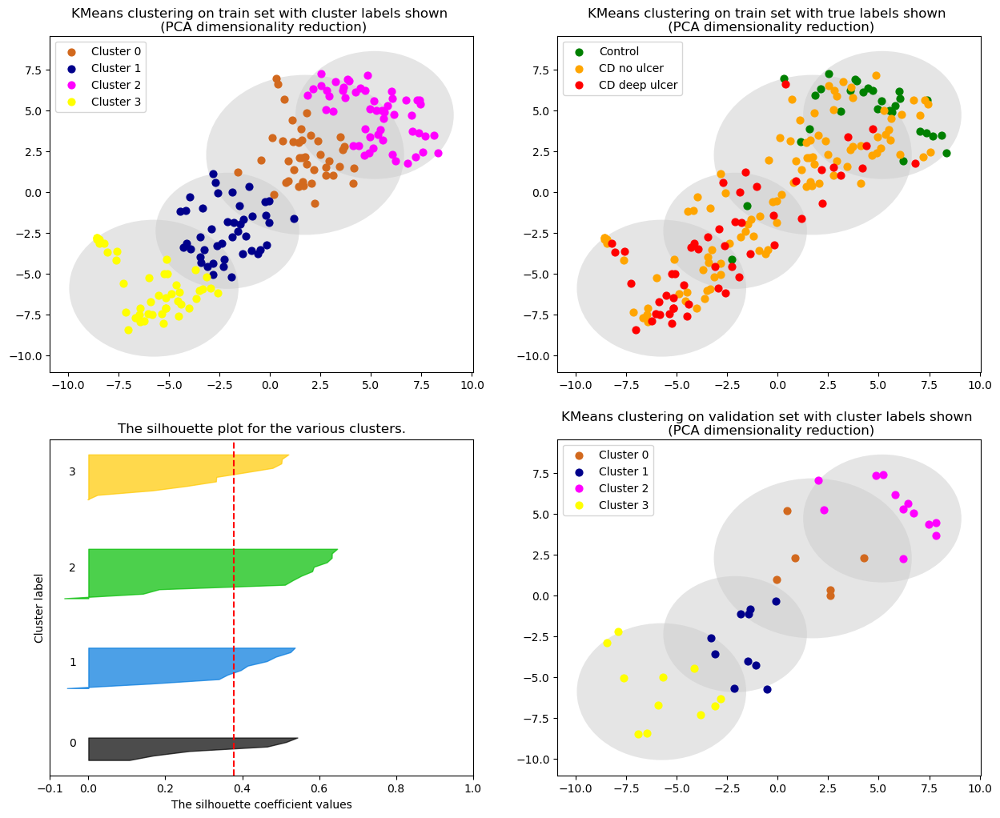

The average silhouette_score is : 0.37866944
Accuracy: 0.1794871794871795
F1 score: 0.23717948717948714


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Perplexity = 70


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


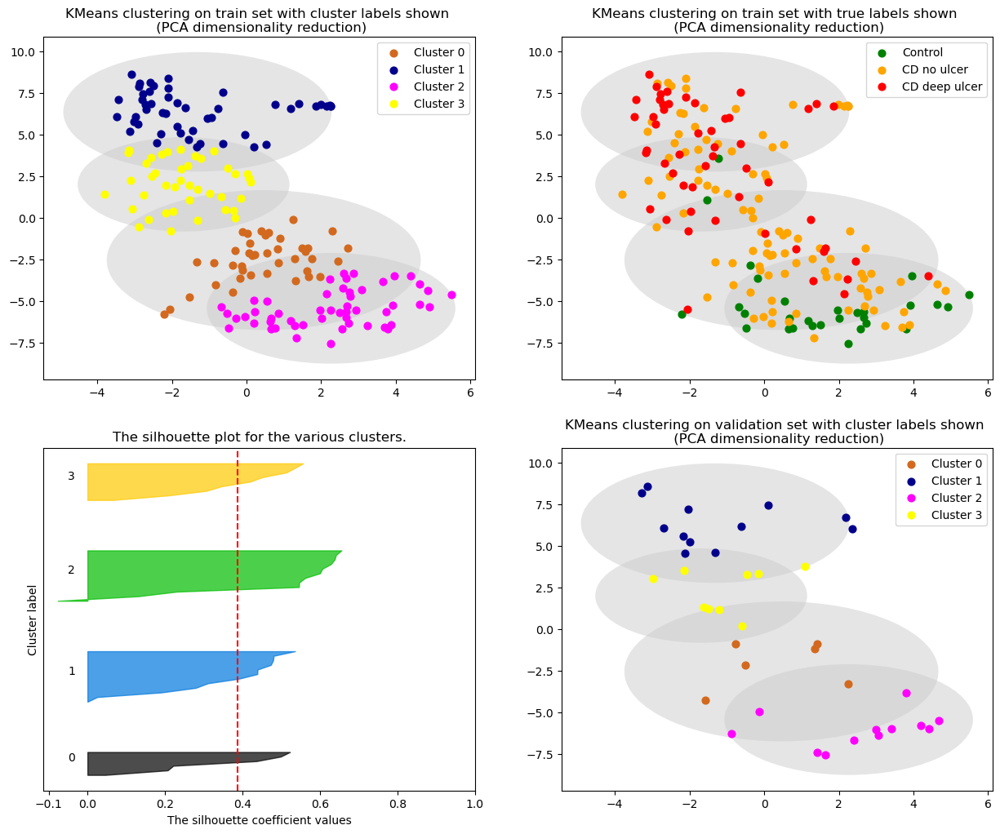

The average silhouette_score is : 0.38677424
Accuracy: 0.15384615384615385
F1 score: 0.19155354449472098


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Perplexity = 80


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


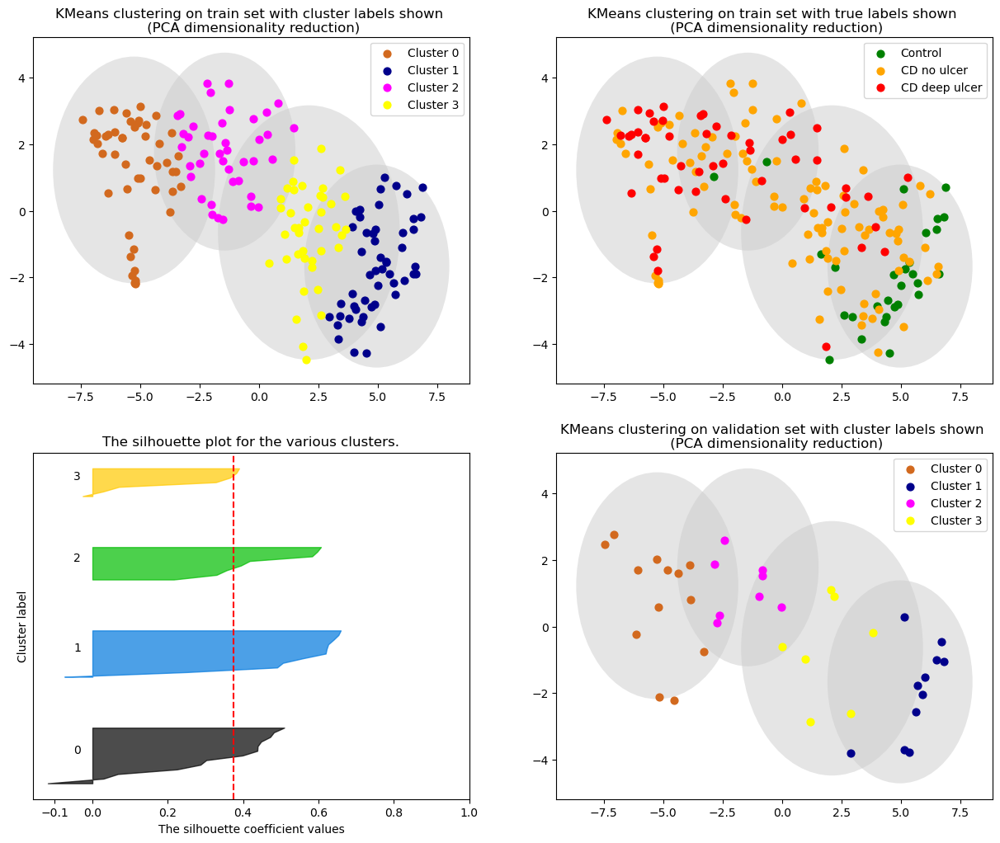

The average silhouette_score is : 0.37343544
Accuracy: 0.20512820512820512
F1 score: 0.2632478632478632


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Perplexity = 90


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


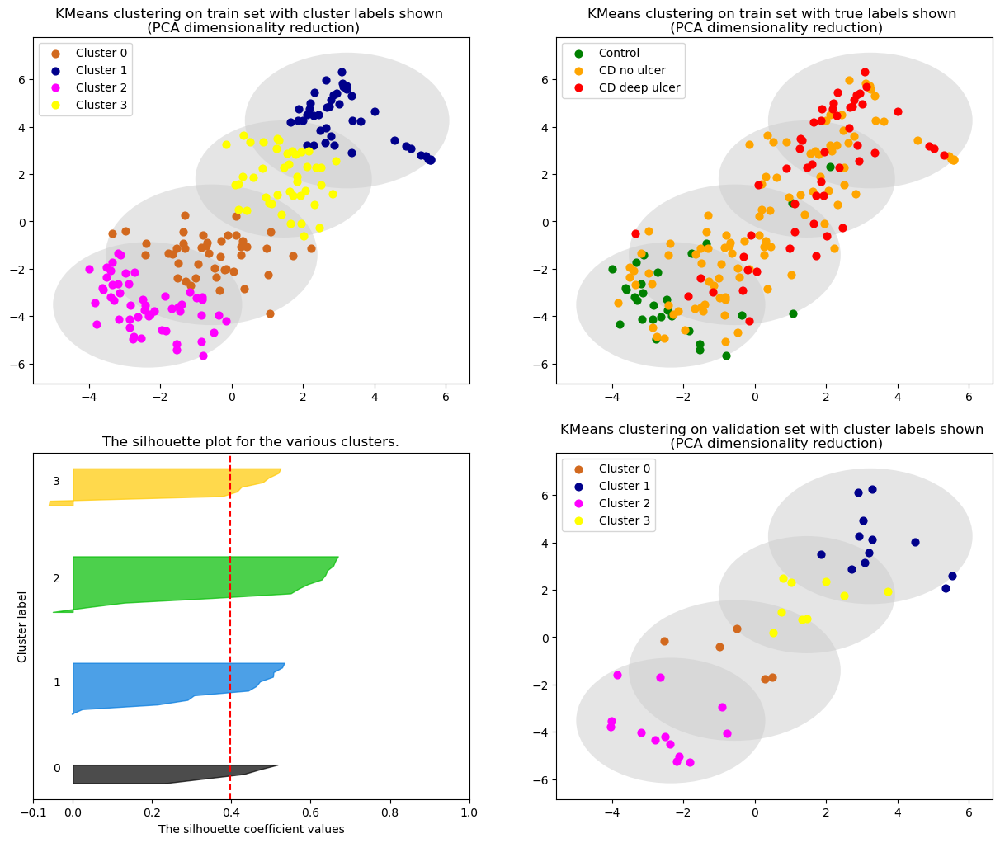

The average silhouette_score is : 0.39614612
Accuracy: 0.15384615384615385
F1 score: 0.19052790346907994


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Perplexity = 100


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


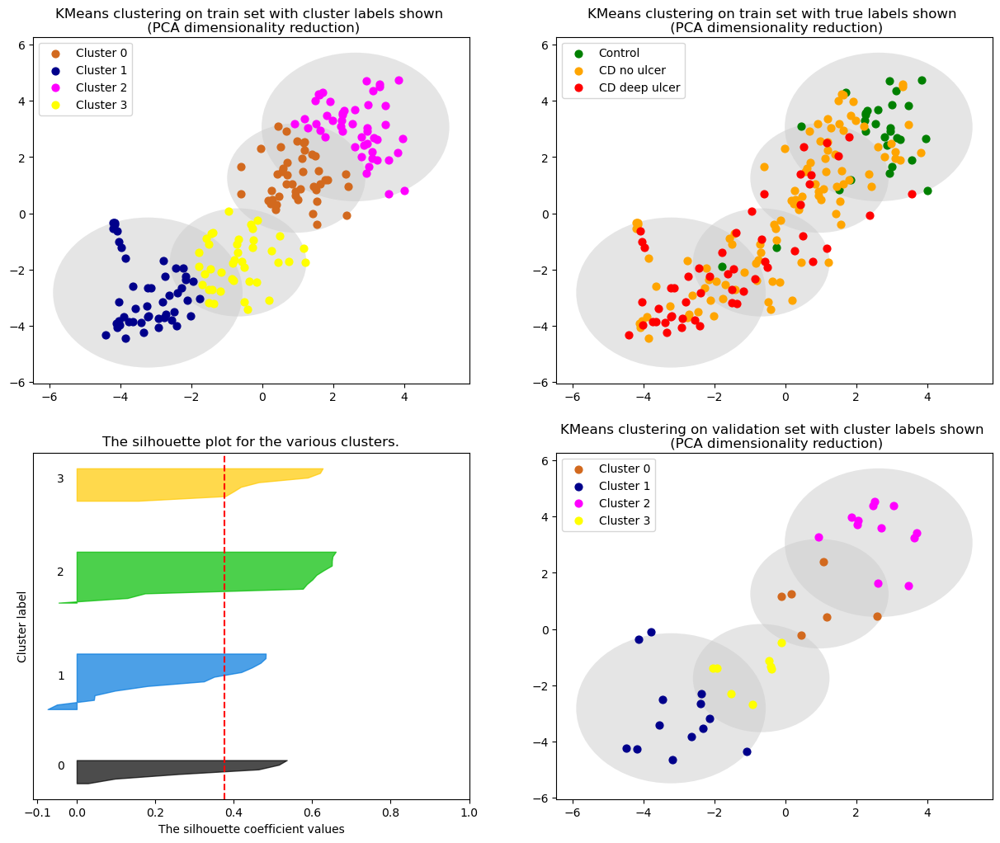

The average silhouette_score is : 0.3754107
Accuracy: 0.1794871794871795
F1 score: 0.219047619047619


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Perplexity = 110


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


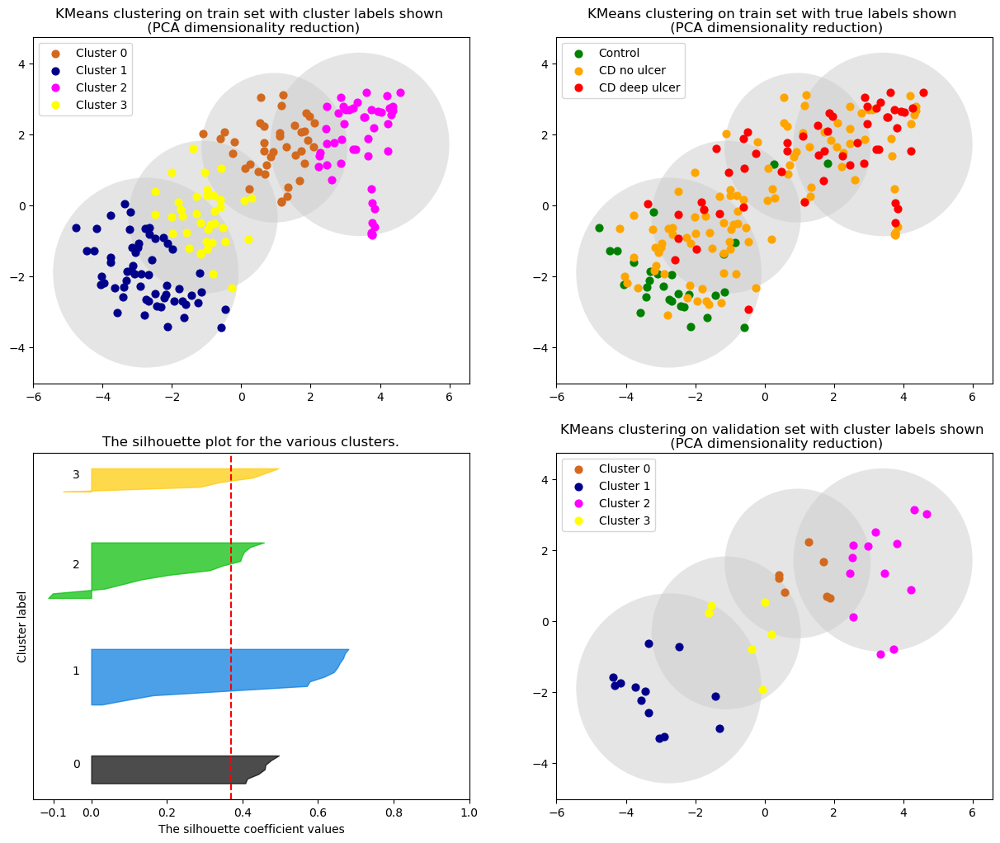

The average silhouette_score is : 0.37063673
Accuracy: 0.358974358974359
F1 score: 0.3979487179487179


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Perplexity = 120


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


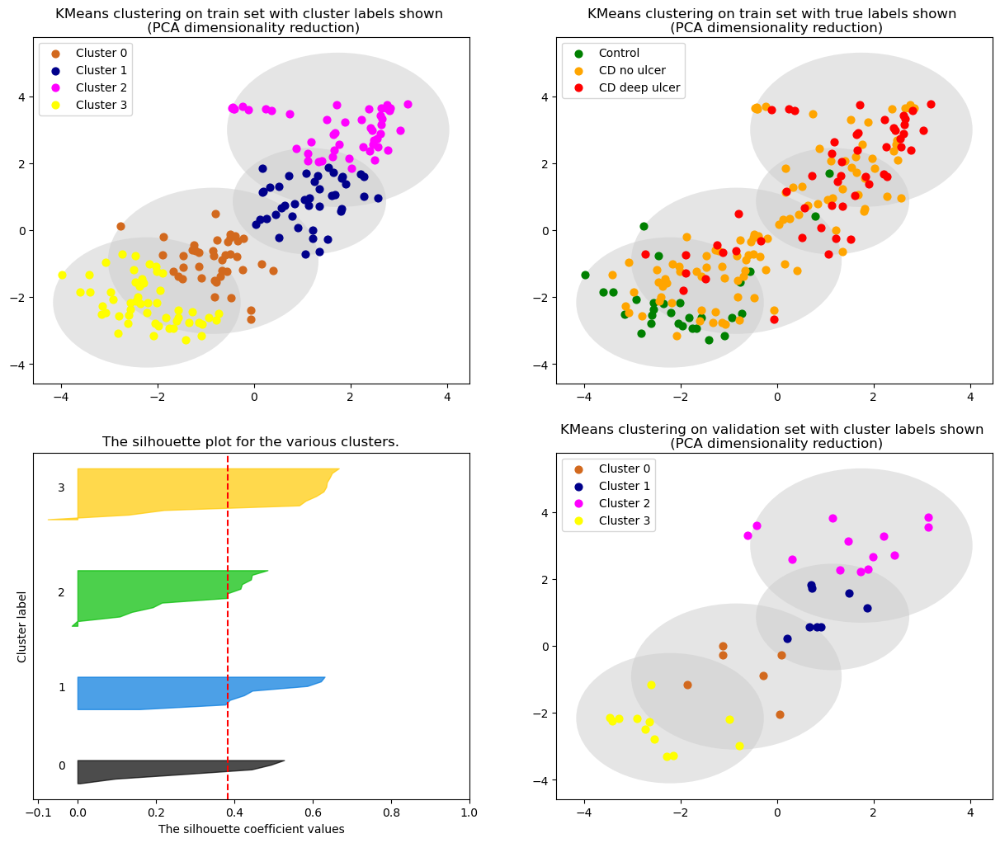

The average silhouette_score is : 0.38418669
Accuracy: 0.3076923076923077
F1 score: 0.3603418803418803


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Perplexity = 130


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


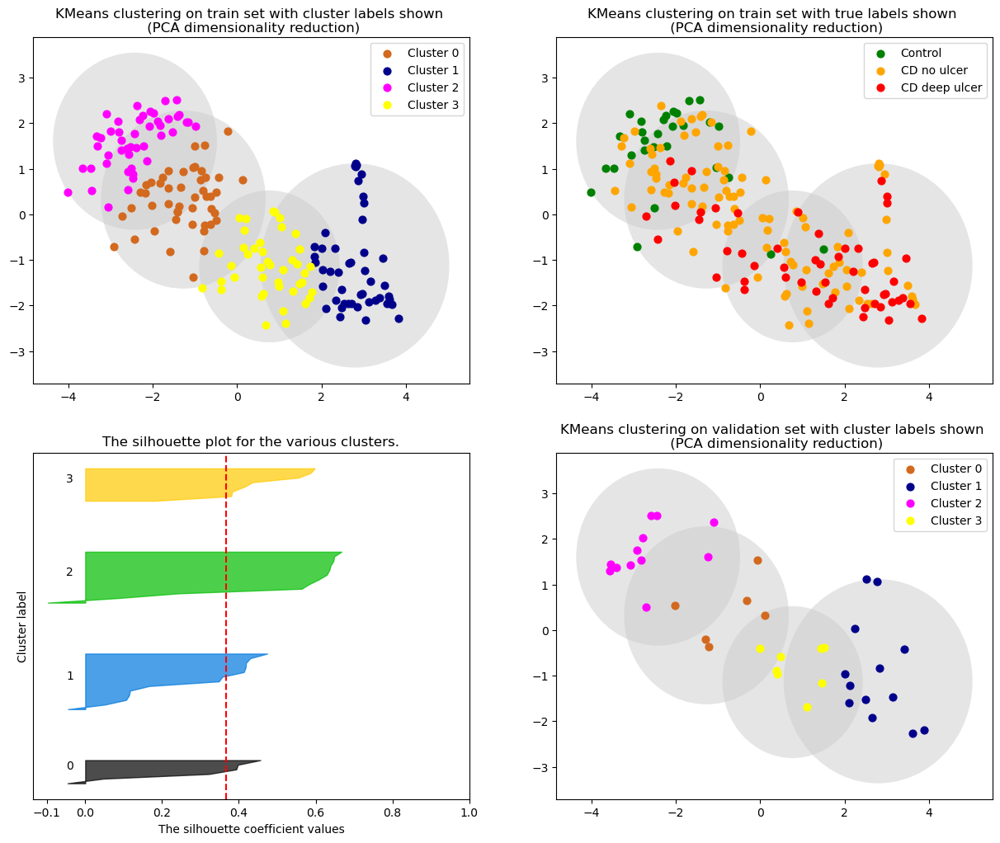

The average silhouette_score is : 0.36736304
Accuracy: 0.1794871794871795
F1 score: 0.219047619047619


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Perplexity = 140


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


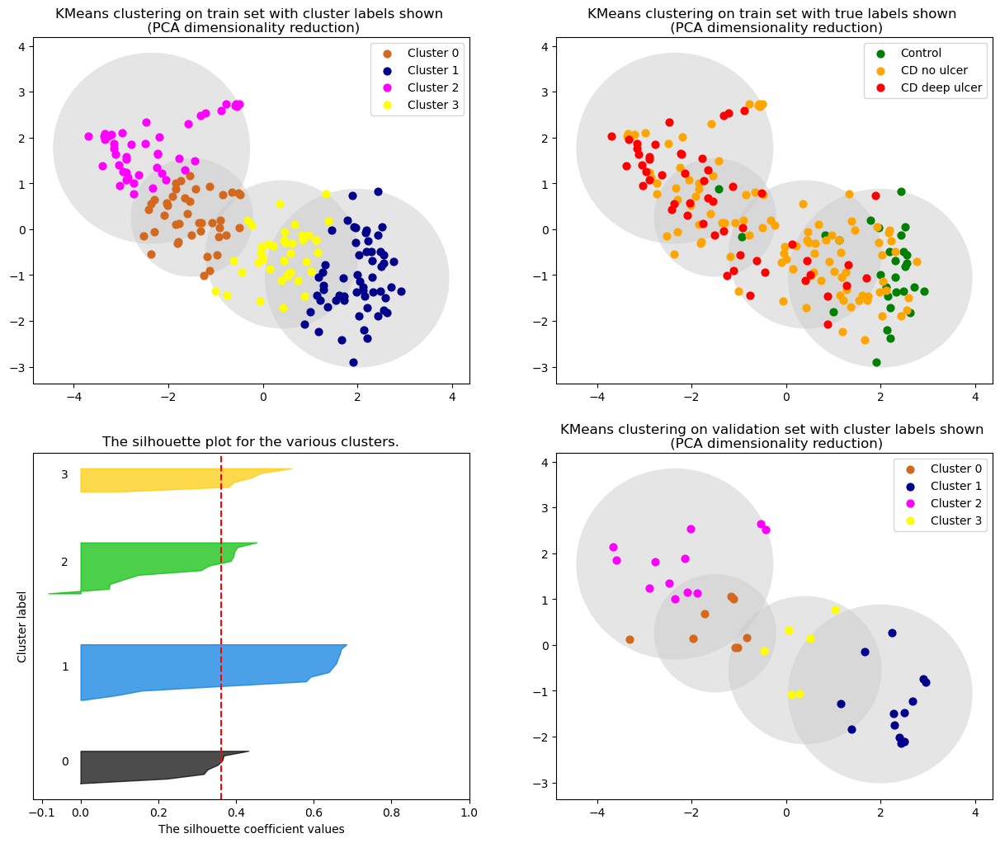

The average silhouette_score is : 0.36211774
Accuracy: 0.358974358974359
F1 score: 0.4051282051282051


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Perplexity = 150


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


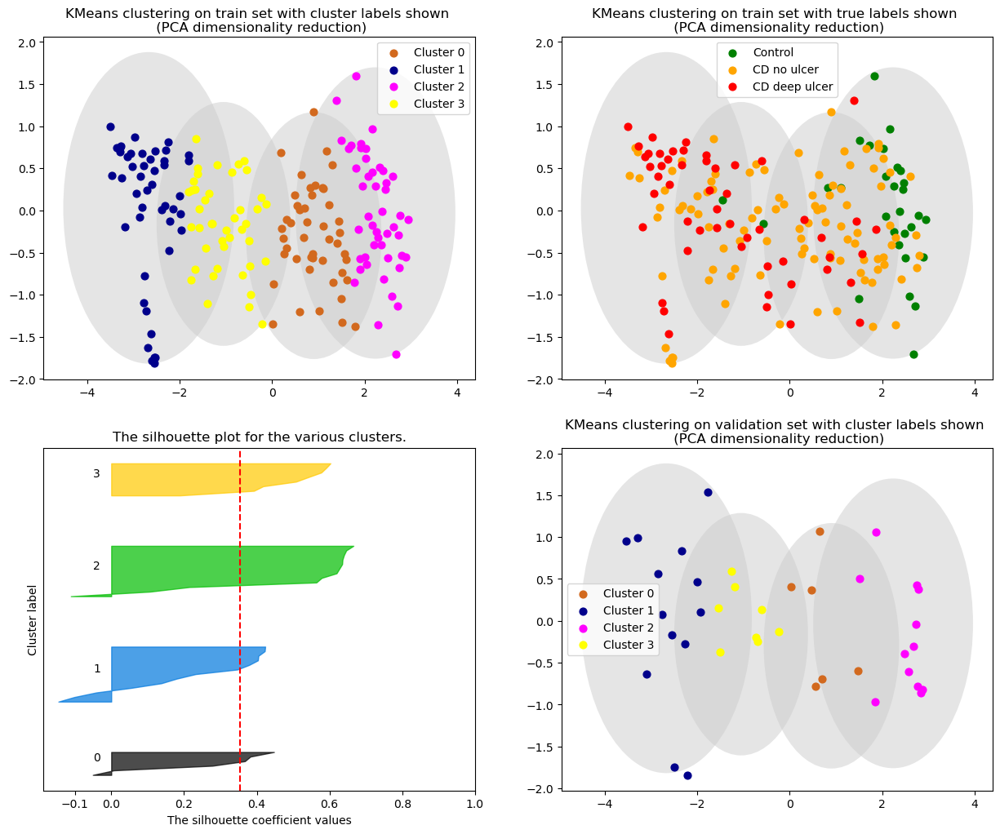

The average silhouette_score is : 0.35293275
Accuracy: 0.1794871794871795
F1 score: 0.219047619047619


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Perplexity = 160


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


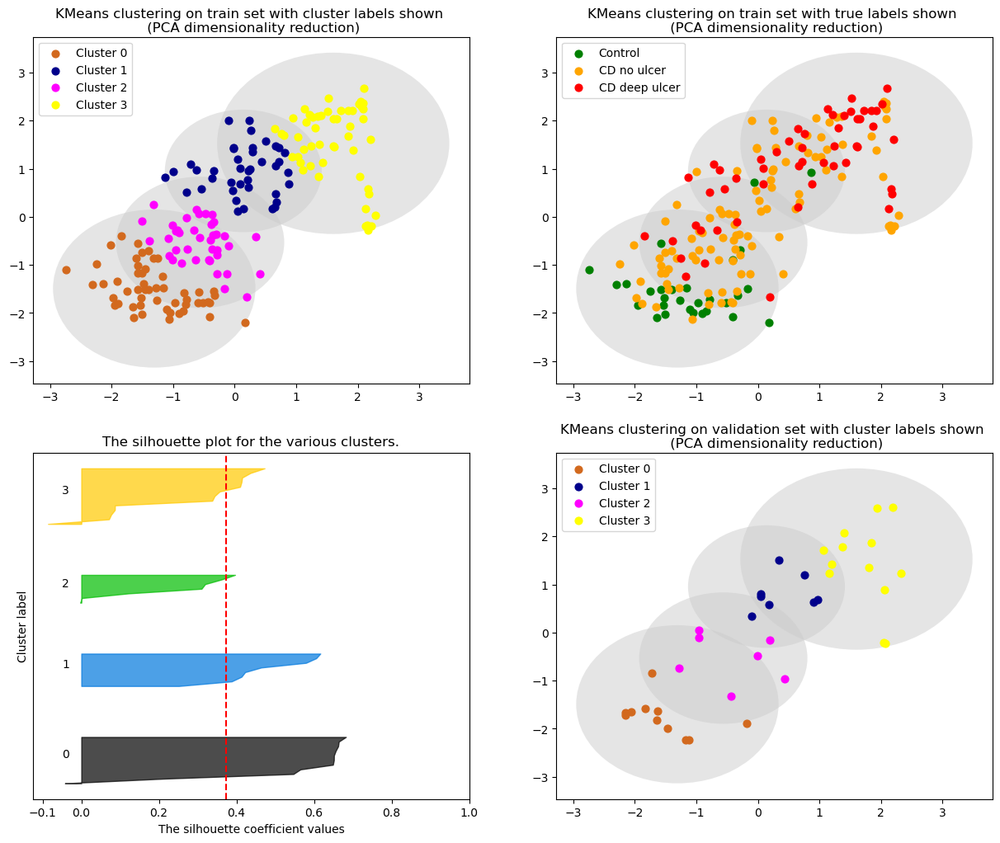

The average silhouette_score is : 0.373378
Accuracy: 0.28205128205128205
F1 score: 0.30055105713000446


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Perplexity = 170


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


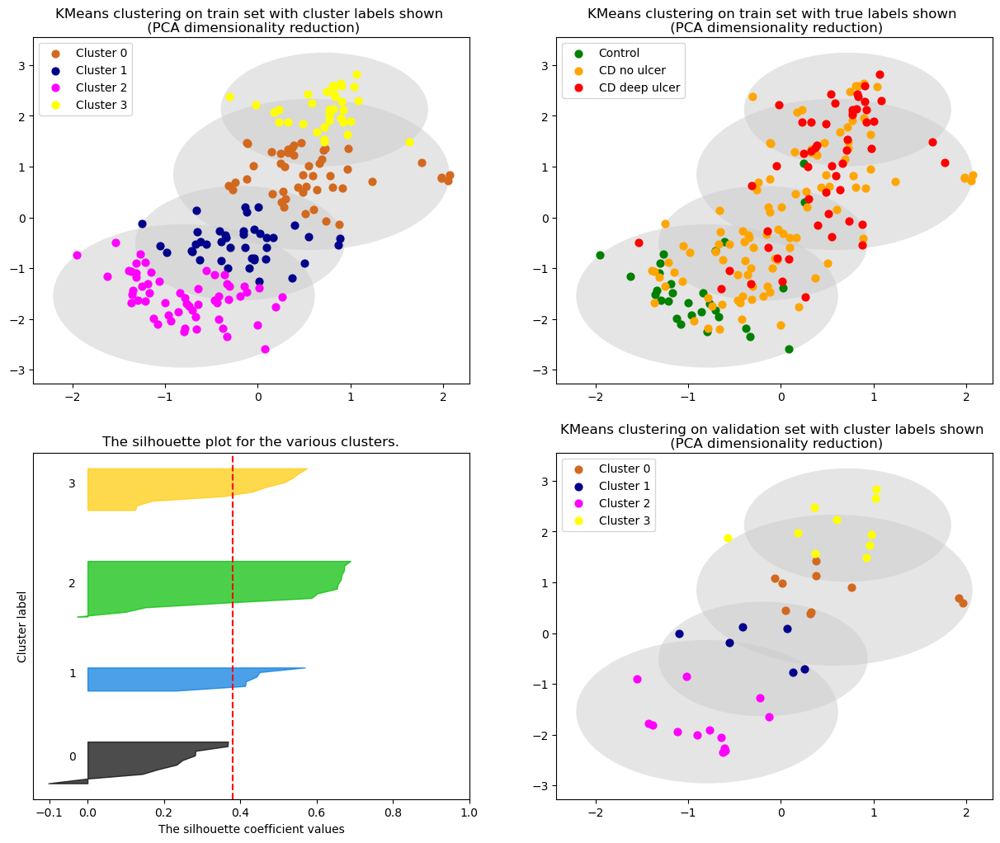

The average silhouette_score is : 0.38047674
Accuracy: 0.15384615384615385
F1 score: 0.22608058608058612


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Perplexity = 180


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


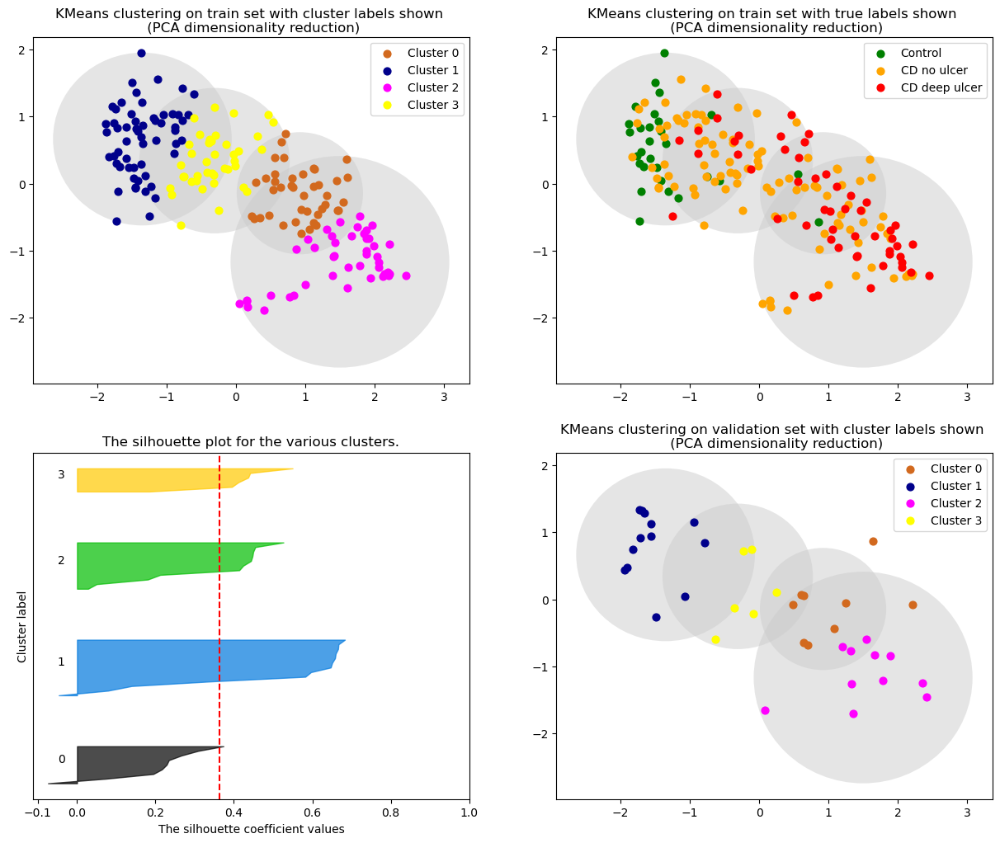

The average silhouette_score is : 0.36393595
Accuracy: 0.358974358974359
F1 score: 0.4129319955406912


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Perplexity = 190


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


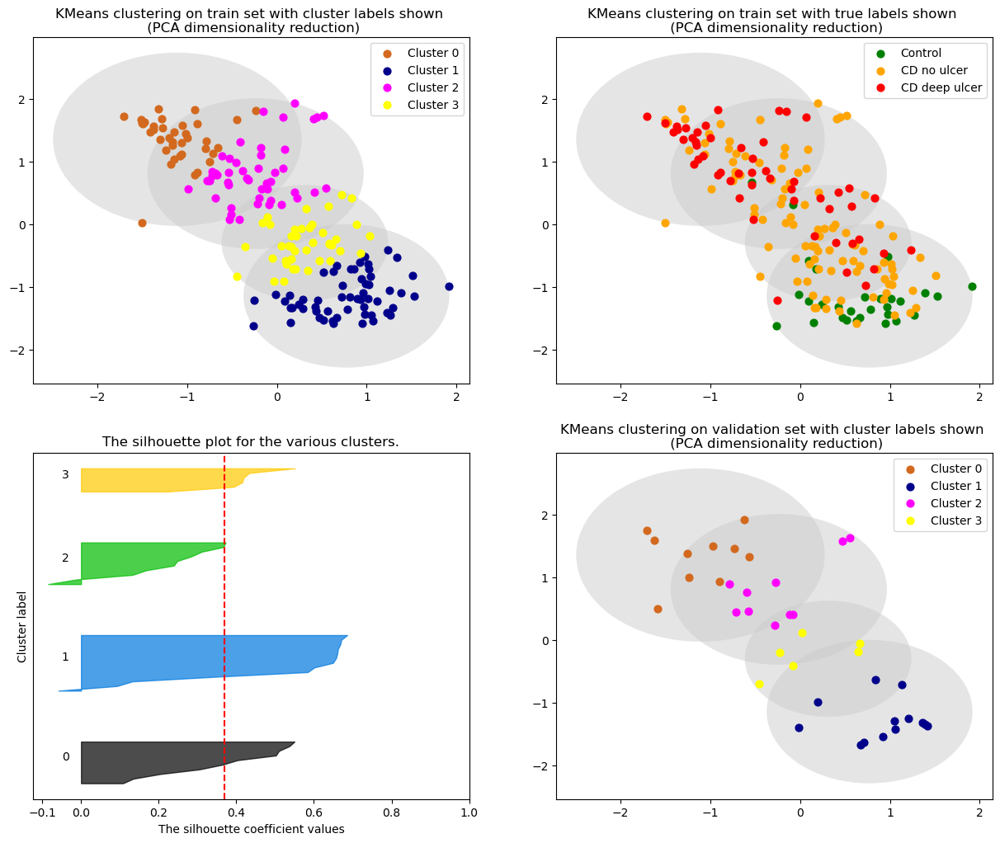

The average silhouette_score is : 0.3699677
Accuracy: 0.3076923076923077
F1 score: 0.36550116550116546


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Perplexity = 200


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


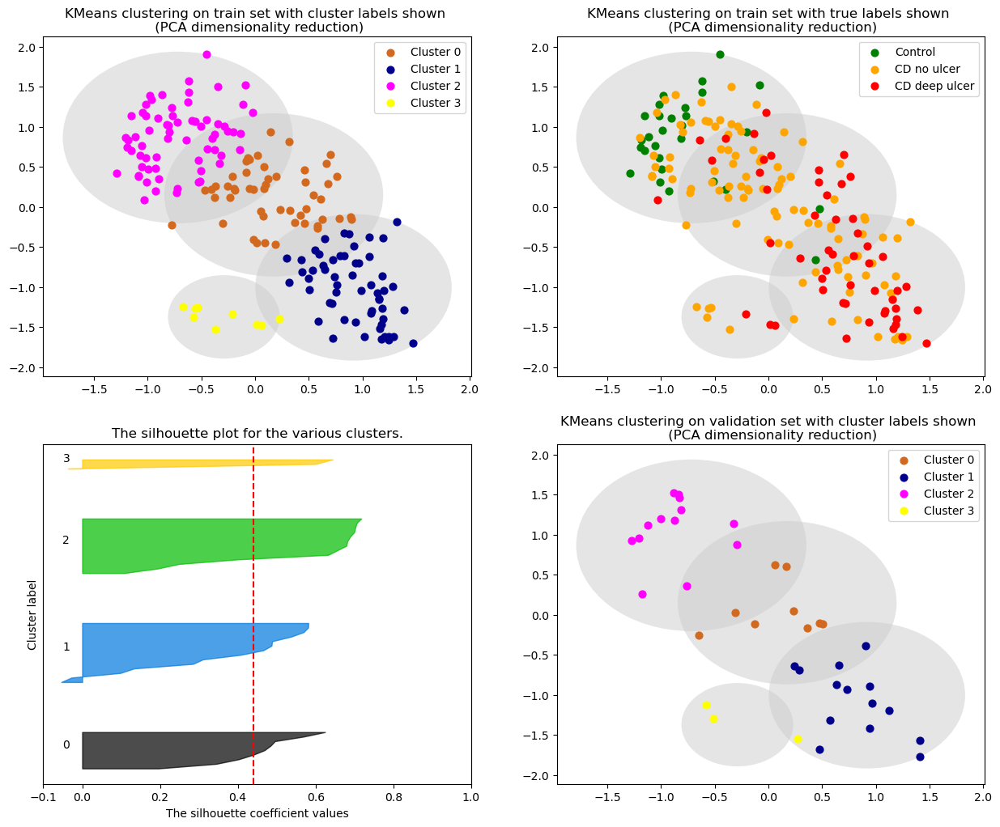

The average silhouette_score is : 0.44110847
Accuracy: 0.20512820512820512
F1 score: 0.24398860398860395


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Perplexity = 210


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


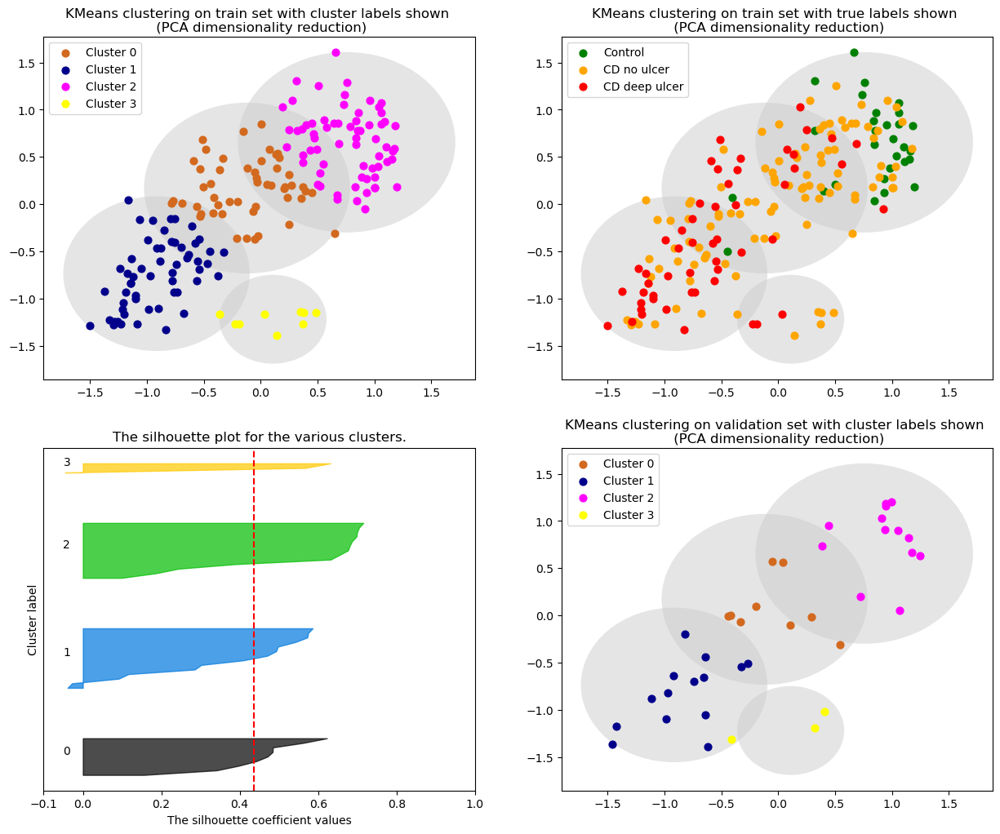

The average silhouette_score is : 0.43709776
Accuracy: 0.20512820512820512
F1 score: 0.24398860398860395


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Perplexity = 220


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


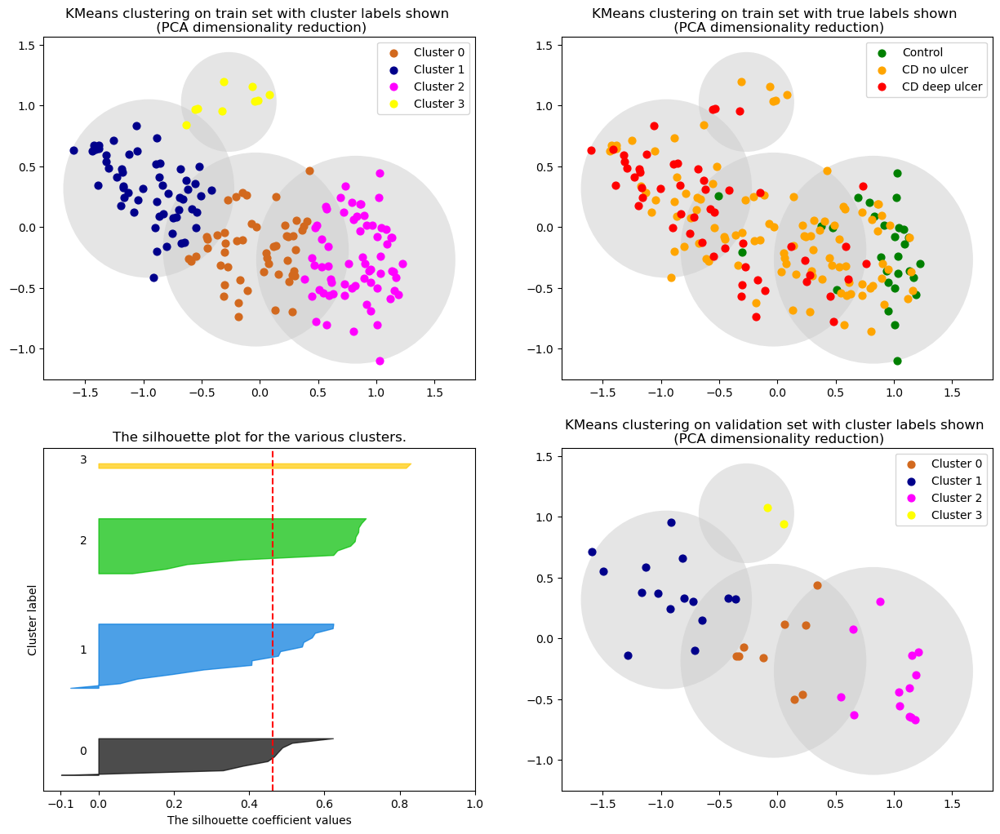

The average silhouette_score is : 0.46273062
Accuracy: 0.23076923076923078
F1 score: 0.26855162855162856


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Perplexity = 230


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


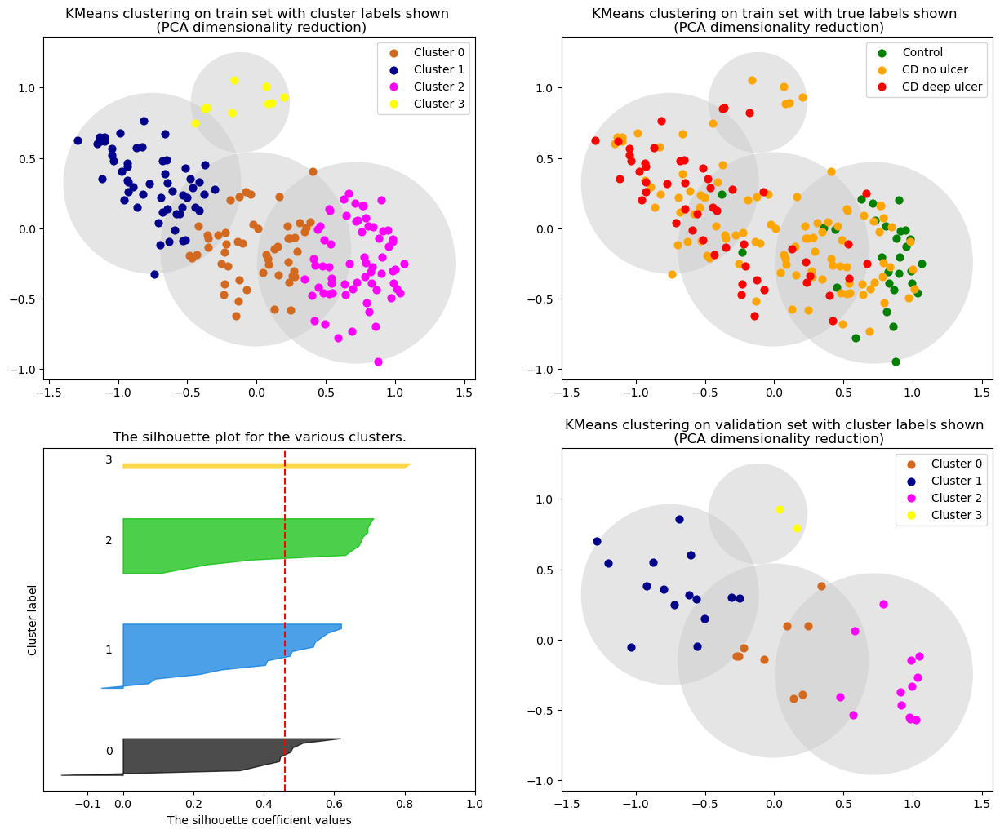

The average silhouette_score is : 0.46058342
Accuracy: 0.23076923076923078
F1 score: 0.26855162855162856


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Perplexity = 240


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


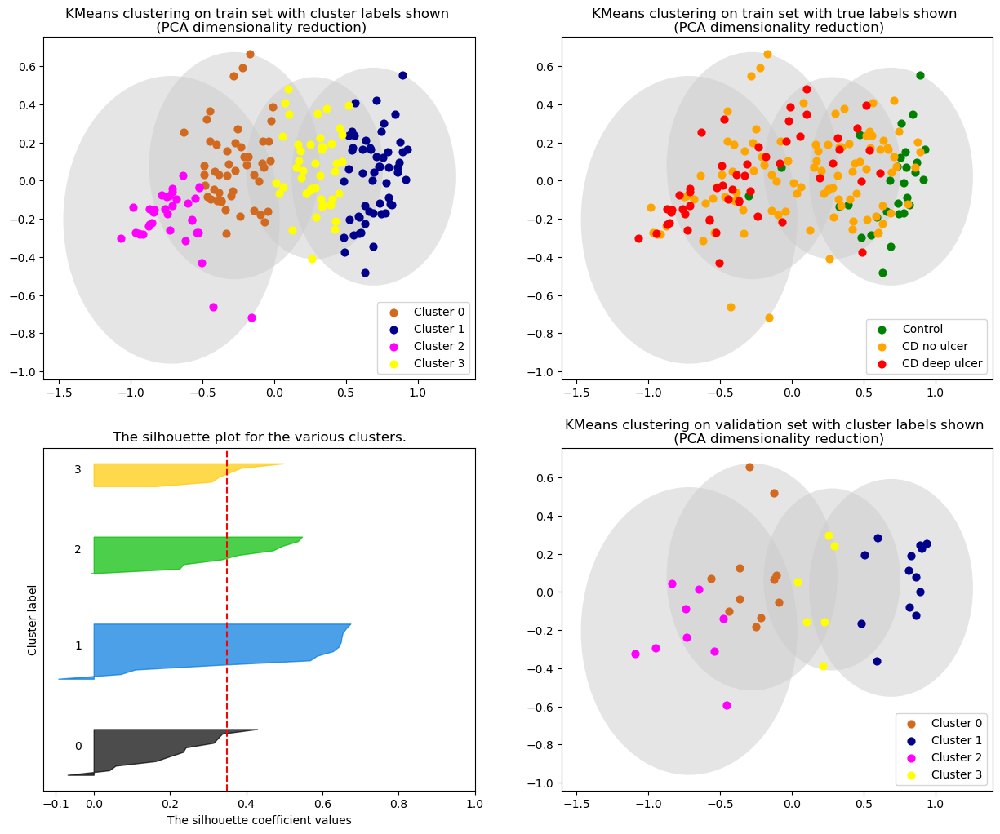

The average silhouette_score is : 0.34984285
Accuracy: 0.28205128205128205
F1 score: 0.3428571428571428


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Perplexity = 250


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


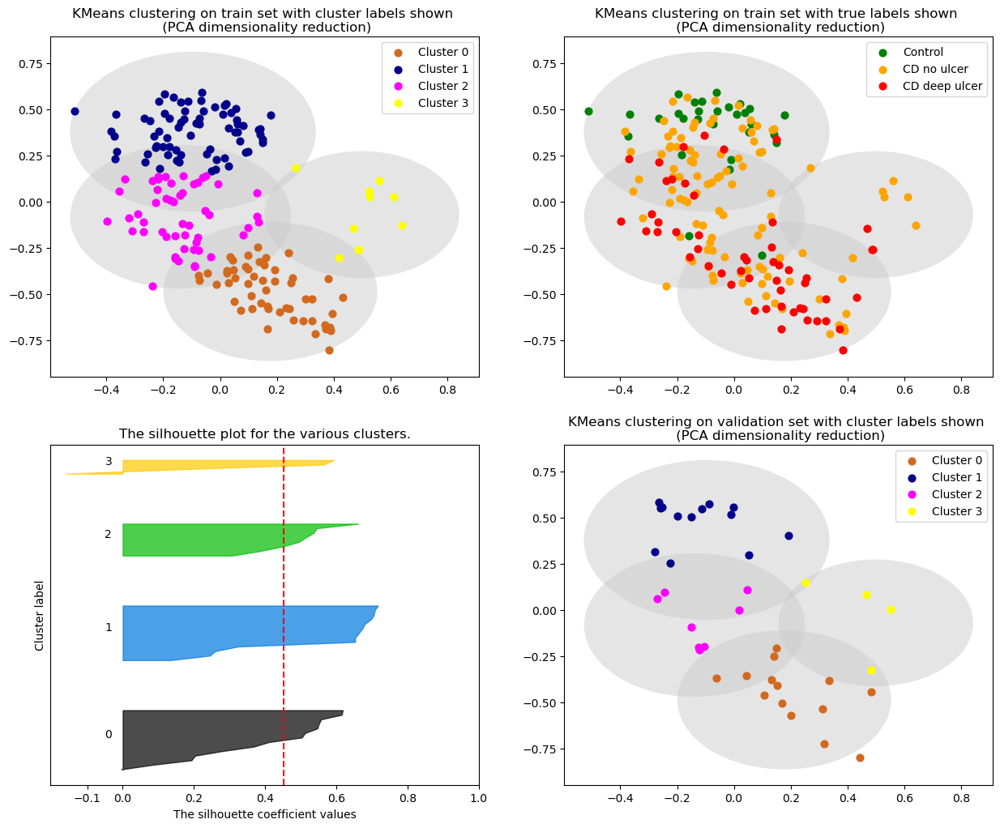

The average silhouette_score is : 0.451797
Accuracy: 0.2564102564102564
F1 score: 0.31794871794871793


In [34]:
# perplexities = [10, 20, 50, 70, 100, 150, 200, 250]
perplexities = np.arange(0, 251, 10)[1:]
sil_scores = []
acc_scores = []
f1_scores = []

for perplexity in perplexities:
    kmeans_pca, X_train_pca, X_val_pca, X_test_pca, k_labels_train_pca, k_labels_val_pca, k_labels_test_pca, centers_pca, radii_pca = train_kmeans(full_pca_dataset, perplexity)
    print("Perplexity =",perplexity)
#     print(k_labels_train_pca)
    sil, acc, f1 = plot_kmeans(X_train_pca, X_val_pca, train_disease_labels, val_disease_labels, k_labels_train_pca, k_labels_val_pca, centers_pca, radii_pca, "PCA", test_set=False, plot_sil=True)
    sil_scores.append(sil)
    acc_scores.append(acc)
    f1_scores.append(f1)

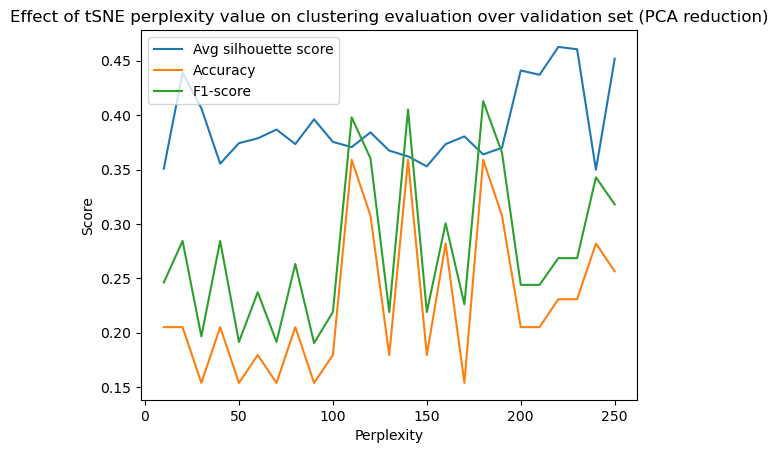

In [35]:
plot_val_scores(sil_scores, acc_scores, f1_scores, "PCA")

### Testing

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Perplexity = 120


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


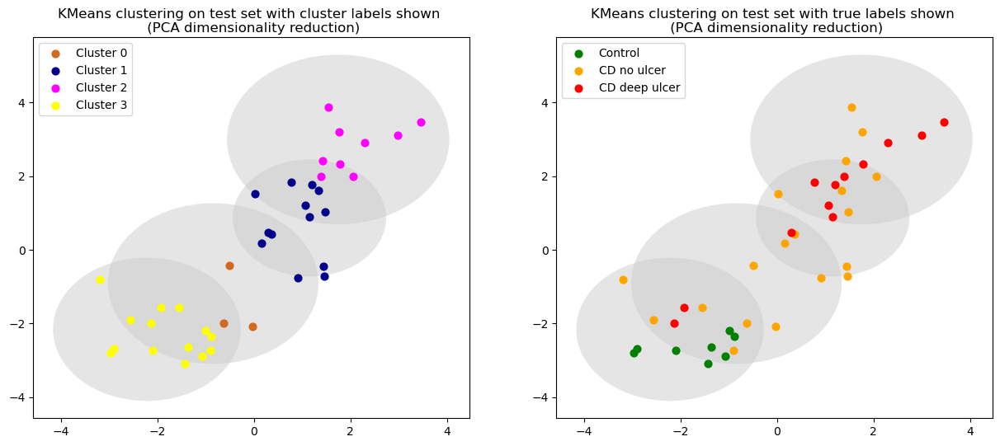

In [36]:
# plot with chosen tsne perplexity
perplexity = 120
kmeans_pca, X_train_pca, X_val_pca, X_test_pca, k_labels_train_pca, k_labels_val_pca, k_labels_test_pca, centers_pca, radii_pca = train_kmeans(full_pca_dataset, perplexity)
print("Perplexity =",perplexity)
plot_kmeans(X_test_pca, None, test_disease_labels, None, k_labels_test_pca, None, centers_pca, radii_pca, "PCA", test_set=True)
        
# silhouette_avg, sample_silhouette_values = compute_silh_scores(X_val_pca, k_labels_val_pca)
# acc = accuracy_score(val_disease_labels, k_labels_val_pca)
# f1 = f1_score(val_disease_labels, k_labels_val_pca, average='weighted')
# print("The average silhouette_score is :",silhouette_avg)
# print("Accuracy:",acc)
# print("F1 score:",f1)


### Fit KMeans (Autoencoder & tSNE dimensionality reduction)

### Training

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Perplexity = 10


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


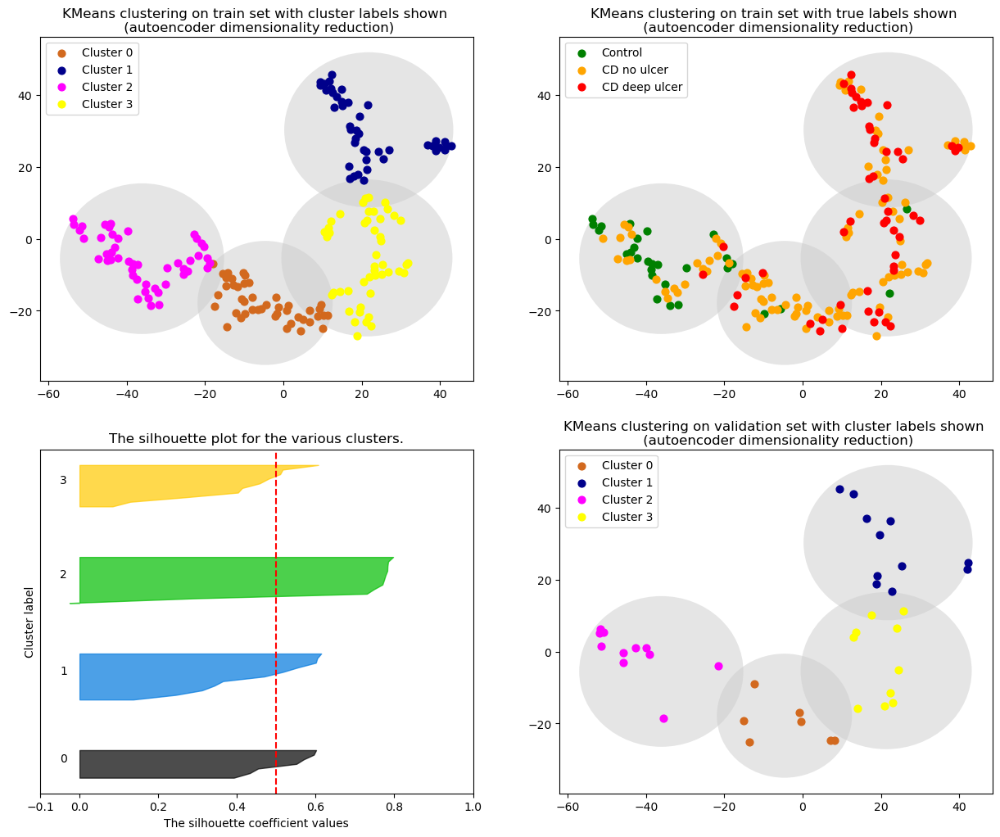

The average silhouette_score is : 0.498356
Accuracy: 0.15384615384615385
F1 score: 0.19769602378298032


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Perplexity = 20


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


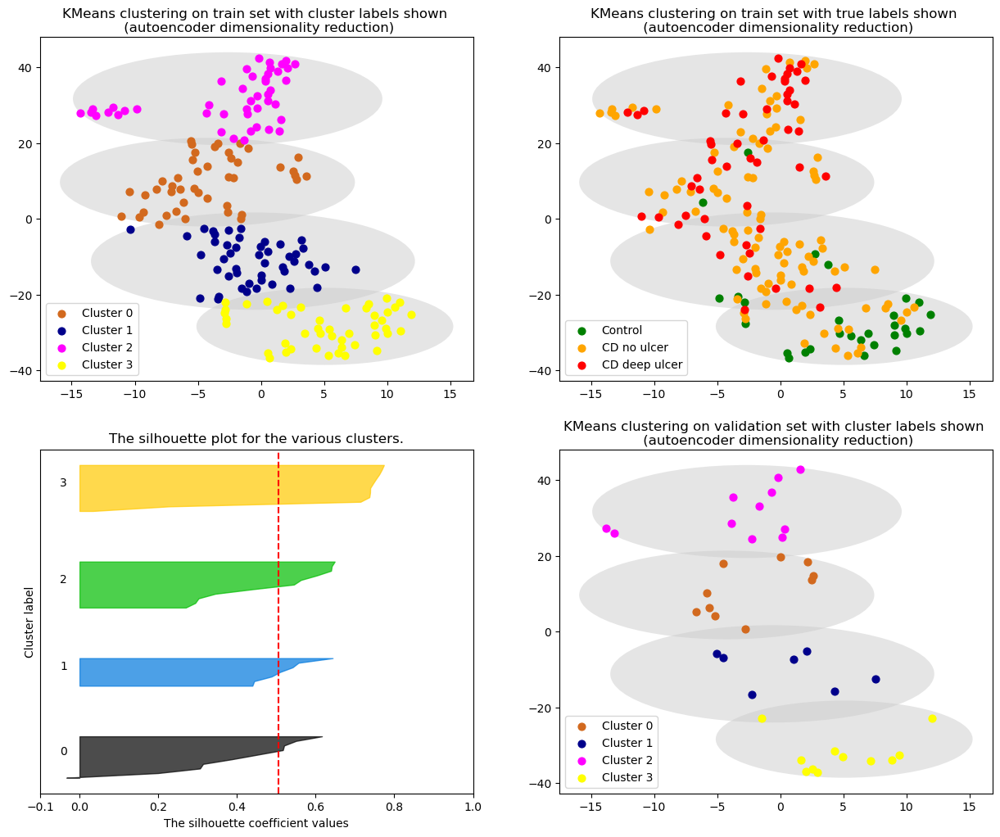

The average silhouette_score is : 0.50605017
Accuracy: 0.3076923076923077
F1 score: 0.39395686771998617


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Perplexity = 30


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


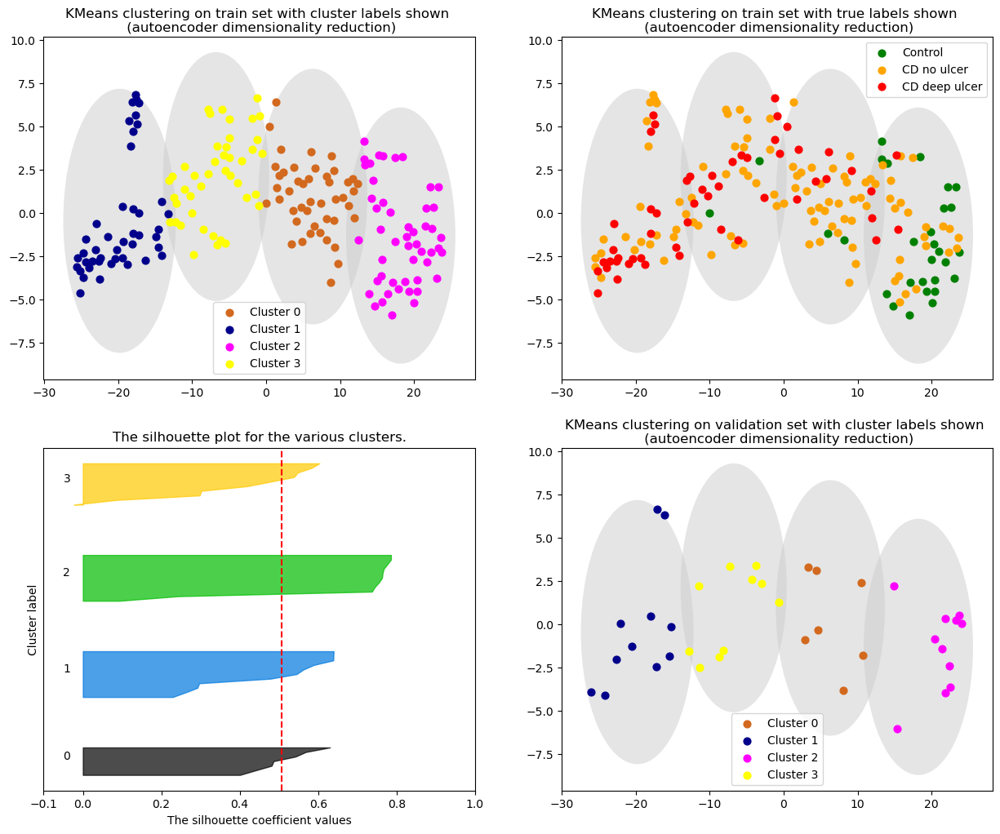

The average silhouette_score is : 0.50682706
Accuracy: 0.15384615384615385
F1 score: 0.19769602378298032


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Perplexity = 40


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


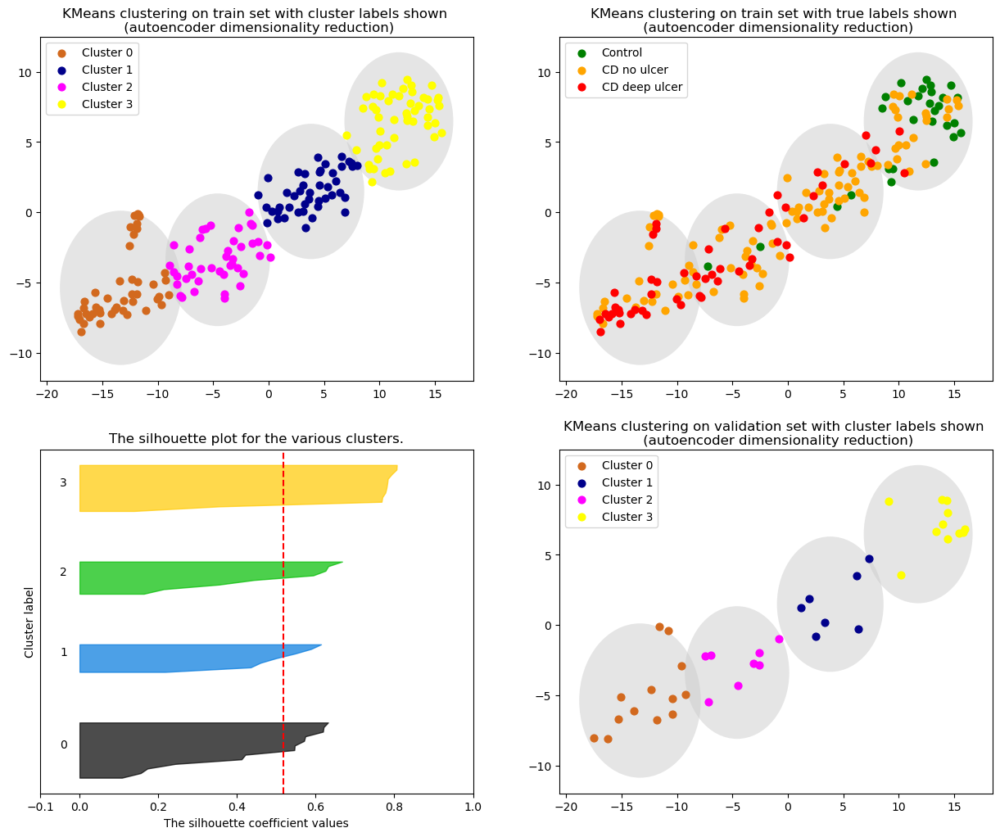

The average silhouette_score is : 0.5188558
Accuracy: 0.23076923076923078
F1 score: 0.3257294429708223


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Perplexity = 50


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


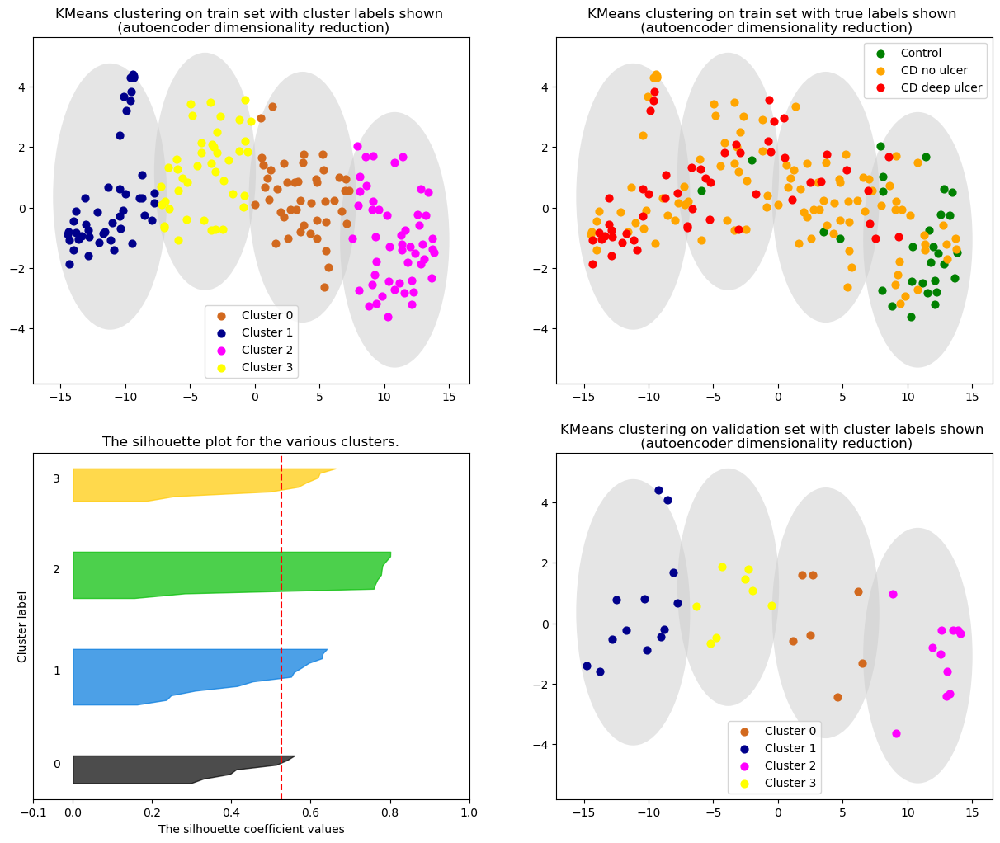

The average silhouette_score is : 0.5260221
Accuracy: 0.1794871794871795
F1 score: 0.22016244624940276


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Perplexity = 60


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


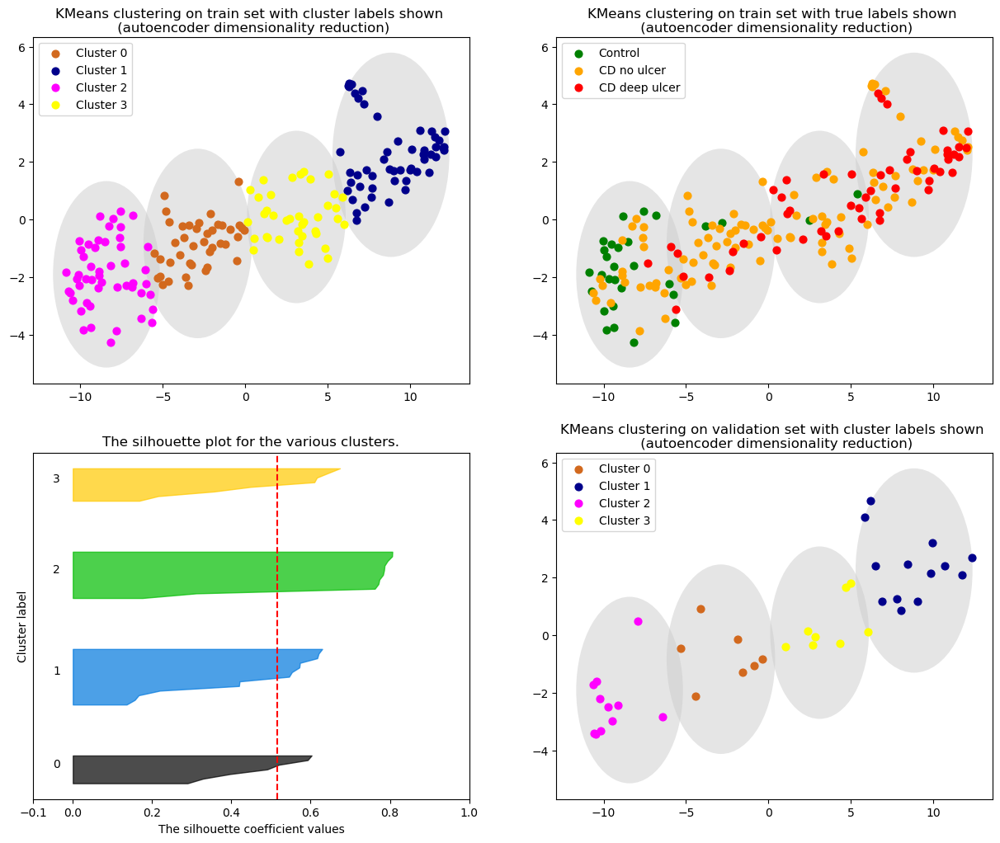

The average silhouette_score is : 0.51624995
Accuracy: 0.1794871794871795
F1 score: 0.22016244624940276


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Perplexity = 70


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


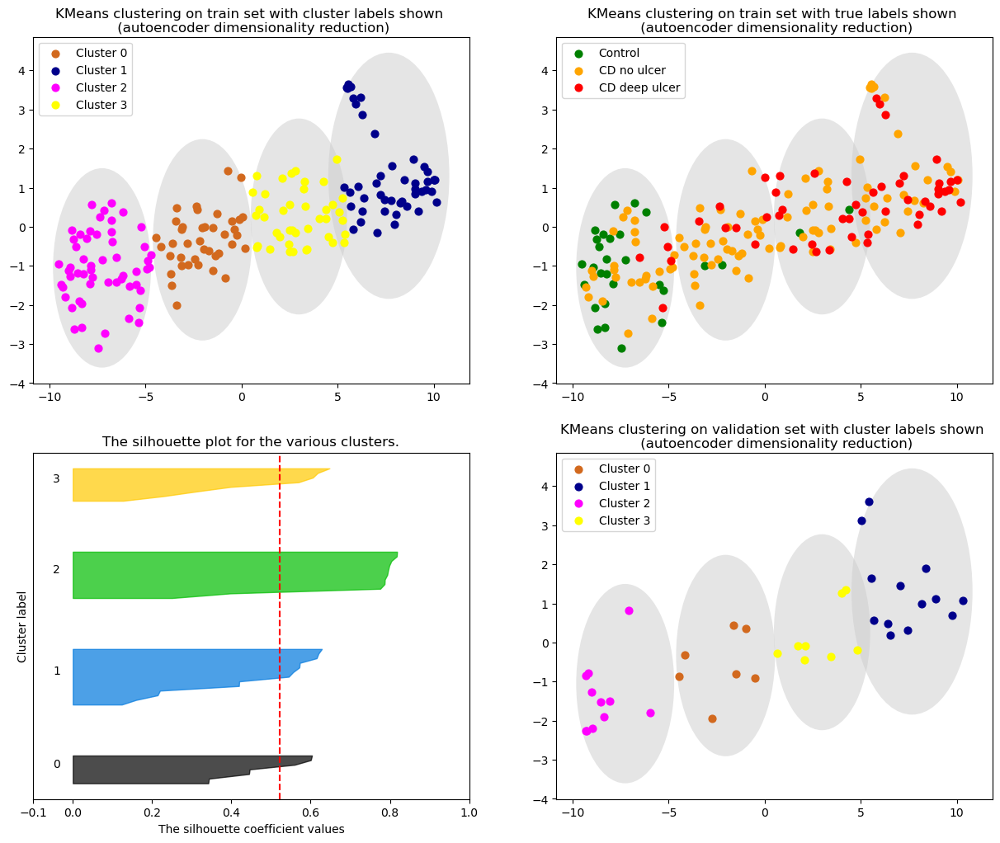

The average silhouette_score is : 0.5214032
Accuracy: 0.1794871794871795
F1 score: 0.22016244624940276


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Perplexity = 80


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


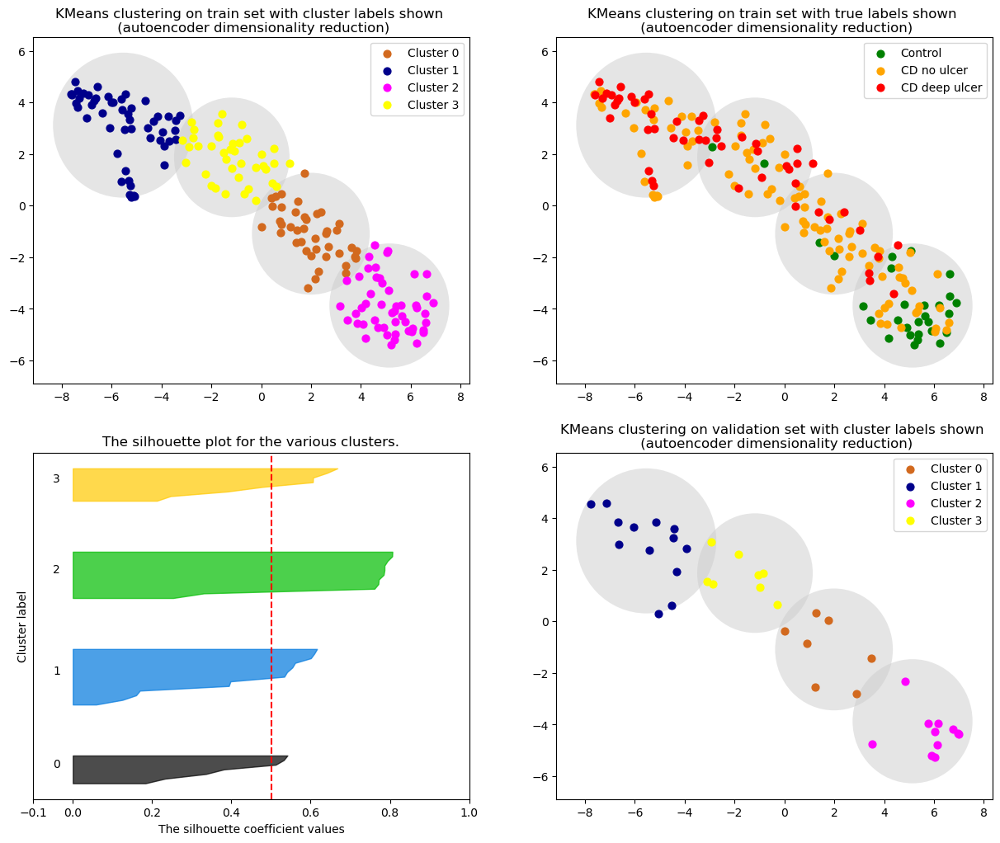

The average silhouette_score is : 0.5009821
Accuracy: 0.1794871794871795
F1 score: 0.22016244624940276


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Perplexity = 90


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


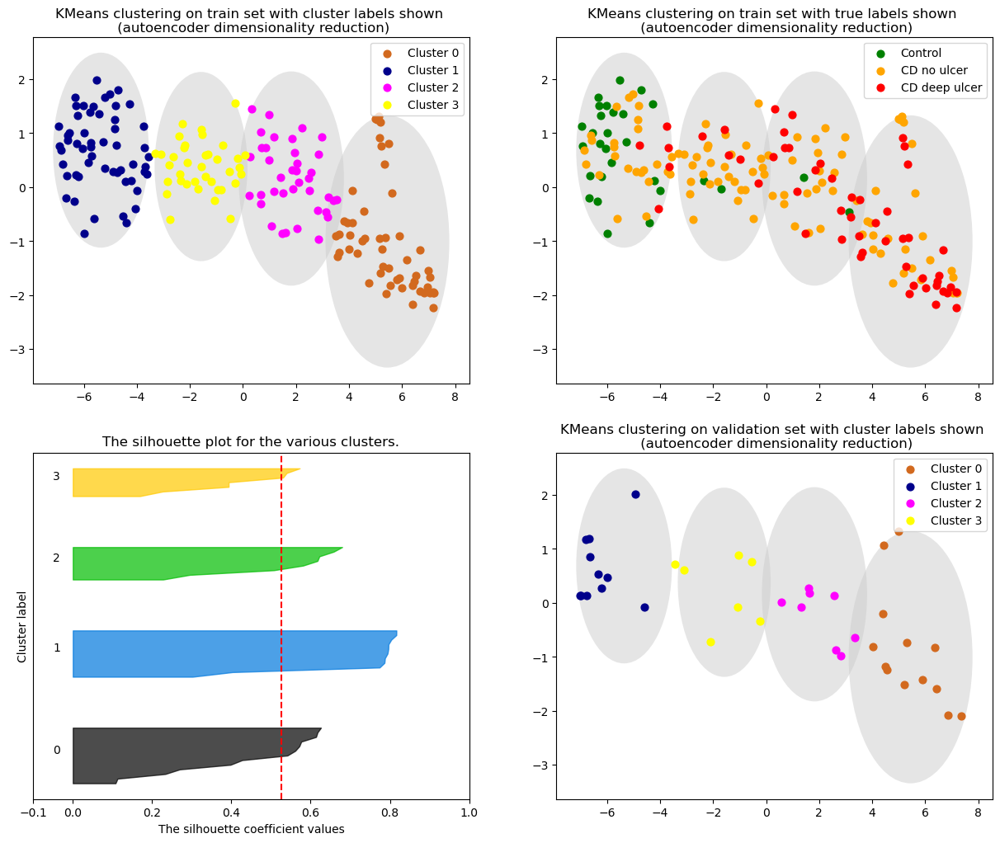

The average silhouette_score is : 0.5267319
Accuracy: 0.20512820512820512
F1 score: 0.2632478632478632


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Perplexity = 100


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


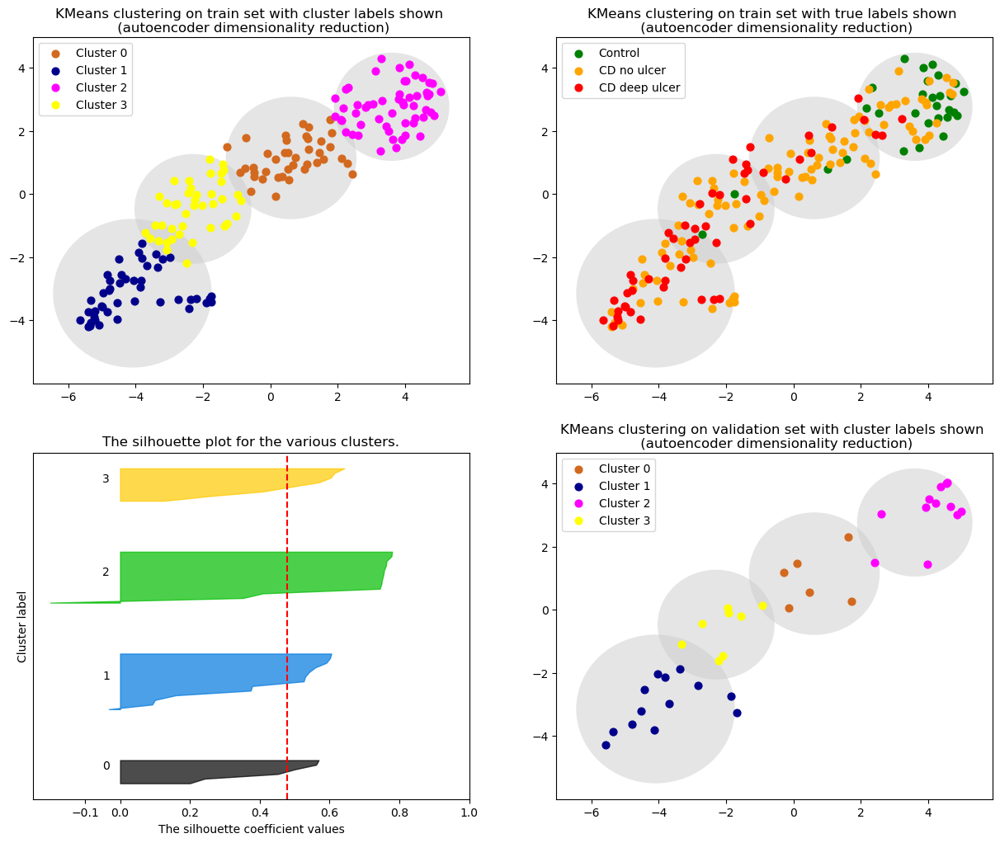

The average silhouette_score is : 0.47845057
Accuracy: 0.1794871794871795
F1 score: 0.219047619047619


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Perplexity = 110


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


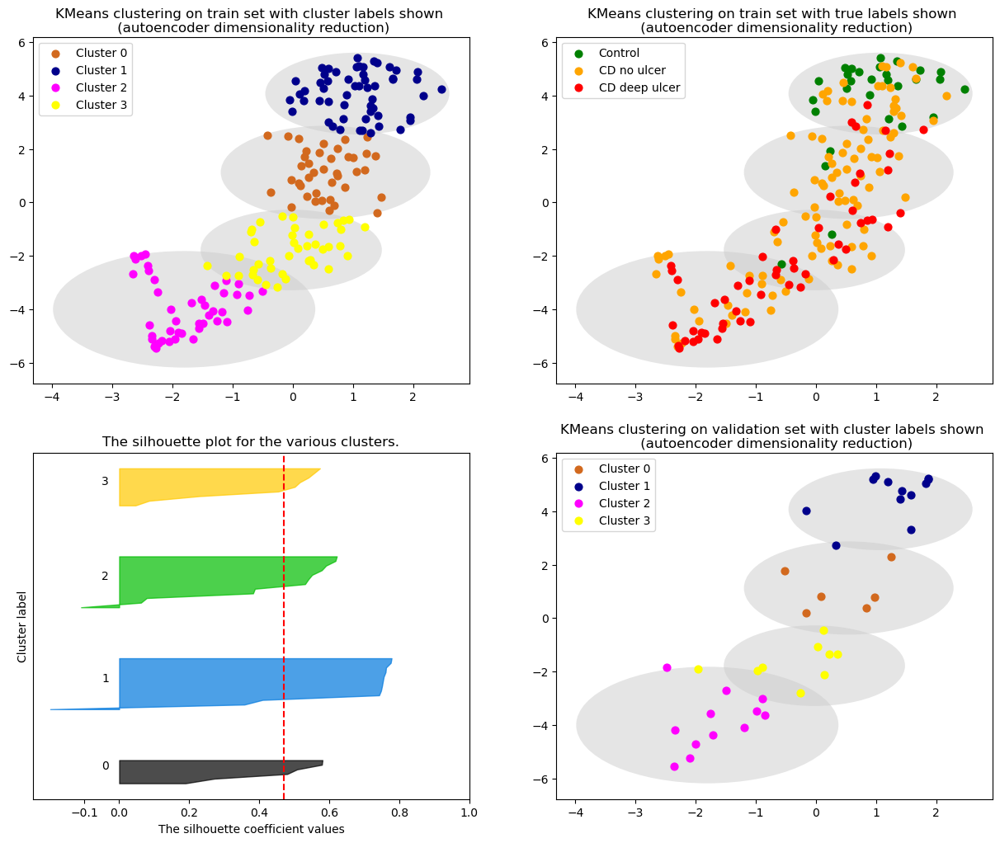

The average silhouette_score is : 0.47044328
Accuracy: 0.3333333333333333
F1 score: 0.37858220211161386


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Perplexity = 120


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


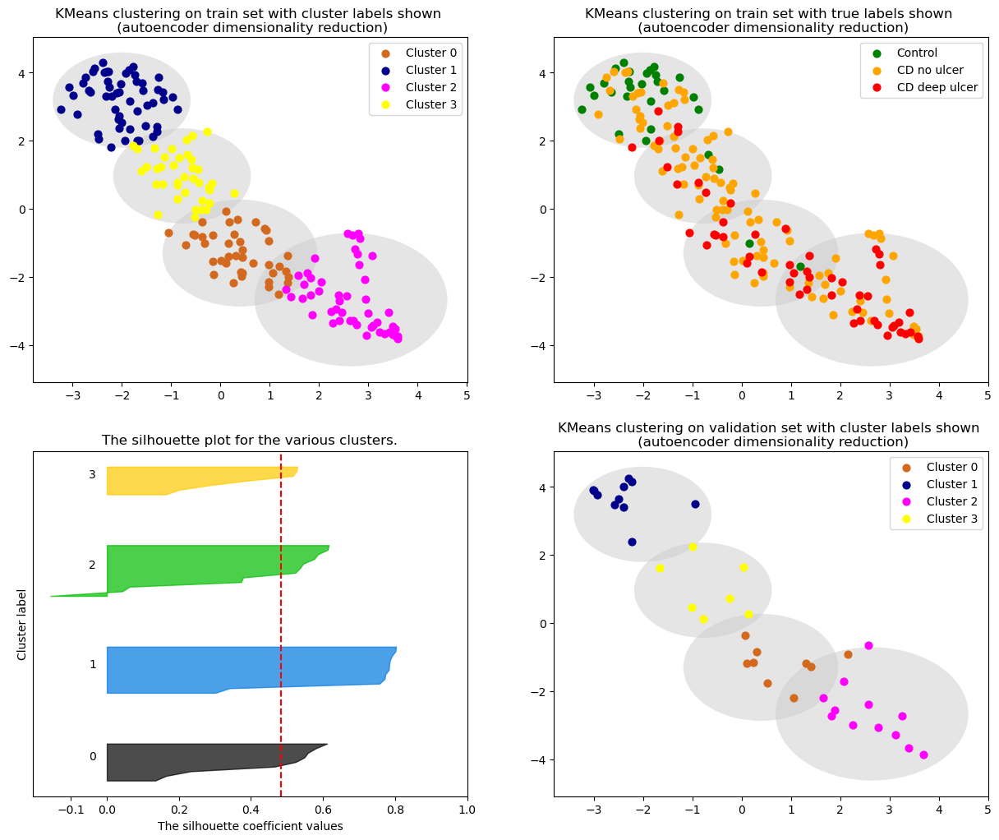

The average silhouette_score is : 0.48239174
Accuracy: 0.3076923076923077
F1 score: 0.35042735042735046


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Perplexity = 130


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


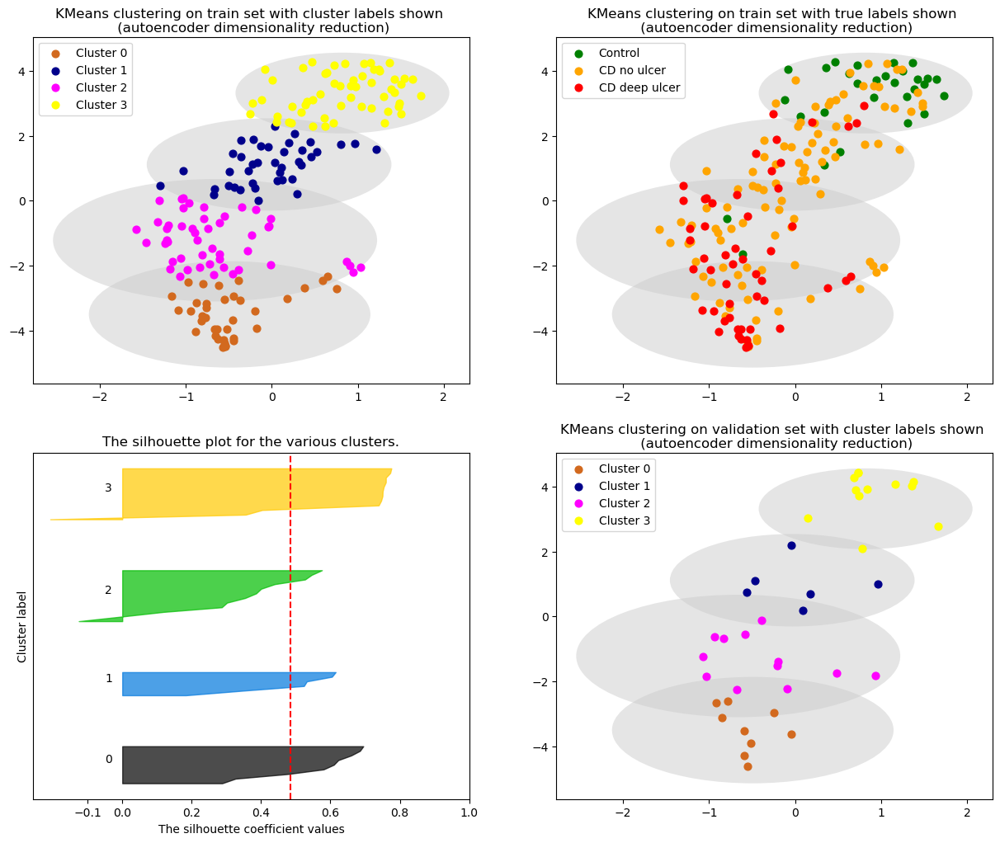

The average silhouette_score is : 0.48508787
Accuracy: 0.2564102564102564
F1 score: 0.32967032967032966


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Perplexity = 140


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


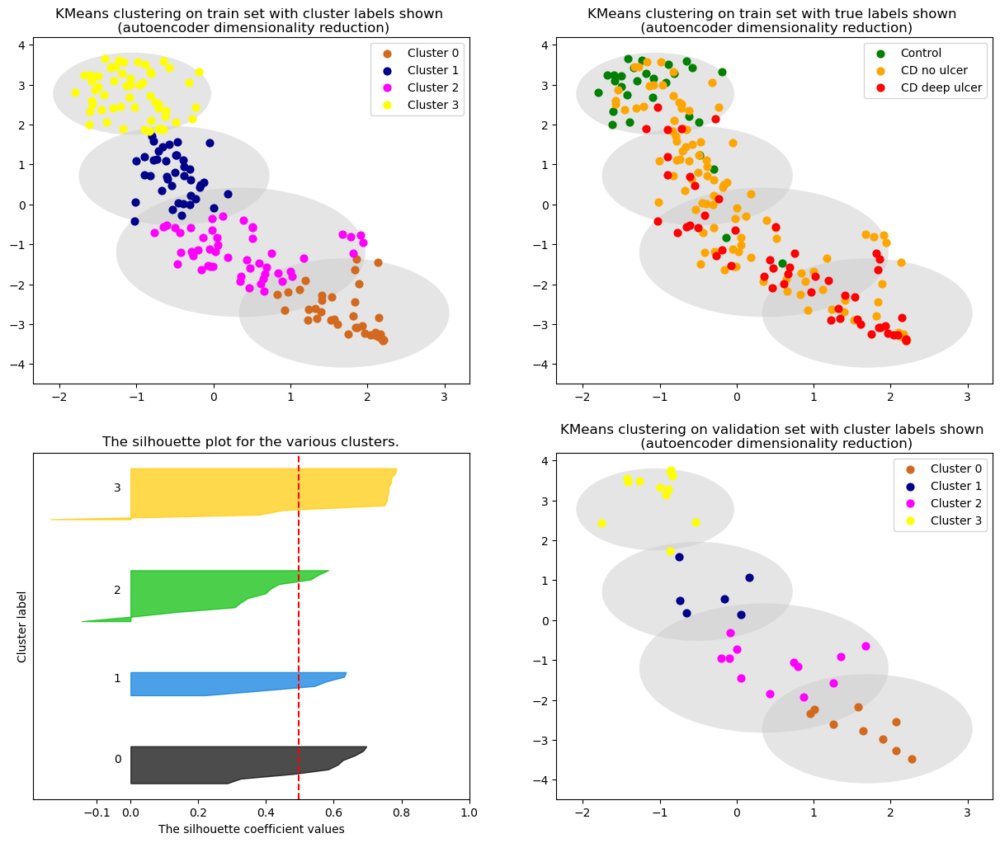

The average silhouette_score is : 0.4956894
Accuracy: 0.2564102564102564
F1 score: 0.32967032967032966


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Perplexity = 150


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


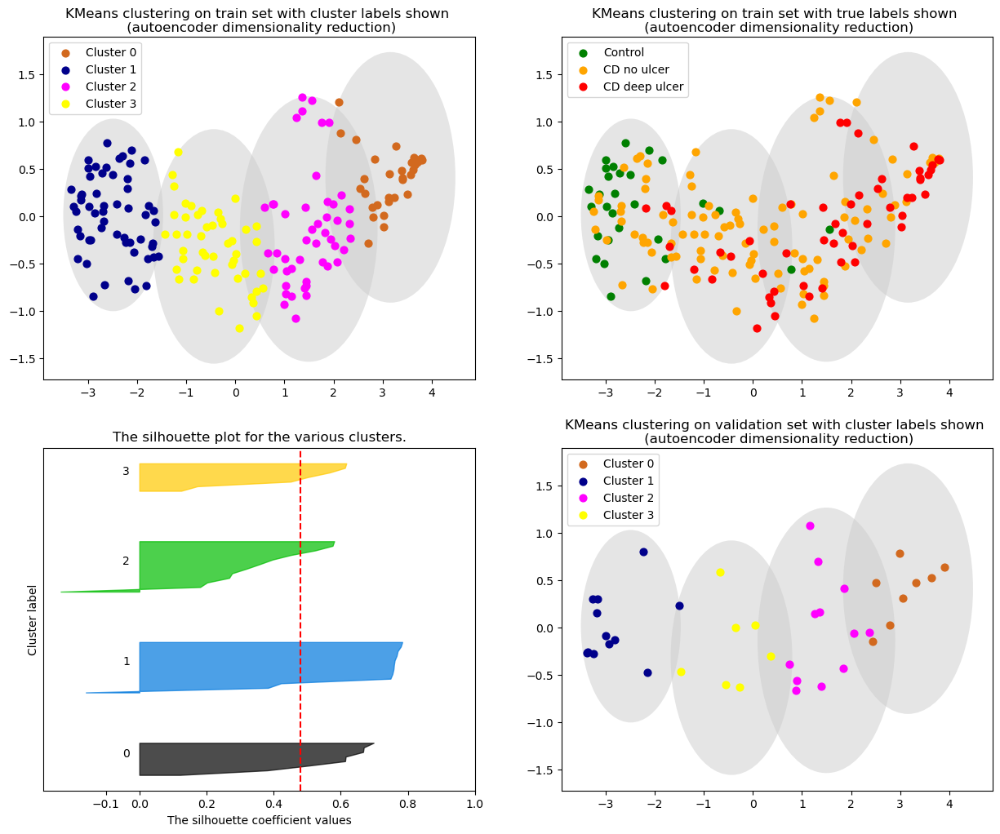

The average silhouette_score is : 0.48029715
Accuracy: 0.3076923076923077
F1 score: 0.3529411764705882


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Perplexity = 160


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


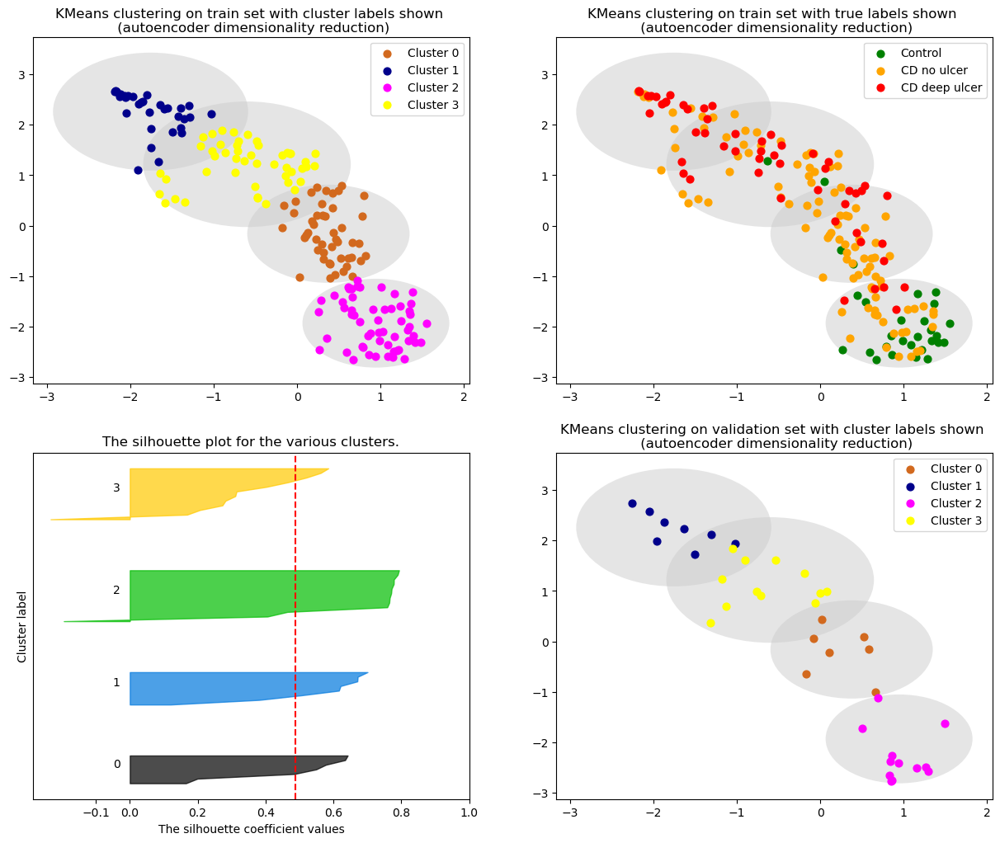

The average silhouette_score is : 0.4882435
Accuracy: 0.1282051282051282
F1 score: 0.17606837606837605


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Perplexity = 170


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


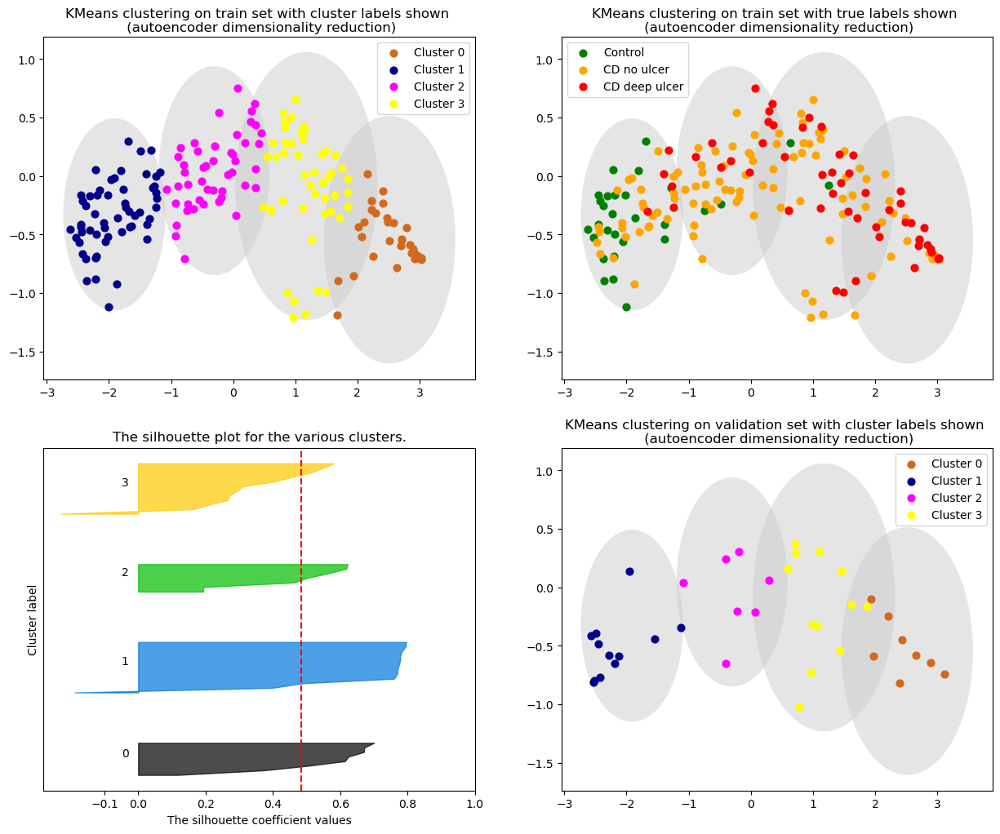

The average silhouette_score is : 0.48511377
Accuracy: 0.1794871794871795
F1 score: 0.2314836865920457


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Perplexity = 180


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


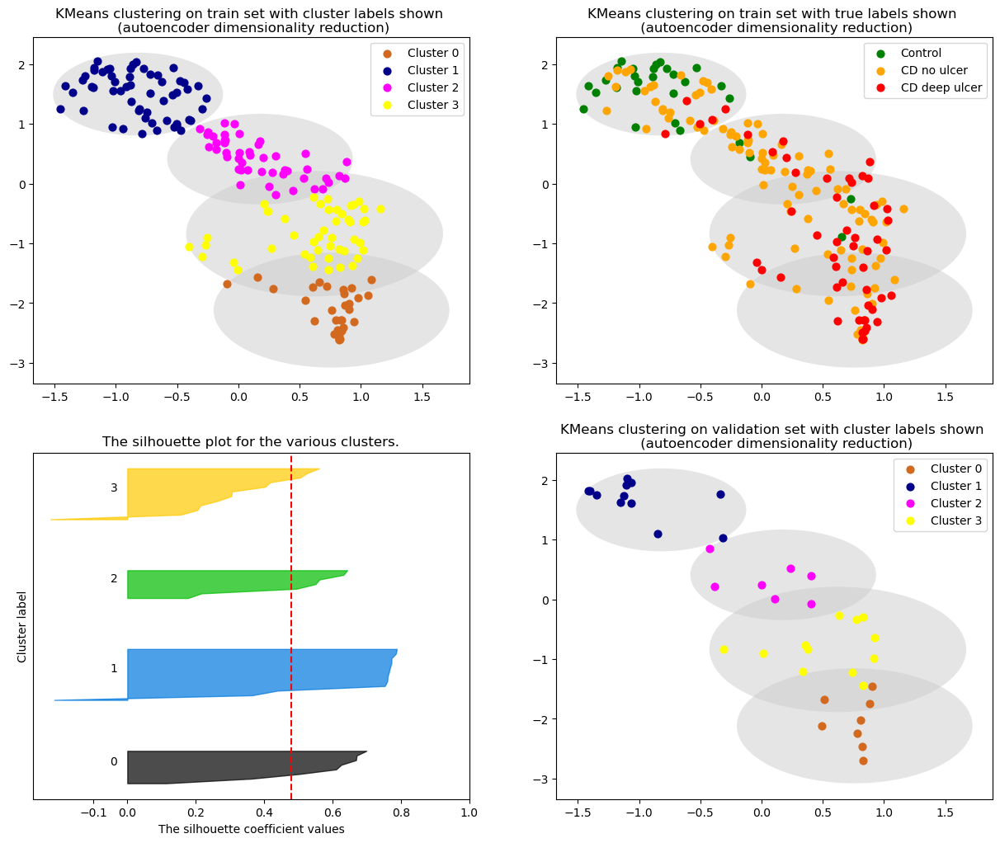

The average silhouette_score is : 0.47924393
Accuracy: 0.1794871794871795
F1 score: 0.2314836865920457


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Perplexity = 190


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


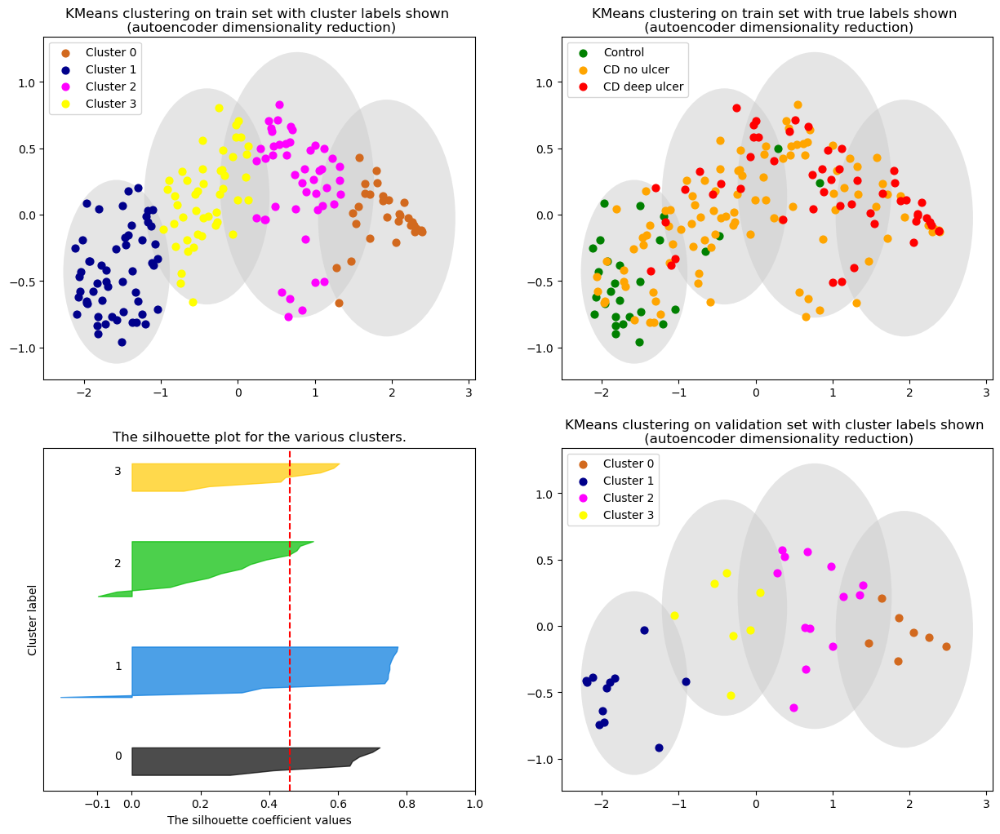

The average silhouette_score is : 0.46057013
Accuracy: 0.3333333333333333
F1 score: 0.3714027149321266


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Perplexity = 200


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


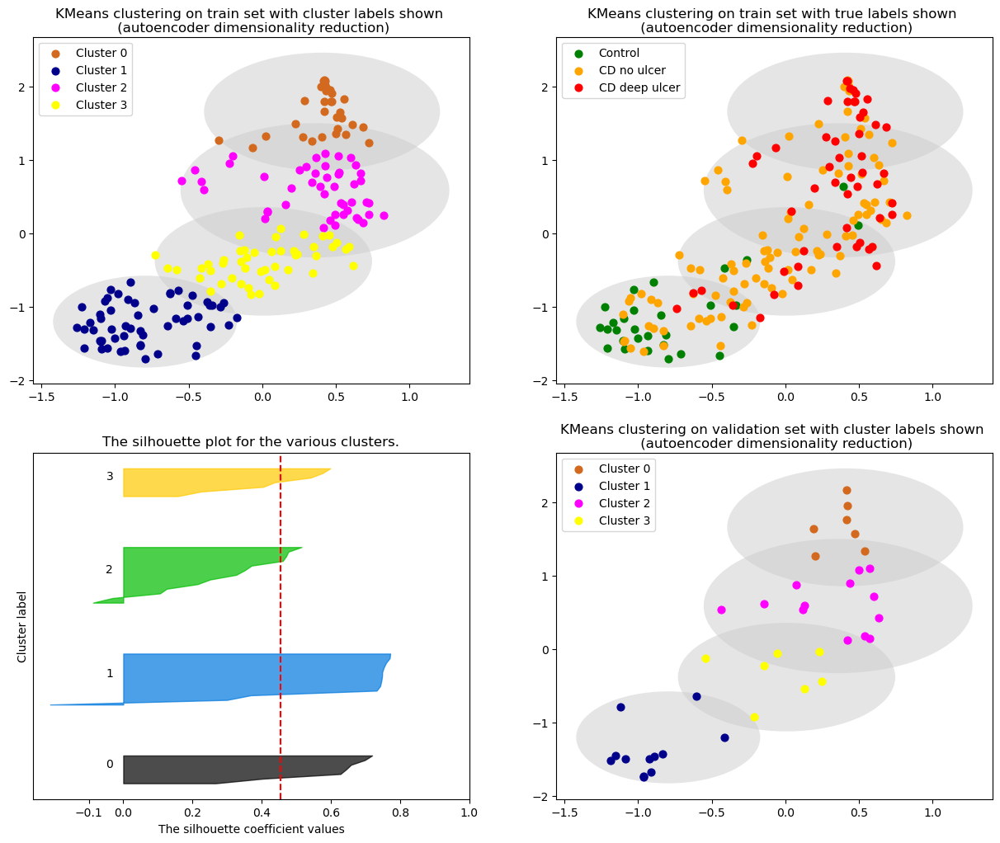

The average silhouette_score is : 0.4549719
Accuracy: 0.3333333333333333
F1 score: 0.3714027149321266


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Perplexity = 210


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


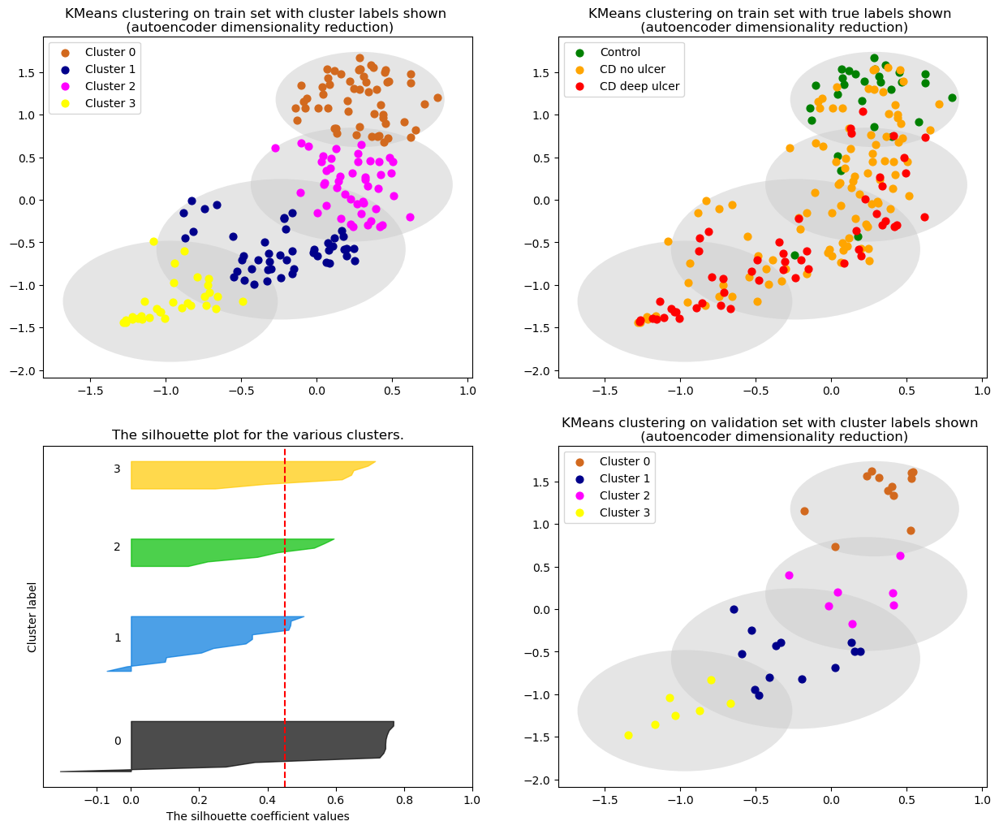

The average silhouette_score is : 0.4500772
Accuracy: 0.3076923076923077
F1 score: 0.30121003867133894


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Perplexity = 220


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


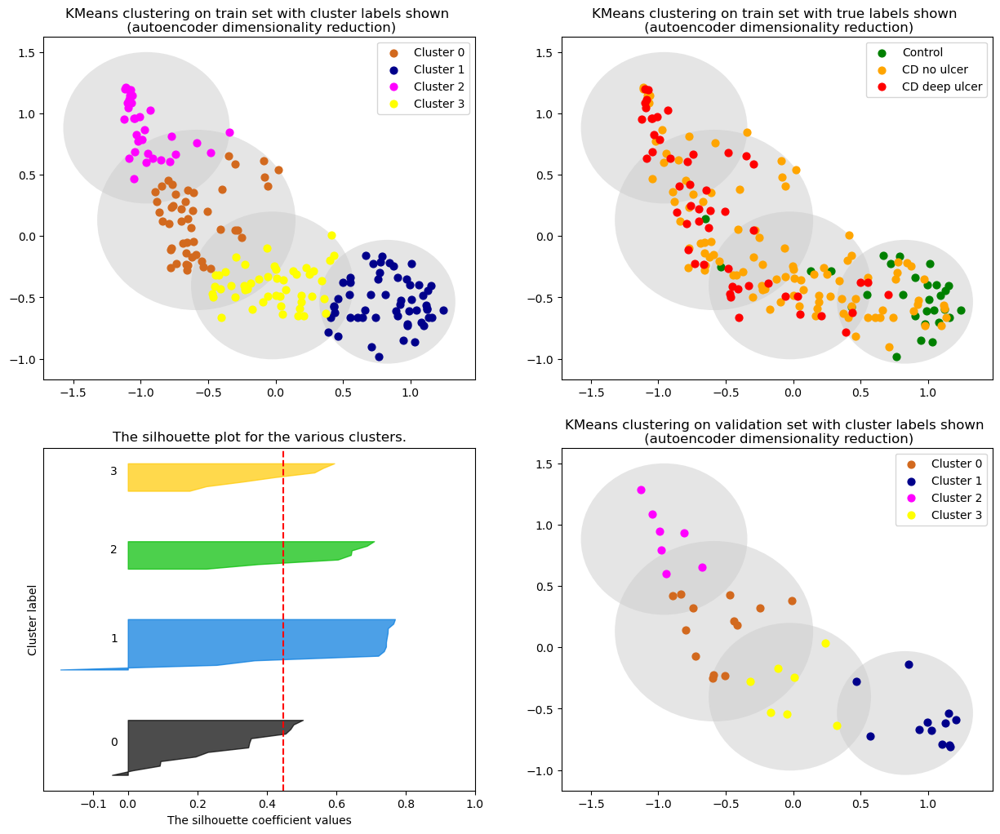

The average silhouette_score is : 0.4468792
Accuracy: 0.23076923076923078
F1 score: 0.29626101452726833


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Perplexity = 230


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


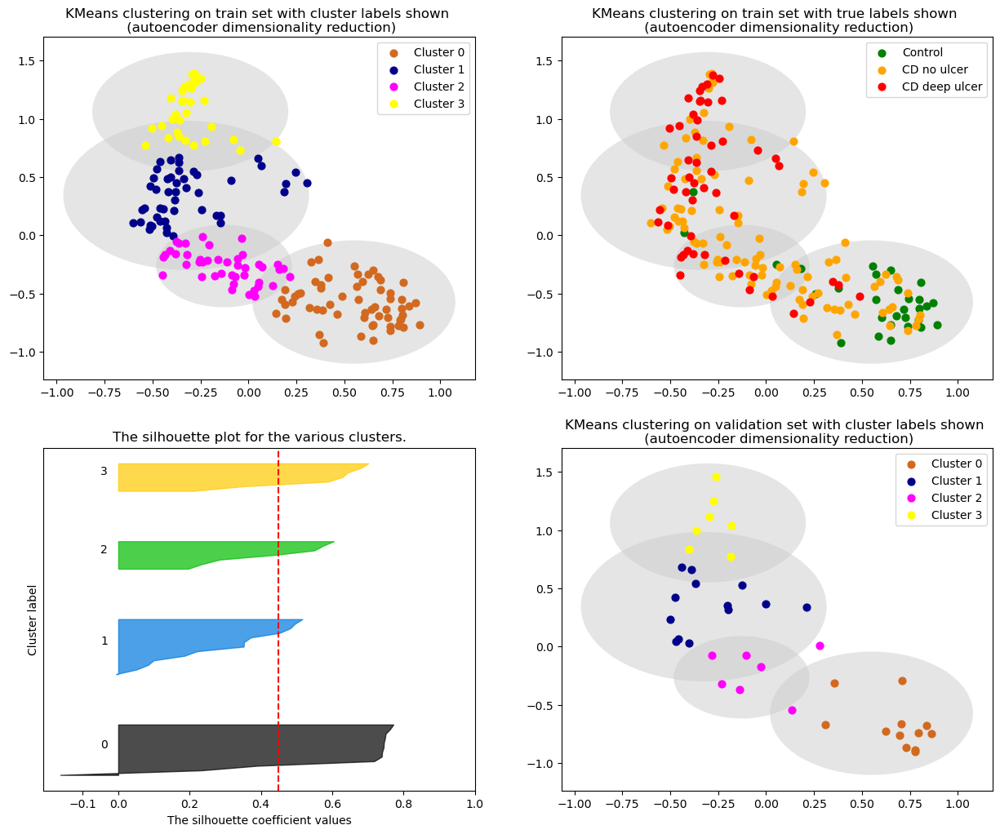

The average silhouette_score is : 0.4490803
Accuracy: 0.3076923076923077
F1 score: 0.30121003867133894


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Perplexity = 240


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


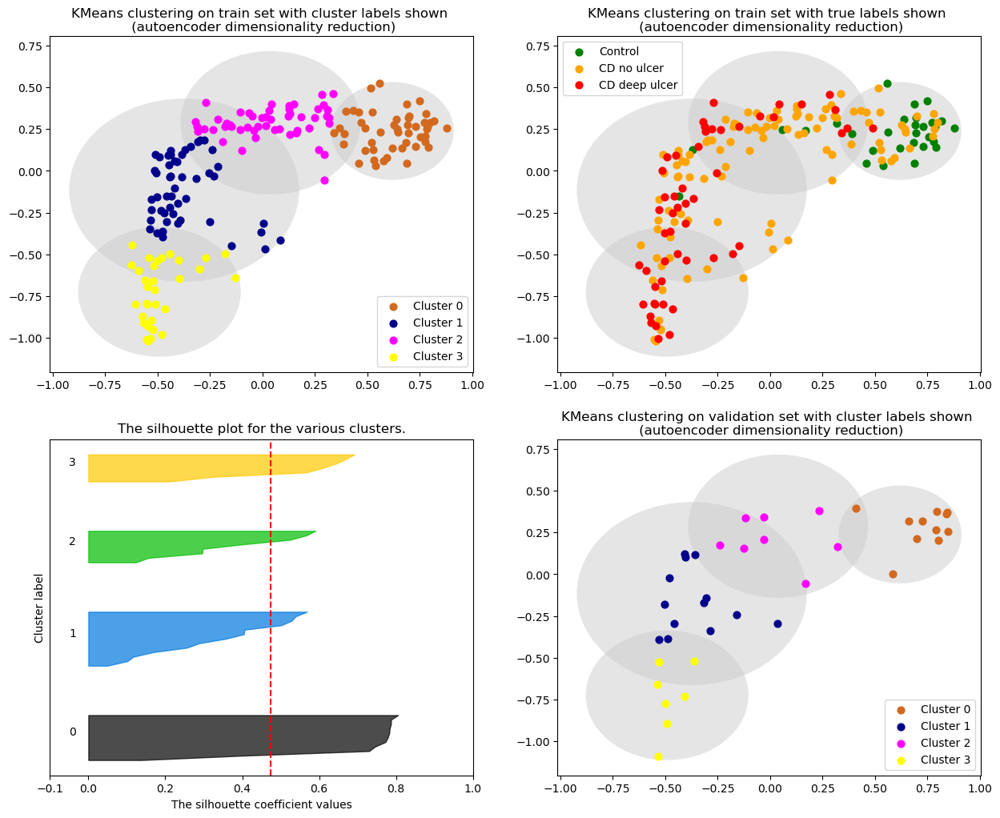

The average silhouette_score is : 0.47363222
Accuracy: 0.3076923076923077
F1 score: 0.3043040293040292


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Perplexity = 250


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


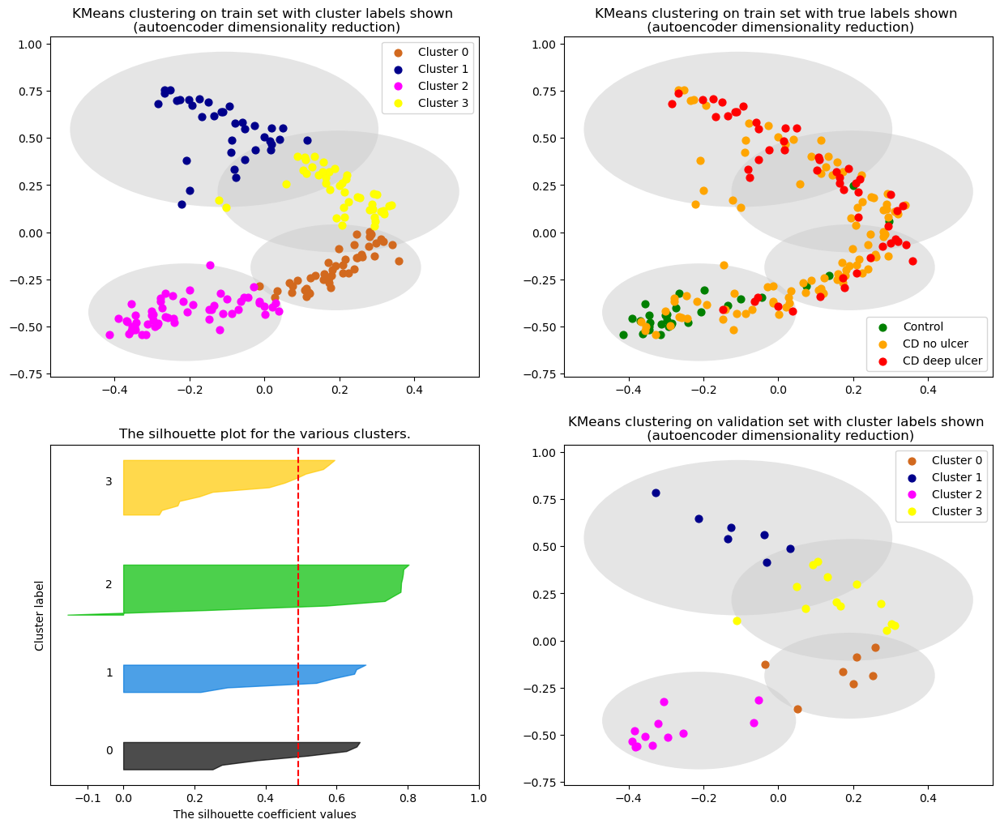

The average silhouette_score is : 0.49304003
Accuracy: 0.1282051282051282
F1 score: 0.1812555260831123


In [37]:
perplexities = np.arange(0, 251, 10)[1:]
sil_scores = []
acc_scores = []
f1_scores = []

for perplexity in perplexities:
    kmeans_ae, X_train_ae, X_val_ae, X_test_ae, k_labels_train_ae, k_labels_val_ae, k_labels_test_ae, centers_ae, radii_ae = train_kmeans(full_ae_dataset, perplexity)
    print("Perplexity =",perplexity)
#     print(k_labels_train_pca)
    sil, acc, f1 = plot_kmeans(X_train_ae, X_val_ae, train_disease_labels, val_disease_labels, k_labels_train_ae, k_labels_val_ae, centers_ae, radii_ae, "autoencoder", test_set=False, plot_sil=True)
    sil_scores.append(sil)
    acc_scores.append(acc)
    f1_scores.append(f1)

# perplexities = [10, 20, 50, 70]
# perplexities = [10, 20, 50, 70, 100, 150, 200, 250]

# for perplexity in perplexities:
#     kmeans_ae, X_train_ae, X_test_ae, k_labels_train_ae, k_labels_test_ae, centers_ae, radii_ae = train_kmeans(full_ae_dataset, perplexity)
#     print("Perplexity =",perplexity)
#     plot_kmeans(X_train_ae, train_disease_labels, k_labels_train_ae, centers_ae, radii_ae, "autoencoder", test_set=False, plot_sil=True)

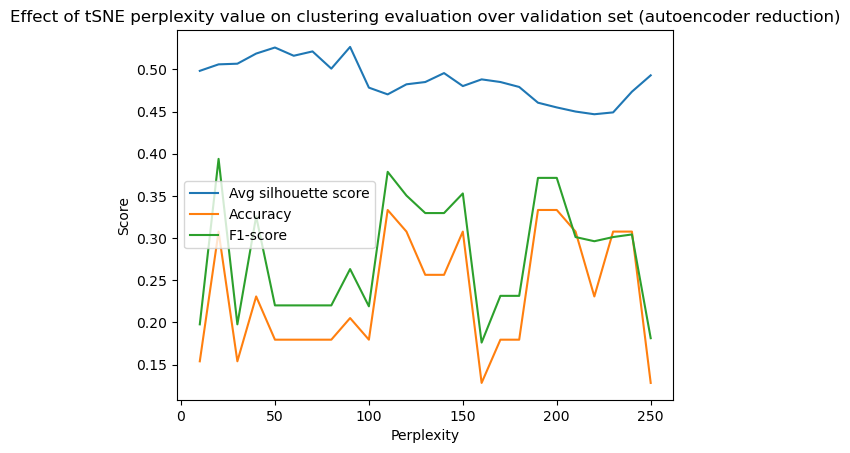

In [38]:
plot_val_scores(sil_scores, acc_scores, f1_scores, "autoencoder")

### Testing

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Perplexity = 200


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


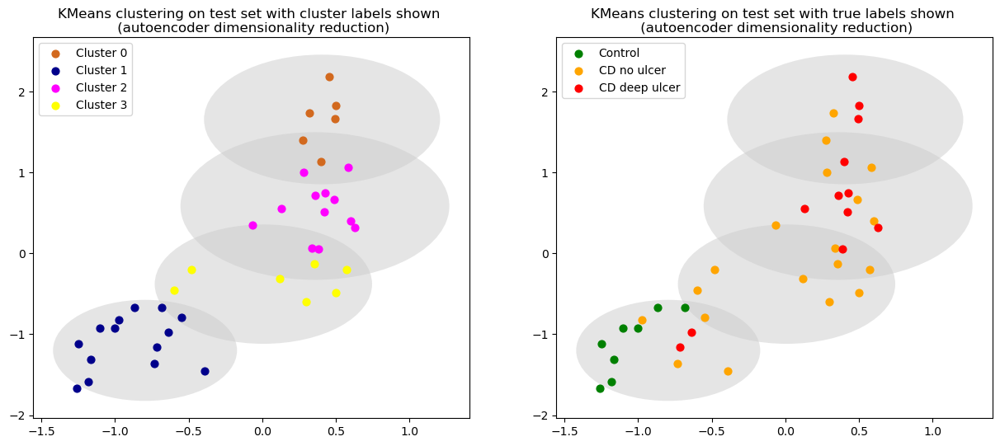

In [39]:
# plot with chosen tsne perplexity
perplexity = 200
kmeans_ae, X_train_ae, _, X_test_ae, k_labels_train_ae, _, k_labels_test_ae, centers_ae, radii_ae = train_kmeans(full_ae_dataset, perplexity)
print("Perplexity =",perplexity)
plot_kmeans(X_test_ae, None, test_disease_labels, None, k_labels_test_ae, None, centers_ae, radii_ae, "autoencoder", test_set=True)


## Process KMeans models

In [40]:
def pair_repeat(dup, cls_assignments, num_c, amounts):
    all_clusters = np.arange(num_c)
    # replace one of the duplicates with max of remaining clusters
    replace_class = np.where(cls_assignments == dup[0])[0][0]
    rem_cluster_a, rem_cluster_b = np.setdiff1d(all_clusters,cls_assignments)
    # rem_cluster_b
    if amounts[replace_class][rem_cluster_a] > amounts[replace_class][rem_cluster_b]:
        cls_assignments[replace_class] = rem_cluster_a
    else:
        cls_assignments[replace_class] = rem_cluster_b
        
    return cls_assignments

def handle_duplicates(cls_assignments, dup, c, num_c, amounts):
#     print("c:",c)
    if len(c) != 1:
        
        cls_assignments = pair_repeat(dup, cls_assignments, num_c, amounts)
    else: # 3 repeats of same thing
        # reassign class least associated to next most associated cluster
        given_cluster = dup[0]
        cls_least = np.argmin(amounts[:,given_cluster])
#         print(cls_least)
        class_amounts = amounts[cls_least,:]
        class_amounts[given_cluster] = -1
        next_cluster = np.argmax(class_amounts)
        cls_assignments[cls_least] = next_cluster
#         print("intermediate assignments",cls_assignments)
        
        # handle other duplicate pair
        u, c = np.unique(cls_assignments, return_counts=True)
        dup = u[c > 1]
        cls_assignments = pair_repeat(dup, cls_assignments, num_c, amounts)

    return cls_assignments


def softmax(x): 
    return np.exp(x)/sum(np.exp(x))

In [41]:

    
def process_clusters(amounts, X_train, num_c):
    all_clusters = np.arange(num_c)

    
    cls_assignments = np.argmax(amounts, axis=1) # assigned to class 0, 1, 2
#     print("initial cls assignments:",cls_assignments)
    
    # check for and handle duplicates
    u, c = np.unique(cls_assignments, return_counts=True)
    dup = u[c > 1]
#     print("dup:",dup[0])
    if len(dup) > 0:
        cls_assignments = handle_duplicates(cls_assignments, dup, c, num_c, amounts)
        
            
    class_assignment_amounts = np.max(amounts, axis=1) 
    
    assignments = [None] * 3
    
    assigned = 0
    while assigned < num_c - 1:
        curr_max_class = np.argmax(class_assignment_amounts)
        assigned_cluster = cls_assignments[curr_max_class]
        if assignments[curr_max_class] is None:
            assignments[curr_max_class] = [assigned_cluster]
        else:
            assignments[curr_max_class].append(assigned_cluster)
        class_assignment_amounts[curr_max_class] = -1
        assigned += 1

    # Assign remaining cluster
    
    rem_cluster = np.setdiff1d(all_clusters,cls_assignments)[0]
    
    rem_cls_assignment = np.argmax(amounts[:,rem_cluster], axis=0)
    assignments[rem_cls_assignment].append(rem_cluster)
    couple = assignments[rem_cls_assignment]
    # clusters assigned to disease class 0, 1, 2 (control, CD_no_ulcer, CD_deep_ulcer)
    
#     print(assignments)
#     print(couple)
    return assignments, couple

In [42]:
def get_class_from_label(label, couple, assignments):
    if label in couple:
        search_term = couple
    else:
        search_term = [label]
    try:
        cls = assignments.index(search_term)
    except:
        return None
    return cls


In [43]:
def get_final_clusters(assignments, couple, labels):
    test_set_clusters = []
    for label in labels:
        cls = get_class_from_label(label, couple, assignments)
        test_set_clusters.append(cls)

    test_set_clusters = np.array(test_set_clusters)
    return test_set_clusters

In [44]:
# centers = kmeans.cluster_centers_
# centers

In [45]:
num_c = 4

In [46]:
def get_count_matrix_km(kmeans, X_train, train_disease_labels):

    
    # make matrix to record number of each class in each cluster
    amounts = np.zeros((3, num_c))
    
    
    classes = ["control", "CD_no_ulcer", "CD_deep_ulcer"]
    centers = kmeans.cluster_centers_
    for c, cls in enumerate(classes):
        for pt in X_train[train_disease_labels==c]:
            pt = pt.reshape(1,-1)
            distances = cdist(centers, pt, 'euclidean')
            closest_cluster = np.argmin(distances)
            amounts[c][closest_cluster] += 1
    

#     print(amounts)
    #                cluster 0, cluster 1, cluster 2, cluster 3
    # control 
    # CD no ulcer
    # CD deep ulcer
    
    return amounts

In [47]:
# get_count_matrix_km(kmeans, X_train, train_disease_labels)

### Apply resulting models to test sets

In [48]:
centers_pca

array([[-0.8459253 , -0.9143598 ],
       [ 1.1489403 ,  0.86589664],
       [ 1.7448617 ,  2.9984028 ],
       [-2.222429  , -2.1584222 ]], dtype=float32)

In [49]:
km_labels_list = [k_labels_test_ae, k_labels_test_pca]
km_models_list = [kmeans_ae, kmeans_pca]
train_set_list = [X_train_ae, X_train_pca]
test_set_list = [X_test_ae, X_test_pca]
centers_list = [centers_ae, centers_pca]
radii_list = [radii_ae, radii_pca]


In [50]:
# X_test_ae

In [51]:
def compute_metrics(X, true_labels, clus_labels):
    silhouette_avg, sample_silhouette_values = compute_silh_scores(X, clus_labels)
    acc = accuracy_score(true_labels, clus_labels)
    f1 = f1_score(true_labels, clus_labels, average='weighted')
#     print("The average silhouette_score is :",silhouette_avg)
#     print("Accuracy:",acc)
#     print("F1 score:",f1)
    
    return silhouette_avg, sample_silhouette_values, acc, f1

def print_scores(s_avgs, accs, f1_scores):
    typ = ["Autoencoder","PCA"]
    for i in range(len(accs)):
        print(typ[i]+":")
        print("Average silhouette score:",s_avgs[i])
        print("Accuracy:",accs[i])
        print("F1 score:",f1_scores[i])

C:\Users\shard\AppData\Local\Temp\ipykernel_22504\2391998775.py:46: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_test[test_set_clusters==i, 0], X_test[test_set_clusters==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


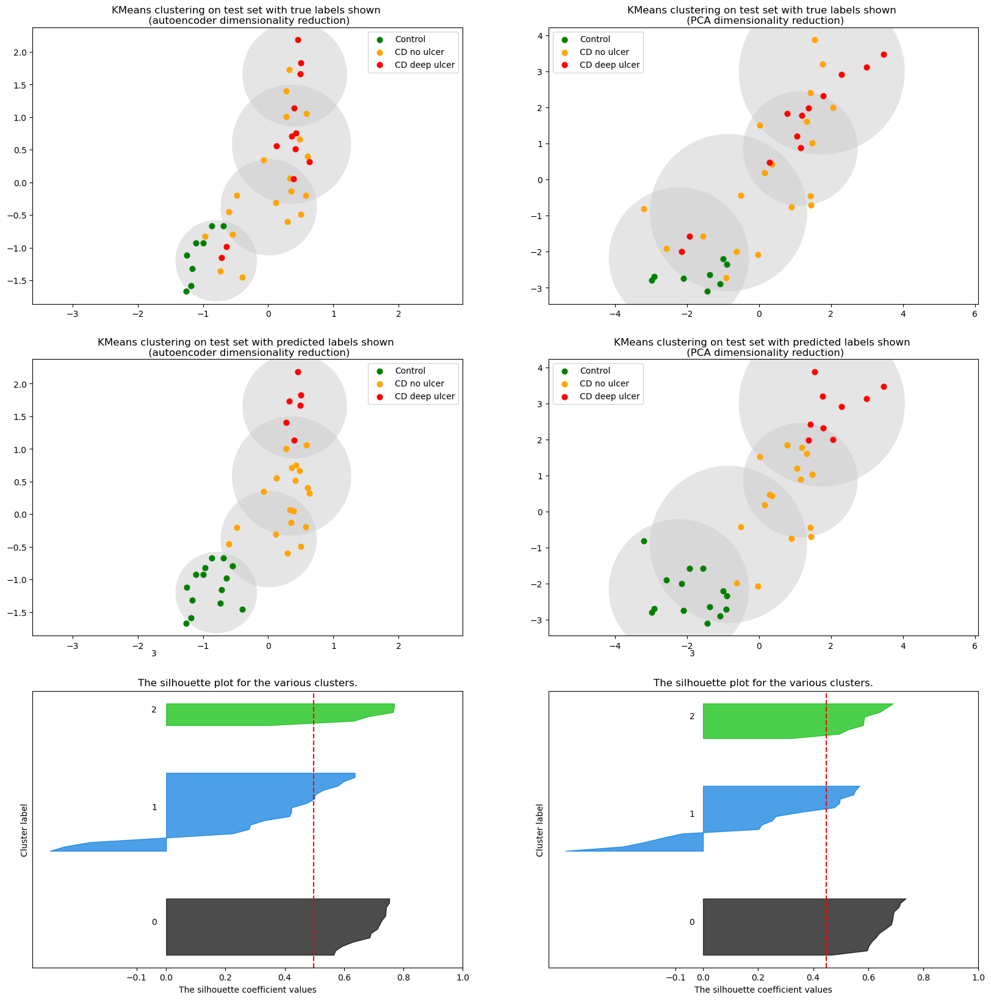

Autoencoder:
Average silhouette score: 0.49773225
Accuracy: 0.0
F1 score: 0.0
PCA:
Average silhouette score: 0.4462612
Accuracy: 0.5641025641025641
F1 score: 0.5296198054818745


In [52]:
def plot_final_km_models(labels_list, models_list, train_set_list, test_set_list, centers_list, radii_list, num_c):

    (fig, subplots) = plt.subplots(3, 2, figsize=(20,20))
    reduction = ["autoencoder", "PCA"]
    final_clusters_lst = []
    label_type = ["true","predicted"]
    for t in range(2):
        label = label_type[t]
        for i in range(len(models_list)):
    #         print(i)
            ax = subplots[t][i]
            km = models_list[i]
            km_labels = labels_list[i]
            X_train = train_set_list[i]
            X_test = test_set_list[i]
            centers = centers_list[i]
            radii = radii_list[i]
            if t > 0:
                amounts = get_count_matrix_km(km, X_train, train_disease_labels)
                assignments, couple = process_clusters(amounts, X_train, num_c)
                test_set_clusters = get_final_clusters(assignments, couple, km_labels)
                final_clusters_lst.append(test_set_clusters)
            else:
                test_set_clusters = test_disease_labels
    #         print("gmmlabels:",gmm_labels)
    #         print("tsclusters:",test_set_clusters)
    #         print("asgn:",assignments)
            

#             if t > 0:
#                 test_set_clusters, probs = final_gmm_model_get_clusters(gmm, X_train, X_test, train_disease_labels)
#                 final_clusters_lst.append(test_set_clusters)
#                 final_probs_lst.append(probs)
#             else:
#                 test_set_clusters = test_disease_labels


            reduc = reduction[i]
            num_clusters = 3
            cluster_names = ["Control", "CD no ulcer", "CD deep ulcer"]
            colours = ["green", "orange", "red"]
            ax.set_title("KMeans clustering on test set with "+label+" labels shown \n (" + reduc + " dimensionality reduction)",
                        wrap=True)

            for i in range(num_clusters):
                ax.scatter(X_test[test_set_clusters==i, 0], X_test[test_set_clusters==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2) 

            ax.axis('equal')


            for c, r in zip(centers, radii):
                ax.add_patch(plt.Circle(c, r, fc='#CCCCCC', lw=3, alpha=0.5, zorder=1))

            ax.legend()

    s_avgs = []
    accs = []
    f1_scores = []
    for j in range(2):
        ax = subplots[2][j]
        X_test = test_set_list[j]
        test_clusters = final_clusters_lst[j]
        true_labels = labels_list[j]
#         silhouette_avg, sample_silhouette_values = compute_silh_scores(X_test, test_clusters)
        sil, sample_silhouette_values, acc, f1 = compute_metrics(X_test, true_labels, test_clusters)
        s_avgs.append(sil)
        accs.append(acc)
        f1_scores.append(f1)
        plot_silhouette(num_c, test_clusters, sample_silhouette_values, sil, ax)

    plt.show()


    print_scores(s_avgs, accs, f1_scores)

    
    return final_clusters_lst
        
final_clusters_ae, final_clusters_pca = plot_final_km_models(km_labels_list, km_models_list, train_set_list, test_set_list, centers_list, radii_list, num_c)

In [53]:
final_clusters_ae

array([1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 2, 1, 0, 2, 0, 0, 0, 1, 2, 1,
       1, 0, 2, 2, 1, 0, 1, 1, 0, 1, 0, 0, 1, 2, 1, 1, 1])

## Gaussian Mixture Models

In [54]:
# https://jakevdp.github.io/PythonDataScienceHandbook/05.12-gaussian-mixtures.html

from matplotlib.patches import Ellipse
from sklearn import mixture

def draw_ellipse(position, covariance, ax=None, **kwargs):
    """Draw an ellipse with a given position and covariance"""
    ax = ax or plt.gca()
    
    # Convert covariance to principal axes
    if covariance.shape == (2, 2):
        U, s, Vt = np.linalg.svd(covariance)
        angle = np.degrees(np.arctan2(U[1, 0], U[0, 0]))
        width, height = 2 * np.sqrt(s)
    else:
        angle = 0
        width, height = 2 * np.sqrt(covariance)
    
    # Draw the Ellipse
    for nsig in range(1, 4):
        ax.add_patch(Ellipse(position, nsig * width, nsig * height,
                             angle, **kwargs))
        
def plot_gmm(gmm, X, X_val, true_labels, reduction, num_c=3, test=False, plot_sil=False):
    
    
    num_rows = 2 if plot_sil else 1
    dim_h = 12 if plot_sil else 6
    dim_w = 15 if plot_sil else 15
    (fig, subplots) = plt.subplots(num_rows, 2, figsize=(dim_w, dim_h))
    

    gmm_labels = gmm.predict(X)
    print(gmm_labels)
#     (fig, subplots) = plt.subplots(1, 2, figsize=(15, 6))
#     ax = ax or plt.gca()
    labels = [gmm_labels, true_labels]
    num_clusters = 3
    dset = "test" if test else "train"
    for i, label_set in enumerate(labels):
        ax = subplots[0][i] if plot_sil else subplots[i]
#         left = -8
#         right = 8
#         ax.set_xlim(left, right)
#         ax.set_ylim(left, right)
        
        
        if i==0:
            num_clusters = num_c
            cluster_names = ["Cluster " + str(i) for i in range(num_clusters)]
            colours = ["chocolate", "darkblue", "magenta", "yellow", "blue"]
            ax.set_title("GMM soft clustering on " + dset + " set with cluster labels shown \n (" + reduction + " dimensionality reduction)",
                         wrap=True)
        else:
            num_clusters = 3
            cluster_names = ["Control", "CD no ulcer", "CD deep ulcer"]
            colours = ["green", "orange", "red"]
            ax.set_title("GMM soft clustering on " + dset + " set with true labels shown \n (" + reduction + " dimensionality reduction)",
                        wrap=True)
        
        print("num_clusters",num_clusters)
        for i in range(num_clusters):
            ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2) 

        ax.axis('equal')
        

        w_factor = 0.2 / gmm.weights_.max()
        for pos, covar, w in zip(gmm.means_, gmm.covariances_, gmm.weights_):
            draw_ellipse(pos, covar, alpha=w * w_factor, ax=ax)
        ax.legend()
        
        
    if plot_sil:
        gmm_val_labels = gmm.predict(X_val)
        silhouette_avg, sample_silhouette_values = compute_silh_scores(X_val, gmm_val_labels)
        plot_silhouette(num_c, gmm_val_labels, sample_silhouette_values, silhouette_avg, subplots[1][0])
#         subplots[1][1].axis('off')
        acc = accuracy_score(val_disease_labels, gmm_val_labels)
        f1 = f1_score(val_disease_labels, gmm_val_labels, average='weighted')
        ax = subplots[1][1]
        num_clusters = num_c
        cluster_names = ["Cluster " + str(i) for i in range(num_clusters)]
        colours = ["chocolate", "darkblue", "magenta", "yellow", "blue"]
        ax.set_title("KMeans clustering on validation set with cluster labels shown \n (" + reduction + " dimensionality reduction)",
                     wrap=True)
        for i in range(num_clusters):
            ax.scatter(X_val[gmm_val_labels==i, 0], X_val[gmm_val_labels==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2) 
        w_factor = 0.2 / gmm.weights_.max()
        for pos, covar, w in zip(gmm.means_, gmm.covariances_, gmm.weights_):
            draw_ellipse(pos, covar, alpha=w * w_factor, ax=ax)
    
    plt.show()
    
    if plot_sil:
        print("The average silhouette_score is :",silhouette_avg)
        print("Accuracy:",acc)
        print("F1 score:",f1)
        
        return silhouette_avg, acc, f1
        
        
    return gmm_labels

        
# def get_tsne_ds_true_labels():
#     tsne = manifold.TSNE(
#         n_components=2,
#         init="random",
#         random_state=0,
#         perplexity=24,
#         n_iter=750,
#         method='exact'
#     )
#     X = tsne.fit_transform(test_set)

In [55]:
# gmm.means_
# gmm.covariances_
# gmm.weights_

### Fit GMM with PCA dimensionality reduction

#### Training

In [56]:
num_c = 4

def fit_gmm(full_dataset, perplexity, num_c, split_pt=None):
    gmm = mixture.GaussianMixture(n_components=num_c,covariance_type='full', random_state=42)
    tsne = manifold.TSNE(
        n_components=2,
        init="random",
        random_state=0,
        perplexity=perplexity,
        n_iter=750,
        method='exact'
    )
    X = tsne.fit_transform(full_dataset)
    
    if split_pt is None:
        split_pt = int(0.7*len(full_dataset))
        split_pt_val = int(0.85*len(full_dataset))
        X_test = X[split_pt_val:]
        X_val = X[split_pt:split_pt_val]
    else:
        X_val = None
        X_test = X[split_pt:]
    X_train = X[:split_pt]
    gmm.fit(X_train)
    
    return gmm, X_train, X_test, X_val

Perplexity = 10
[0 2 0 3 3 3 1 2 2 1 1 1 0 1 2 1 0 2 0 2 0 3 1 0 2 3 2 0 3 3 1 3 3 3 0 3 0
 3 2 3 1 2 1 1 3 3 3 0 3 1 1 3 2 3 3 0 3 2 3 3 2 3 2 1 3 1 3 0 3 2 3 3 0 0
 0 3 3 2 3 2 1 2 1 1 2 3 0 1 3 2 0 3 3 1 2 0 3 0 3 0 1 3 0 1 1 3 2 0 3 2 2
 1 0 3 0 1 3 1 3 0 1 2 0 2 0 1 1 1 0 2 1 2 2 1 3 3 1 1 2 1 2 0 3 2 2 1 0 3
 2 3 1 1 3 3 3 1 3 3 0 2 1 3 0 0 3 1 3 2 2 0 0 0 3 0 3 0 0 1 2 0 3 3]
num_clusters 4
num_clusters 3


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:88: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[gmm_val_labels==i, 0], X_val[gmm_val_labels==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing th

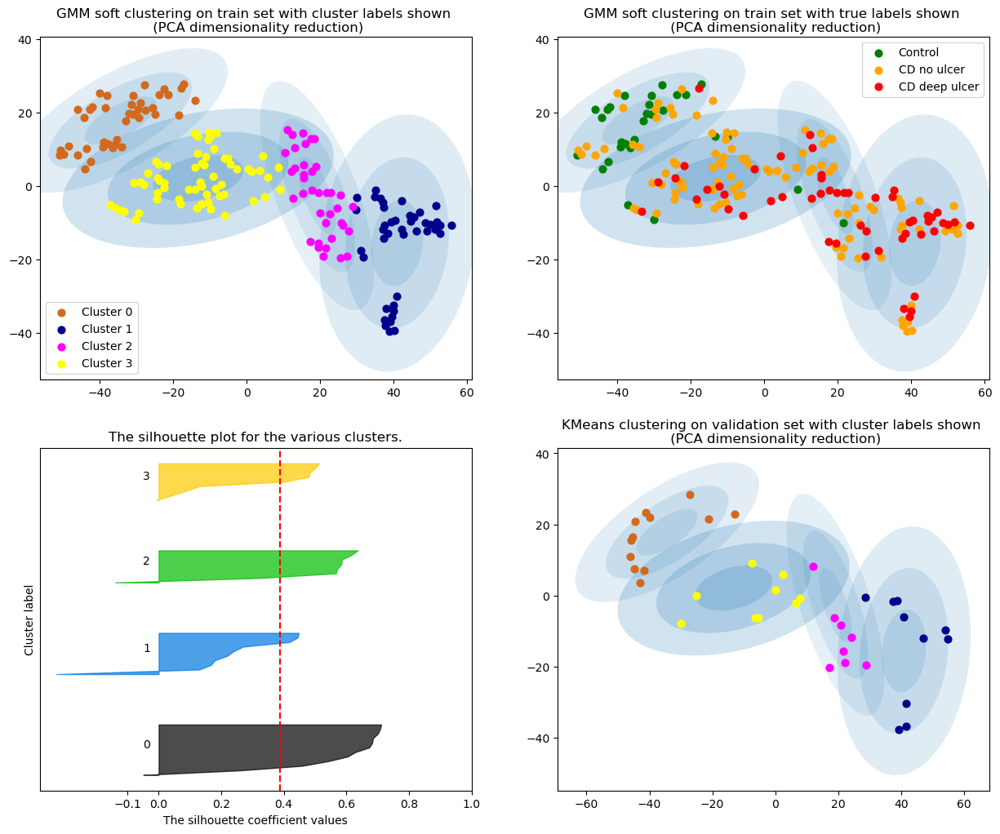

The average silhouette_score is : 0.38908803
Accuracy: 0.3076923076923077
F1 score: 0.3087481146304676
Perplexity = 20
[0 2 3 2 0 0 2 2 2 2 2 1 3 2 2 1 3 2 3 2 3 3 1 3 2 3 2 3 3 3 2 2 0 0 3 0 3
 3 2 0 2 2 2 2 2 0 0 3 3 2 2 2 2 0 0 3 3 2 0 3 2 0 2 2 0 1 0 3 0 2 0 0 3 3
 3 0 3 2 2 2 2 2 2 2 2 0 3 2 3 2 3 3 0 2 2 3 0 0 2 3 2 2 3 2 1 0 2 3 0 2 2
 2 3 0 3 2 3 2 0 3 1 2 3 2 3 2 1 2 3 2 2 2 2 2 2 0 1 2 2 1 2 3 0 2 2 2 3 3
 2 3 2 2 3 3 0 2 0 3 3 2 2 0 3 3 0 2 3 2 2 3 3 3 0 3 3 3 3 1 2 3 2 0]
num_clusters 4
num_clusters 3


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:88: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[gmm_val_labels==i, 0], X_val[gmm_val_labels==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing th

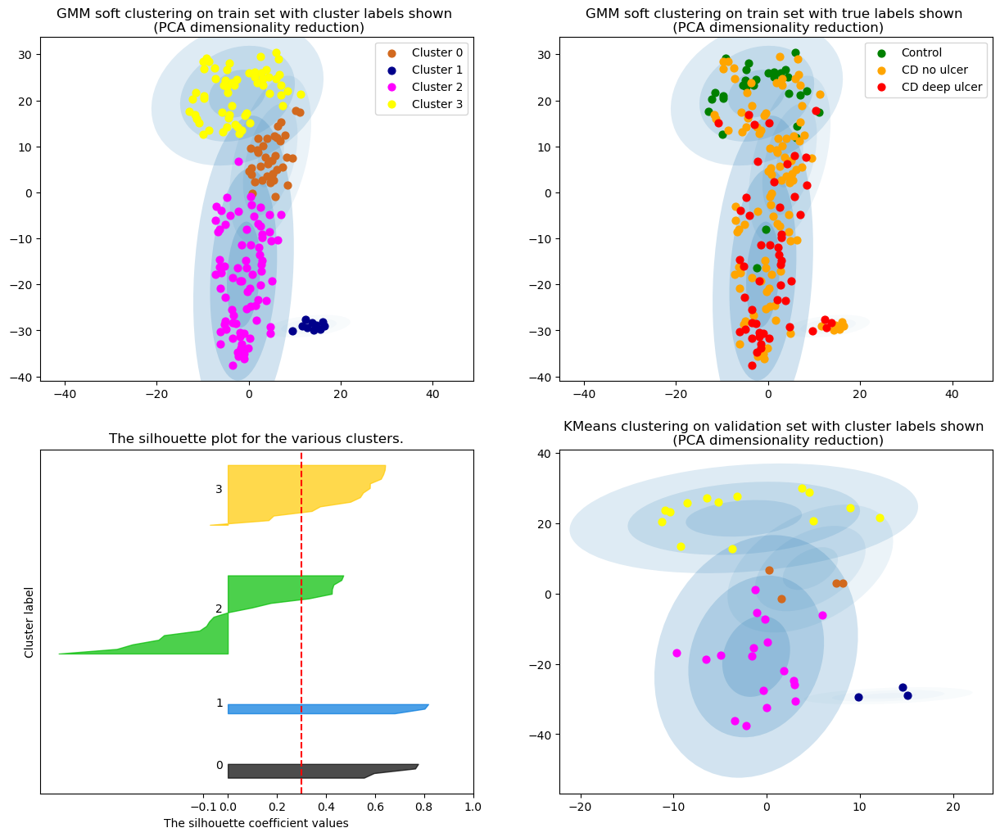

The average silhouette_score is : 0.29981375
Accuracy: 0.28205128205128205
F1 score: 0.27487179487179486
Perplexity = 30
[3 2 3 2 0 0 2 2 2 1 1 1 3 1 2 1 3 2 3 2 3 3 1 3 2 0 2 3 3 3 1 0 0 0 3 0 3
 0 2 0 2 2 1 1 2 0 0 3 0 2 1 2 2 0 0 3 0 2 0 0 2 0 2 1 0 1 0 3 0 2 0 0 3 3
 3 0 0 2 2 2 1 2 1 1 2 3 3 2 3 2 3 3 0 1 2 3 0 3 2 3 2 2 3 1 1 0 2 3 0 2 2
 2 3 0 3 1 3 2 0 3 1 2 3 2 3 1 1 1 3 2 1 2 2 1 2 0 1 1 2 1 2 3 3 2 2 1 3 3
 2 0 1 1 0 0 0 1 0 3 3 2 1 0 3 3 0 1 3 2 2 3 3 3 0 3 3 3 3 1 2 3 0 0]
num_clusters 4
num_clusters 3


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:88: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[gmm_val_labels==i, 0], X_val[gmm_val_labels==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing th

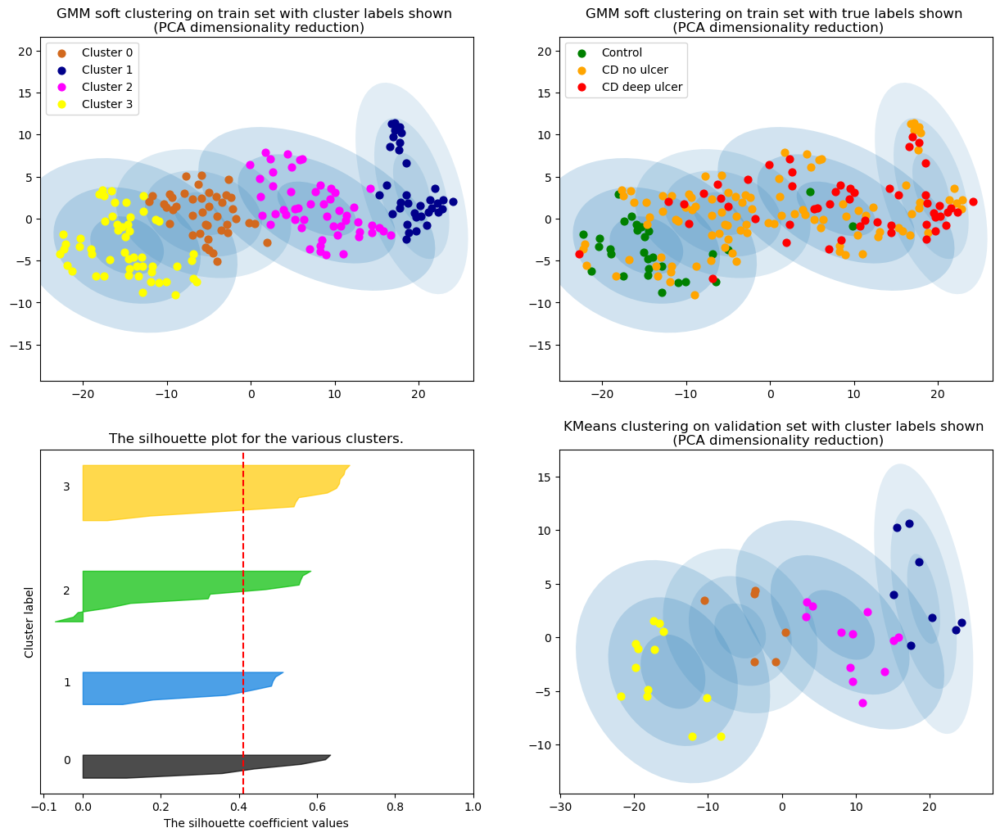

The average silhouette_score is : 0.41200608
Accuracy: 0.3076923076923077
F1 score: 0.3675213675213675
Perplexity = 40
[0 2 3 1 2 2 1 2 2 1 1 1 0 1 1 1 3 2 0 2 3 2 1 3 1 2 2 0 3 2 1 2 2 2 0 2 3
 2 1 2 1 2 1 1 2 2 2 0 3 1 1 2 1 2 2 0 3 1 2 2 2 2 1 1 2 1 2 0 2 1 2 2 0 0
 0 2 2 1 2 2 1 1 1 1 1 0 3 1 3 1 3 3 2 1 1 3 2 0 2 3 1 2 0 1 1 2 2 3 2 2 1
 1 3 2 0 1 2 1 2 3 1 1 0 1 3 1 1 1 0 1 1 1 1 1 2 2 1 1 1 1 1 3 0 1 2 1 3 3
 1 2 1 1 2 2 2 1 2 3 0 1 1 2 0 3 2 1 3 1 1 0 3 0 2 0 3 3 3 1 2 0 2 2]
num_clusters 4
num_clusters 3


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:88: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[gmm_val_labels==i, 0], X_val[gmm_val_labels==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing th

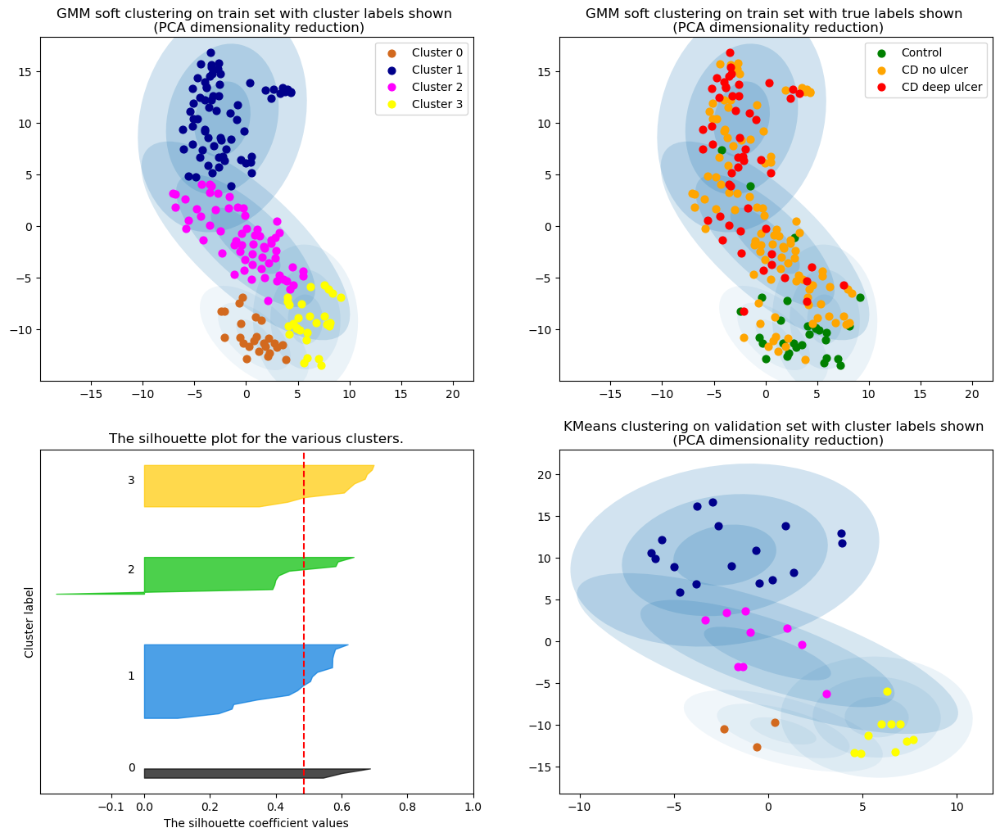

The average silhouette_score is : 0.48505822
Accuracy: 0.3333333333333333
F1 score: 0.3803183995491688
Perplexity = 50
[0 2 3 2 0 2 2 2 2 2 2 1 3 2 2 1 3 2 3 2 3 3 1 3 2 3 2 3 3 3 2 0 2 0 3 0 3
 3 2 0 2 2 2 1 2 0 0 3 3 2 1 2 2 0 0 3 3 2 0 3 2 0 2 2 0 1 0 3 0 2 0 0 3 3
 3 0 3 2 2 2 1 2 1 2 2 0 3 2 3 2 3 3 0 2 2 3 0 0 2 3 2 2 3 2 1 0 2 3 0 2 2
 2 3 0 3 2 3 2 0 3 1 2 3 2 3 1 1 2 3 2 2 2 2 2 2 0 1 2 2 1 2 3 0 2 2 2 3 3
 2 3 2 2 0 3 0 2 0 3 3 2 1 0 3 3 0 2 3 2 2 3 3 3 0 3 3 3 3 1 2 3 2 0]
num_clusters 4
num_clusters 3


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:88: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[gmm_val_labels==i, 0], X_val[gmm_val_labels==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing th

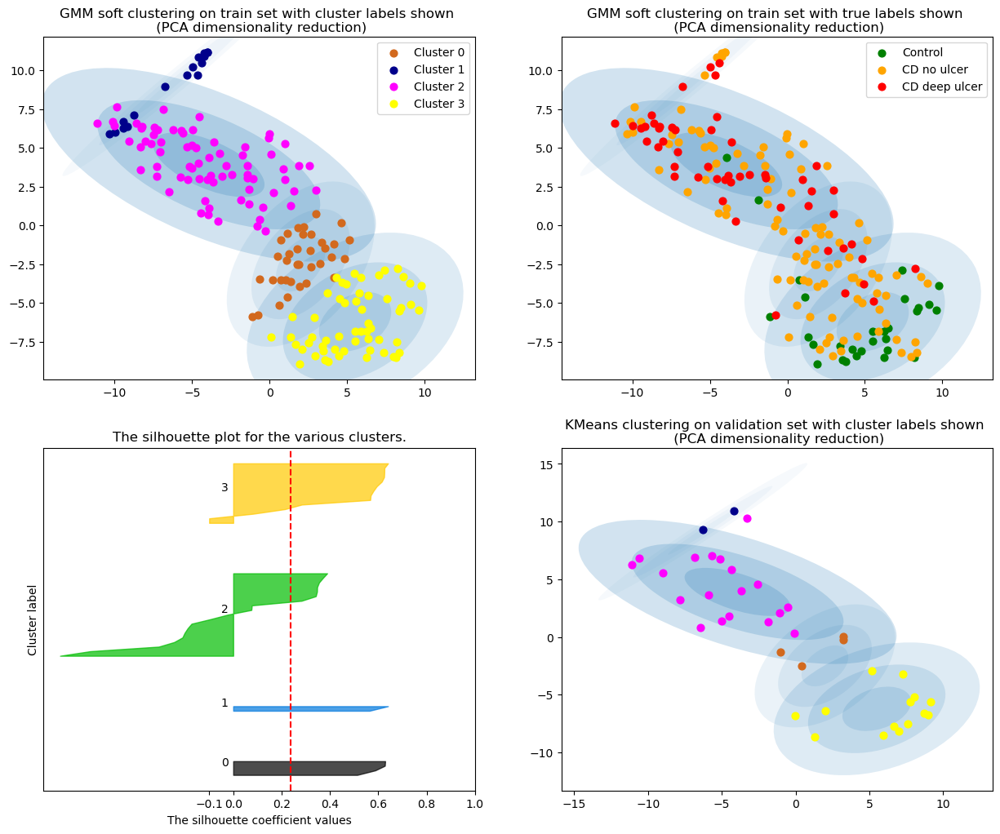

The average silhouette_score is : 0.23621398
Accuracy: 0.2564102564102564
F1 score: 0.22566859663633862
Perplexity = 60
[3 2 3 2 0 2 2 2 2 2 2 1 3 2 2 1 3 2 3 2 3 3 1 3 2 3 2 3 3 3 2 0 2 0 3 0 3
 0 2 0 2 2 2 2 2 0 0 3 3 2 2 2 2 0 0 3 3 2 0 3 2 0 2 2 0 1 0 3 0 2 0 0 3 3
 3 0 3 2 2 2 2 2 2 2 2 0 3 2 3 2 3 3 0 2 2 3 0 3 2 3 2 2 3 2 1 0 2 3 0 2 2
 2 3 0 3 2 3 2 0 3 1 2 3 2 3 2 1 2 3 2 2 2 2 2 2 0 1 2 2 1 2 3 0 2 2 2 3 3
 2 3 2 2 0 3 0 2 0 3 3 2 2 0 3 3 0 2 3 2 2 3 3 3 0 3 3 3 3 1 2 3 2 0]
num_clusters 4
num_clusters 3


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:88: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[gmm_val_labels==i, 0], X_val[gmm_val_labels==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing th

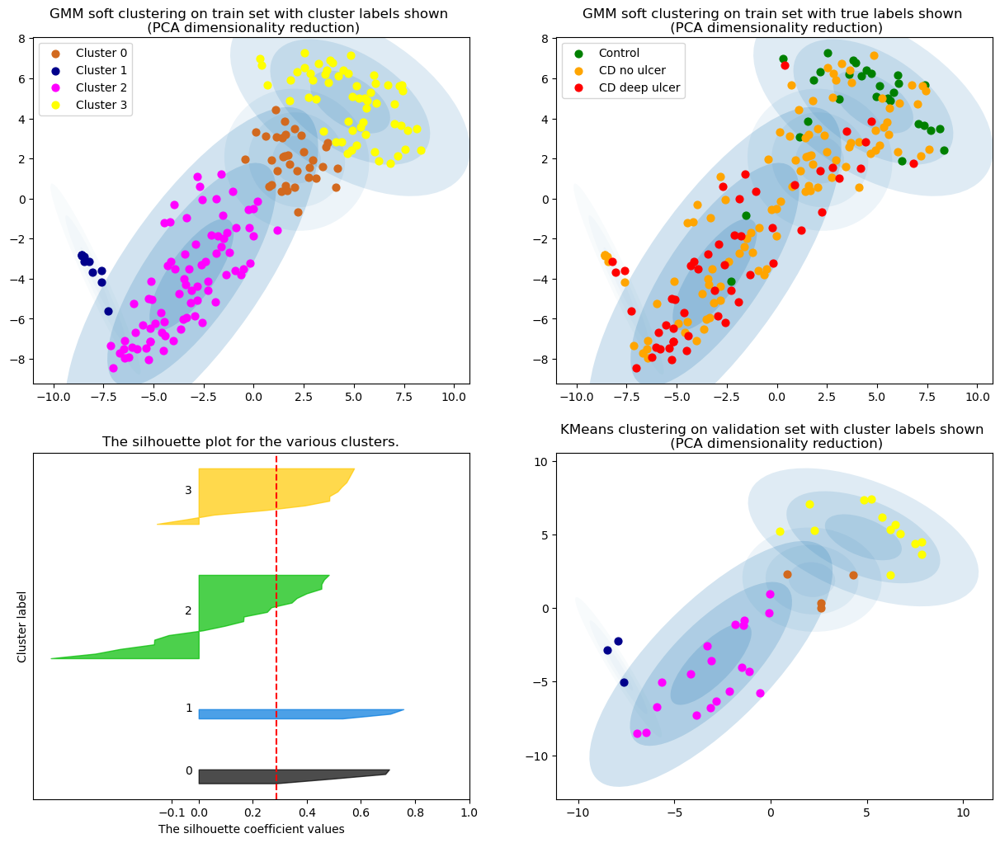

The average silhouette_score is : 0.286681
Accuracy: 0.28205128205128205
F1 score: 0.2689164598842018
Perplexity = 70
[3 2 3 2 0 2 2 2 2 2 2 1 3 2 2 1 3 2 3 2 3 3 2 3 2 3 2 3 3 3 2 0 2 0 3 0 3
 0 2 0 2 2 2 2 2 0 0 3 3 2 2 2 2 0 0 3 3 2 0 3 2 0 2 2 0 1 0 3 0 2 0 0 3 3
 3 0 3 2 2 2 2 2 2 2 2 0 3 2 3 2 3 3 0 2 2 3 0 3 2 3 2 2 3 2 1 0 2 3 0 2 2
 2 3 0 3 2 3 2 0 3 1 2 3 2 3 2 1 2 3 2 2 2 2 2 2 0 1 2 2 1 2 3 3 2 2 2 3 3
 2 3 2 2 0 3 0 2 0 3 3 2 2 0 3 3 0 2 3 2 2 3 3 3 0 3 3 3 3 1 2 3 2 0]
num_clusters 4
num_clusters 3


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:88: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[gmm_val_labels==i, 0], X_val[gmm_val_labels==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing th

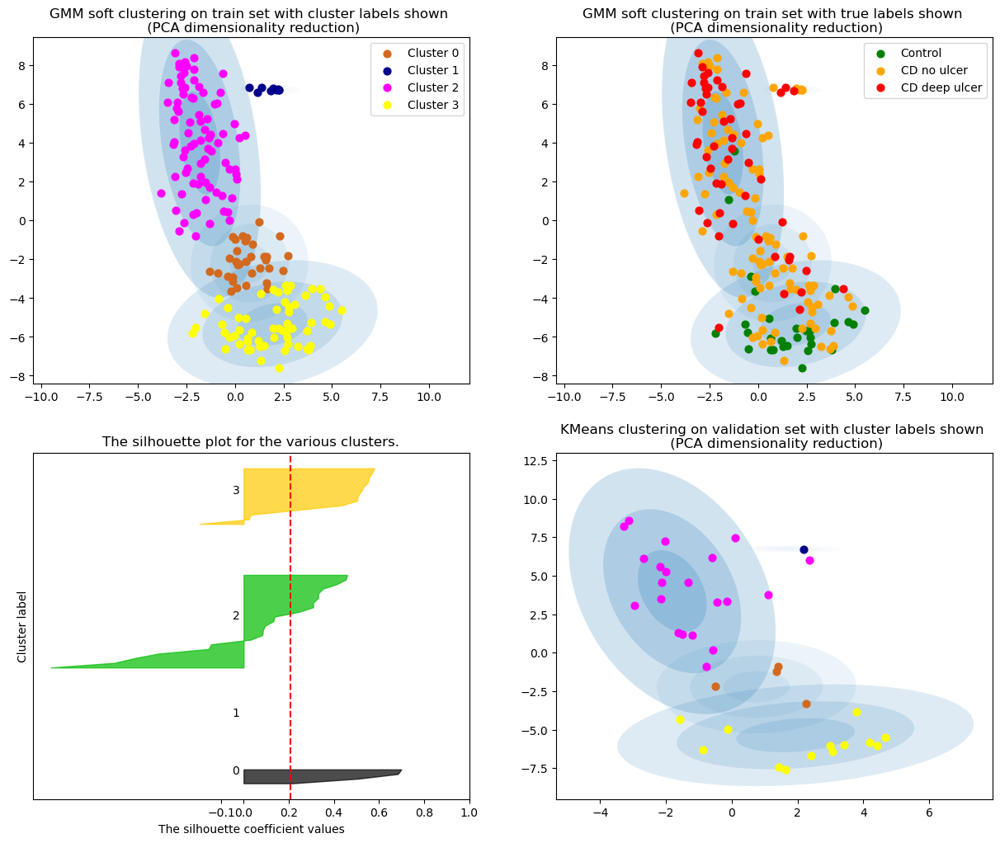

The average silhouette_score is : 0.20831226
Accuracy: 0.23076923076923078
F1 score: 0.1678321678321678
Perplexity = 80
[3 2 3 2 0 2 2 2 2 2 2 1 3 2 2 1 3 2 3 2 3 3 1 3 2 3 2 3 3 3 2 0 2 0 3 0 3
 0 2 0 2 2 2 2 2 0 0 3 3 2 1 2 2 0 0 3 3 2 0 3 2 0 2 2 0 1 0 3 0 2 2 0 3 3
 3 0 0 2 2 2 1 2 2 2 2 0 3 2 3 2 3 3 0 2 2 3 0 3 2 3 2 2 3 2 1 0 2 3 0 2 2
 2 3 0 3 2 3 2 0 3 1 2 3 2 3 2 1 2 3 2 2 2 2 2 2 0 1 2 2 1 2 3 0 2 2 2 3 3
 2 3 2 2 0 0 0 2 0 3 3 2 2 0 3 3 0 2 3 2 2 3 3 3 0 3 3 3 3 1 2 3 2 0]
num_clusters 4
num_clusters 3


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:88: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[gmm_val_labels==i, 0], X_val[gmm_val_labels==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing th

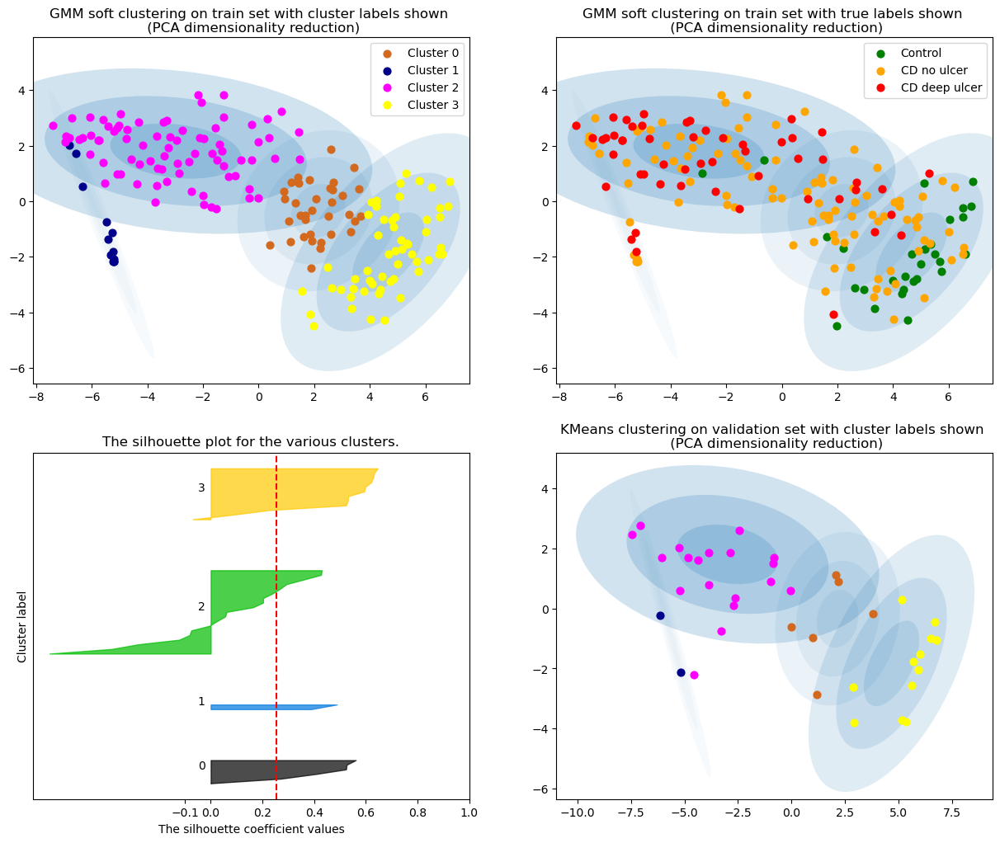

The average silhouette_score is : 0.2532059
Accuracy: 0.2564102564102564
F1 score: 0.22566859663633862
Perplexity = 90
[0 3 0 3 2 3 3 3 2 3 1 1 0 3 3 1 0 3 0 3 0 0 1 0 3 0 3 0 0 0 3 2 3 2 0 2 0
 0 3 2 3 3 1 3 3 2 2 0 0 3 1 3 3 2 2 0 0 3 2 0 3 2 3 3 2 1 2 0 0 3 2 2 0 0
 0 2 0 3 3 3 1 3 3 3 3 2 0 3 0 3 0 0 2 3 3 0 2 2 2 0 3 3 2 3 1 2 3 0 2 3 3
 3 0 2 2 3 0 3 2 0 1 3 0 3 0 3 1 3 0 3 3 3 3 3 3 2 1 3 3 1 3 0 2 3 2 3 0 0
 3 0 3 3 2 0 2 3 2 0 2 3 3 2 2 0 2 3 0 3 3 0 0 0 2 0 0 0 0 1 3 0 3 2]
num_clusters 4
num_clusters 3


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:88: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[gmm_val_labels==i, 0], X_val[gmm_val_labels==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing th

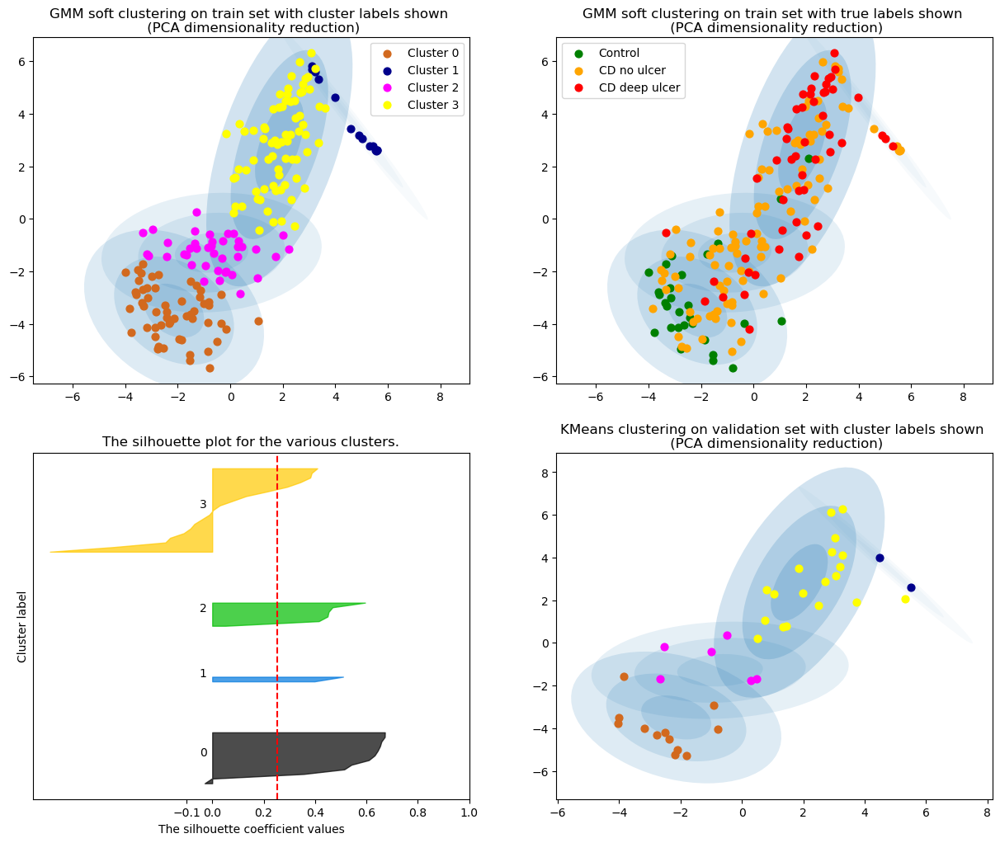

The average silhouette_score is : 0.25240332
Accuracy: 0.1794871794871795
F1 score: 0.15661136249371546
Perplexity = 100
[3 1 3 1 0 0 1 1 1 1 1 2 3 1 1 2 3 1 3 1 3 0 1 3 1 0 1 3 3 0 1 0 0 0 3 0 3
 0 1 0 1 1 1 1 1 0 0 3 0 1 1 1 1 0 0 3 0 1 0 0 1 0 1 1 0 2 0 3 0 1 0 0 3 3
 3 0 0 1 1 1 1 1 1 1 1 0 0 1 0 1 0 3 0 1 1 0 0 3 1 3 1 1 3 1 2 0 1 0 0 1 1
 1 0 0 0 1 0 1 0 3 2 1 3 1 3 1 2 1 3 1 1 1 1 1 1 0 2 1 1 2 1 3 3 1 1 1 3 0
 1 0 1 1 0 0 0 1 0 3 3 1 1 0 3 3 0 1 0 1 1 3 3 3 0 3 1 3 3 2 1 3 0 0]
num_clusters 4
num_clusters 3


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:88: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[gmm_val_labels==i, 0], X_val[gmm_val_labels==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing th

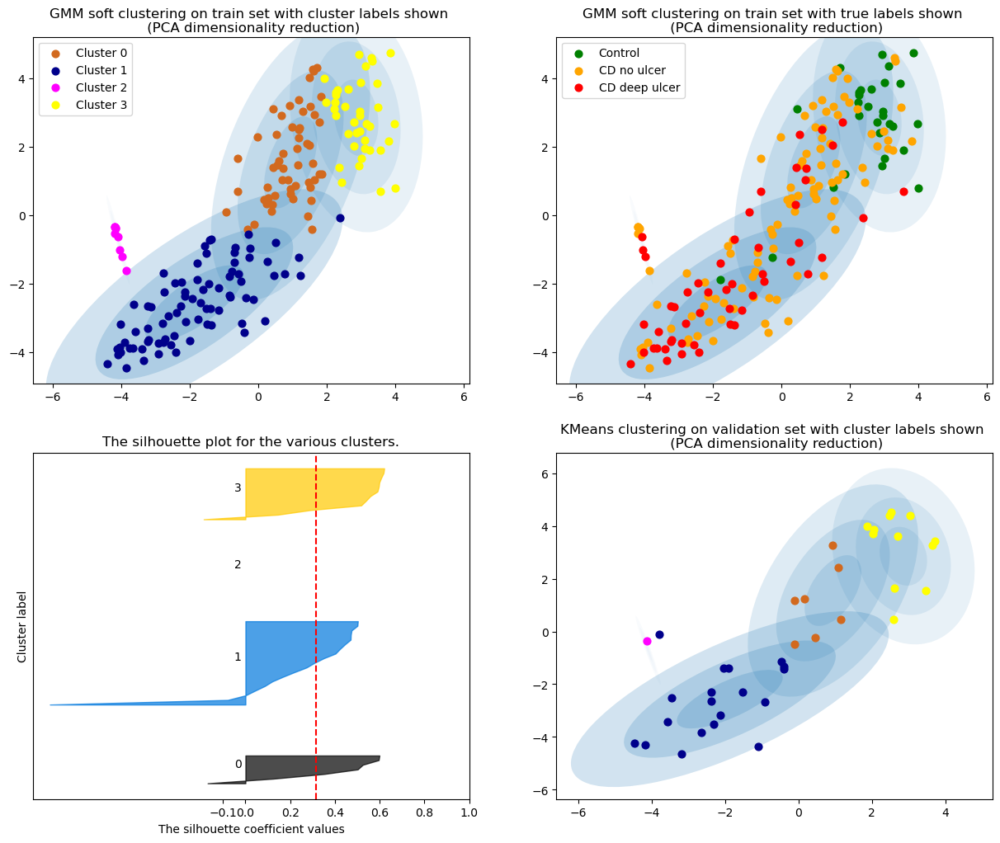

The average silhouette_score is : 0.31593433
Accuracy: 0.28205128205128205
F1 score: 0.3225092605955645
Perplexity = 110
[0 2 3 2 0 2 2 2 0 2 1 1 3 2 2 1 3 2 3 2 3 3 1 3 2 3 2 3 3 3 2 0 2 0 3 0 3
 3 2 0 2 2 1 2 2 0 0 3 3 2 1 2 2 0 0 3 3 2 0 3 2 0 2 2 0 1 0 3 3 2 0 0 3 3
 3 0 3 2 2 2 1 2 1 2 2 0 3 2 3 2 3 3 0 2 2 3 0 0 0 3 2 2 0 2 1 0 2 3 0 2 2
 2 3 0 0 2 3 2 0 3 1 2 3 2 3 2 1 2 3 2 2 2 2 2 2 0 1 2 2 1 2 3 0 2 2 2 3 3
 2 3 2 2 0 3 0 2 0 3 0 2 2 0 3 3 0 2 3 2 2 3 3 3 0 3 3 3 3 1 2 3 2 0]
num_clusters 4
num_clusters 3


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:88: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[gmm_val_labels==i, 0], X_val[gmm_val_labels==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing th

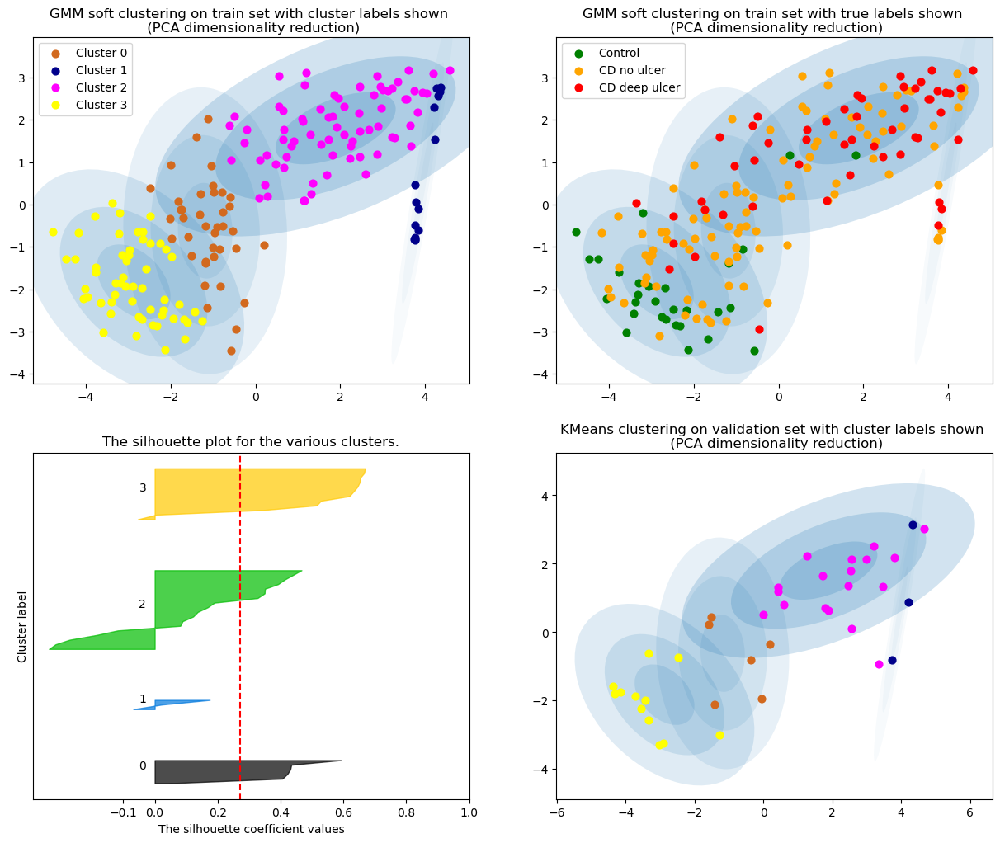

The average silhouette_score is : 0.27260798
Accuracy: 0.23076923076923078
F1 score: 0.20923076923076925
Perplexity = 120
[0 1 3 1 0 0 1 1 0 1 1 2 3 1 1 2 3 1 3 1 3 0 2 3 1 0 1 3 0 0 1 0 1 0 3 0 3
 0 1 0 1 1 2 1 1 0 0 3 0 1 2 1 1 0 0 3 0 1 0 0 1 0 1 1 0 2 0 3 0 1 0 0 3 3
 3 0 0 1 1 1 2 1 2 1 1 0 3 1 0 1 3 0 0 1 1 3 0 3 0 3 1 0 3 1 2 0 1 3 0 1 1
 1 3 0 3 1 0 1 0 3 2 1 3 1 3 1 2 1 3 1 2 1 1 1 1 0 2 1 1 2 1 3 3 1 1 1 3 0
 1 0 1 1 0 0 0 1 0 0 3 1 1 0 3 3 0 1 0 1 1 3 3 3 0 3 0 3 3 2 1 3 1 0]
num_clusters 4
num_clusters 3


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:88: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[gmm_val_labels==i, 0], X_val[gmm_val_labels==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing th

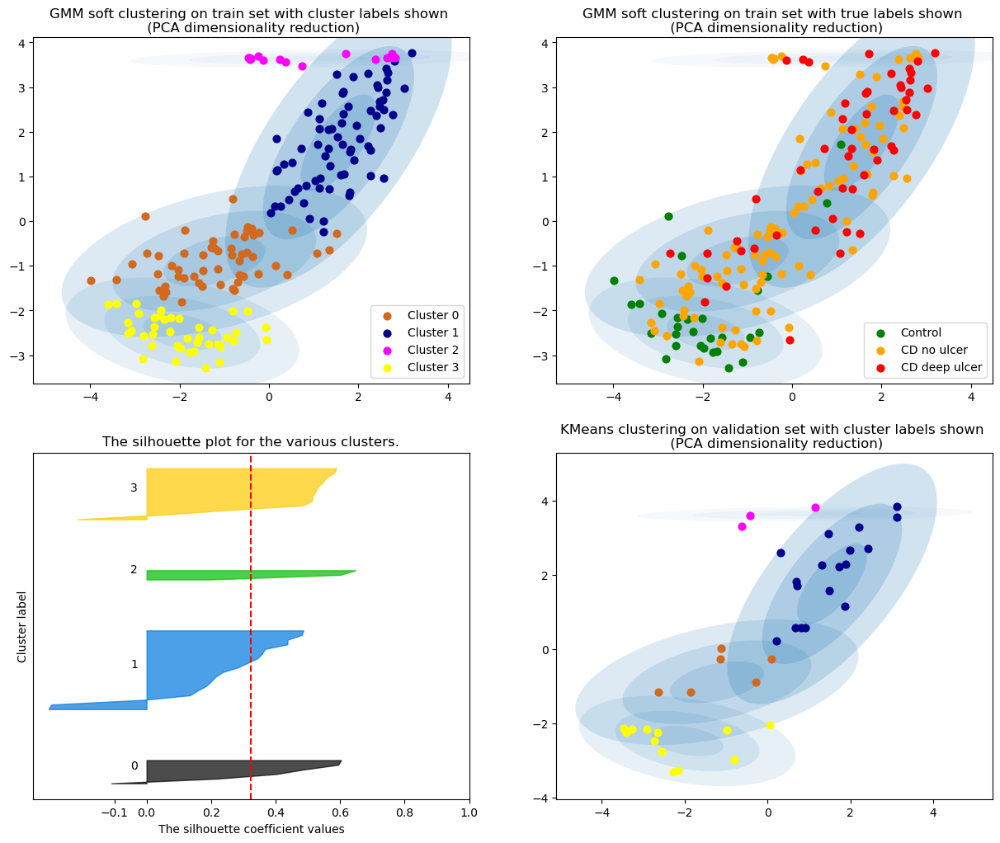

The average silhouette_score is : 0.322806
Accuracy: 0.2564102564102564
F1 score: 0.2948717948717949
Perplexity = 130
[0 1 3 1 0 1 1 1 1 1 2 2 3 1 1 2 3 1 3 1 3 0 2 3 1 0 1 3 0 0 1 0 1 0 3 0 3
 0 1 0 1 1 2 1 1 0 0 3 0 1 2 1 1 0 0 3 0 1 0 0 1 0 1 2 0 2 0 3 0 1 1 0 3 3
 3 0 0 1 1 1 2 1 2 1 1 0 3 1 0 1 3 3 0 1 1 3 0 0 1 3 1 1 0 1 2 0 1 3 0 1 1
 1 3 0 0 1 0 1 0 3 2 1 3 1 3 1 2 1 3 1 2 1 1 1 1 0 2 1 1 2 1 3 0 1 1 1 3 0
 1 0 1 1 0 0 0 1 0 0 3 1 1 0 3 3 0 1 0 1 1 3 3 3 0 3 0 3 3 2 1 3 1 0]
num_clusters 4
num_clusters 3


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:88: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[gmm_val_labels==i, 0], X_val[gmm_val_labels==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing th

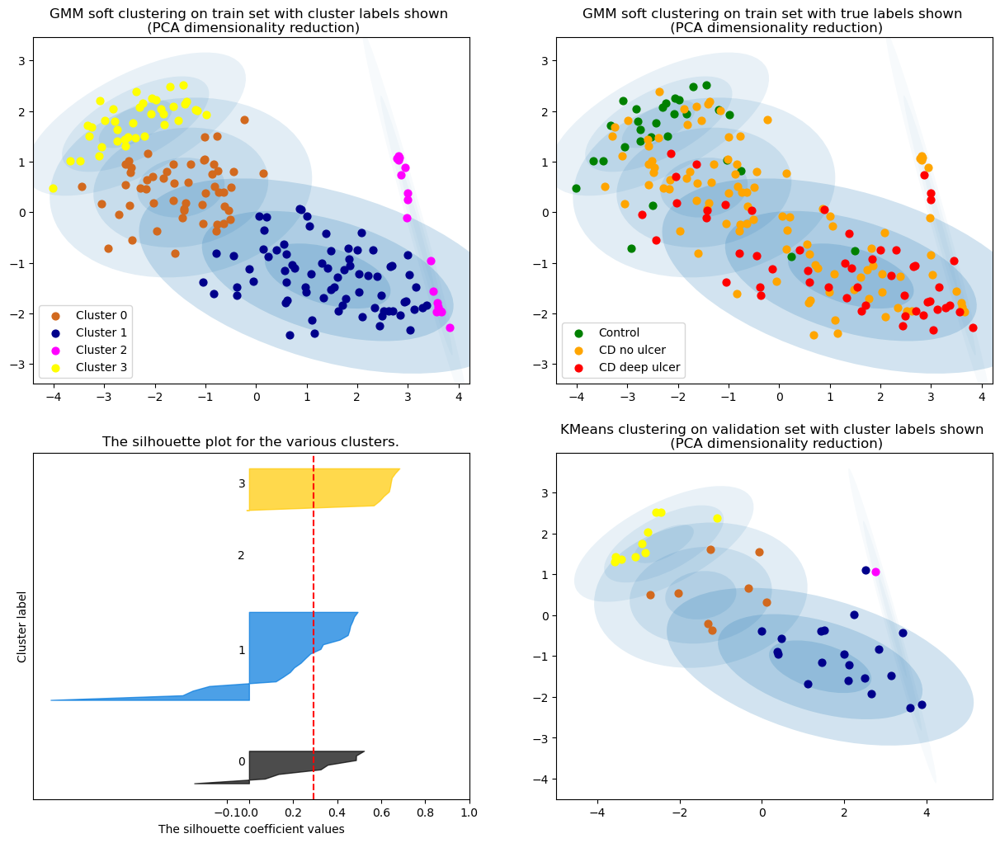

The average silhouette_score is : 0.29438257
Accuracy: 0.3076923076923077
F1 score: 0.3428195735888044
Perplexity = 140
[0 2 3 2 0 2 2 2 0 2 1 1 3 2 2 1 3 2 3 2 3 3 1 3 2 3 2 3 3 3 2 0 2 0 3 0 3
 3 2 0 2 2 1 2 2 0 0 3 3 2 1 2 2 0 0 3 3 2 0 3 2 0 2 1 0 1 0 3 3 2 0 0 3 3
 3 0 0 2 2 2 1 2 1 2 2 0 3 2 3 2 3 3 0 2 2 3 0 0 0 3 2 2 0 2 1 0 2 3 0 2 2
 2 3 0 0 2 3 2 0 3 1 2 3 2 3 2 1 2 3 2 1 2 2 2 2 0 1 2 2 1 2 3 0 2 2 2 3 3
 2 3 2 2 0 3 0 2 0 3 0 2 2 0 3 3 0 2 3 2 2 3 3 3 0 3 3 3 3 1 2 3 2 0]
num_clusters 4
num_clusters 3


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:88: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[gmm_val_labels==i, 0], X_val[gmm_val_labels==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing th

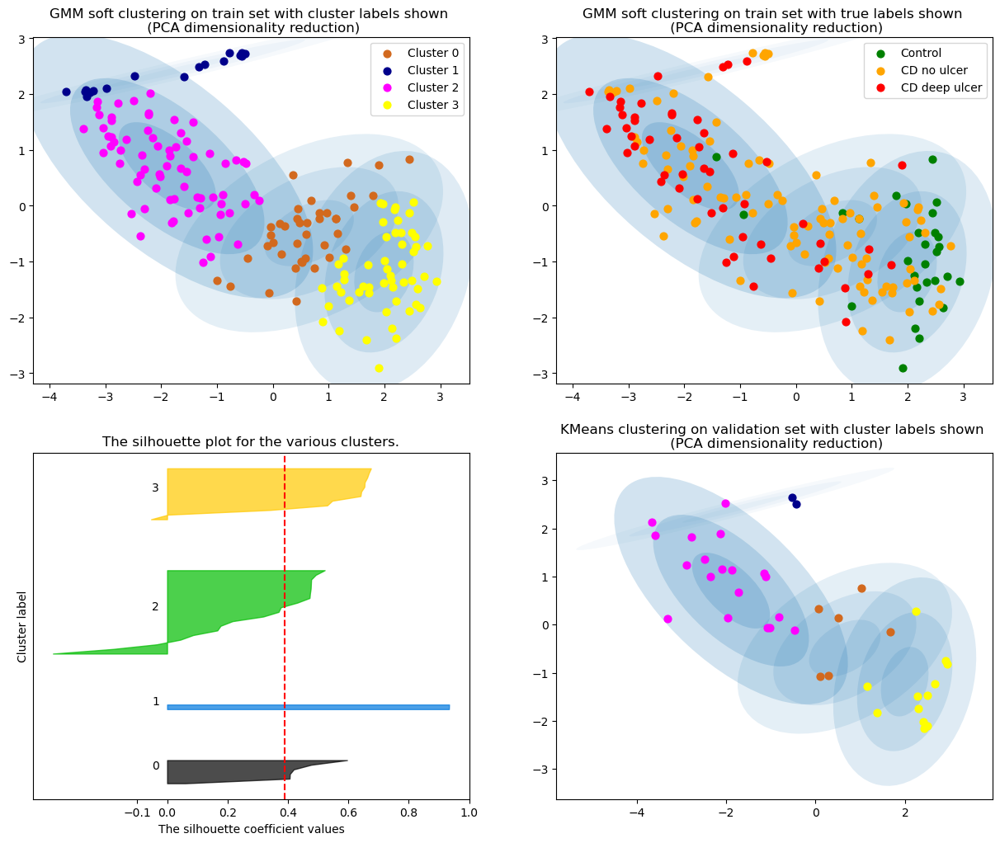

The average silhouette_score is : 0.38903776
Accuracy: 0.2564102564102564
F1 score: 0.22566859663633862
Perplexity = 150
[0 2 3 2 0 0 2 2 0 2 2 1 3 2 2 1 3 2 3 2 3 3 2 3 2 3 2 3 3 3 2 0 2 0 3 0 3
 0 2 0 2 2 2 2 2 0 0 3 3 2 2 2 2 0 0 3 3 2 0 3 2 0 2 2 0 1 0 3 0 2 0 0 3 3
 3 0 0 2 2 2 2 2 2 2 2 0 3 2 3 2 3 3 0 2 2 3 0 0 0 3 2 2 0 2 1 0 2 3 0 2 2
 2 3 0 0 2 3 2 0 3 1 2 3 2 3 2 1 2 0 2 2 2 2 2 2 0 1 2 2 1 2 3 0 2 2 2 3 3
 2 3 2 2 0 0 0 2 0 3 0 2 2 0 0 3 0 2 3 2 2 3 3 3 0 3 3 3 3 1 2 3 2 0]
num_clusters 4
num_clusters 3


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:88: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[gmm_val_labels==i, 0], X_val[gmm_val_labels==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing th

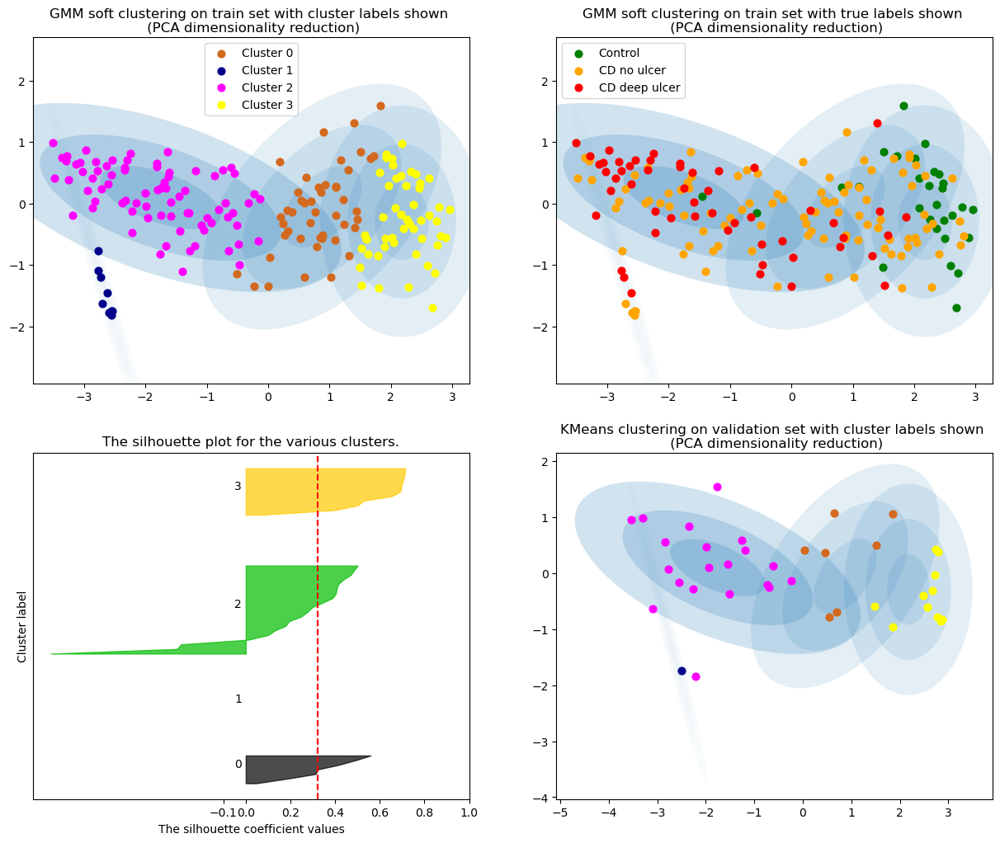

The average silhouette_score is : 0.3213659
Accuracy: 0.2564102564102564
F1 score: 0.19444444444444448
Perplexity = 160
[3 1 3 1 0 1 1 1 1 1 2 2 3 1 1 2 3 1 3 1 3 3 2 3 1 0 1 3 0 0 1 0 1 0 3 0 3
 0 1 0 1 1 2 1 1 0 0 3 0 1 2 1 1 0 0 3 3 1 0 0 1 0 1 2 0 2 0 3 0 1 1 0 3 3
 3 0 0 1 1 1 2 1 2 1 1 0 3 1 3 1 3 3 0 1 1 3 0 3 1 3 1 1 0 1 2 0 1 3 0 1 1
 1 3 0 0 1 0 1 0 3 2 1 3 1 3 1 2 1 3 1 2 1 1 1 1 0 2 1 1 2 1 3 0 1 1 1 3 0
 1 0 1 1 0 0 0 1 0 0 3 1 1 0 3 3 1 1 0 1 1 3 3 3 0 3 0 3 3 2 1 3 1 1]
num_clusters 4
num_clusters 3


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:88: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[gmm_val_labels==i, 0], X_val[gmm_val_labels==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing th

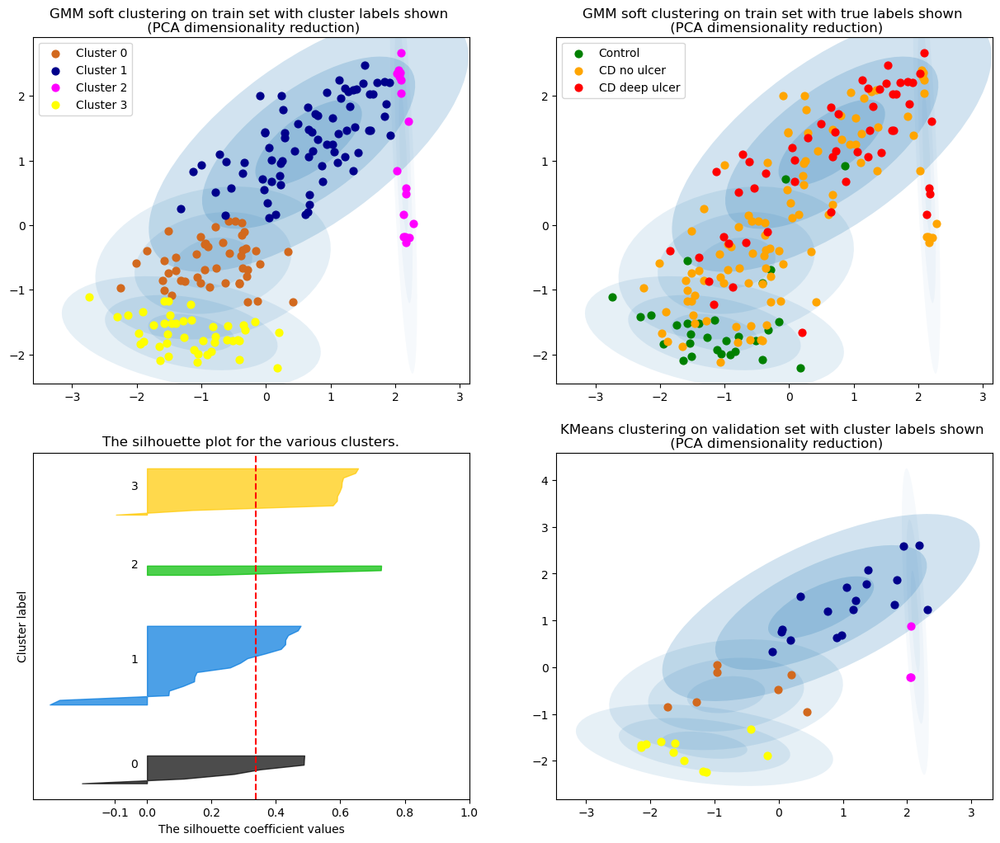

The average silhouette_score is : 0.33769095
Accuracy: 0.2564102564102564
F1 score: 0.2948717948717949
Perplexity = 170
[0 2 3 2 0 0 2 2 0 2 2 1 3 2 2 2 3 2 3 2 3 3 2 3 2 3 2 3 3 3 2 0 2 0 3 0 3
 0 2 0 2 2 2 2 2 0 0 3 3 2 2 2 2 0 0 3 3 2 0 3 2 0 2 2 0 1 0 3 3 2 0 0 3 3
 3 0 0 2 2 2 2 2 2 2 2 0 3 2 3 2 3 3 0 2 2 3 0 0 0 3 2 0 0 2 1 0 2 3 0 2 2
 2 3 0 0 2 3 2 0 3 1 2 3 2 3 2 1 2 0 2 2 2 2 2 2 0 1 2 2 1 2 3 0 2 0 2 3 3
 2 3 2 2 0 0 0 2 0 3 0 2 2 0 0 3 0 2 3 2 2 3 3 3 0 3 3 3 3 1 2 3 2 0]
num_clusters 4
num_clusters 3


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:88: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[gmm_val_labels==i, 0], X_val[gmm_val_labels==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing th

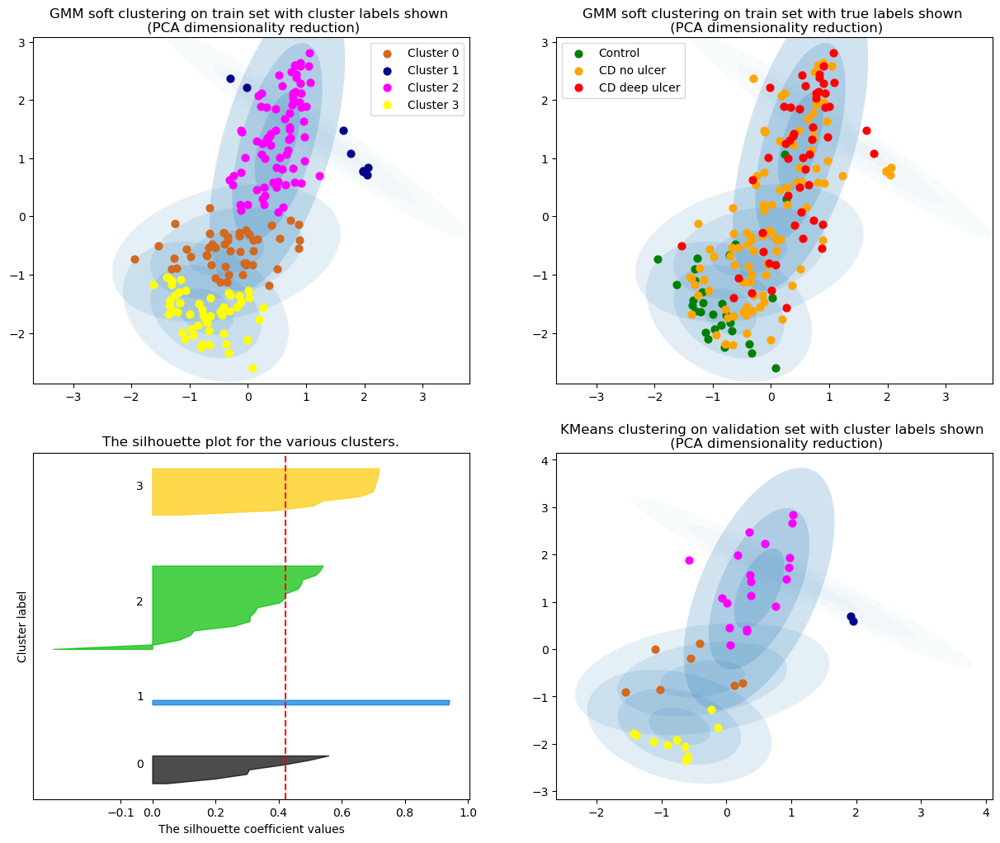

The average silhouette_score is : 0.42186165
Accuracy: 0.28205128205128205
F1 score: 0.24703611800386
Perplexity = 180
[3 1 3 1 0 1 1 1 1 1 2 2 3 1 1 2 3 1 3 1 3 3 2 3 1 0 1 3 0 0 1 0 1 0 3 0 3
 0 1 0 1 1 2 1 1 0 0 3 0 1 2 1 1 0 0 3 0 1 0 0 1 0 1 2 0 2 0 3 0 1 1 0 3 3
 3 0 0 1 1 1 2 1 2 1 1 0 3 1 0 1 3 3 0 1 1 3 0 3 1 3 1 1 0 1 2 0 1 3 0 1 1
 1 3 0 0 1 0 1 0 3 2 1 3 1 3 1 2 1 3 1 2 1 1 1 1 0 2 1 1 2 1 3 0 1 1 1 3 0
 1 0 1 1 0 0 0 1 0 0 3 1 1 0 3 3 1 1 0 1 1 3 3 3 0 3 0 3 3 2 1 3 1 1]
num_clusters 4
num_clusters 3


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:88: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[gmm_val_labels==i, 0], X_val[gmm_val_labels==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing th

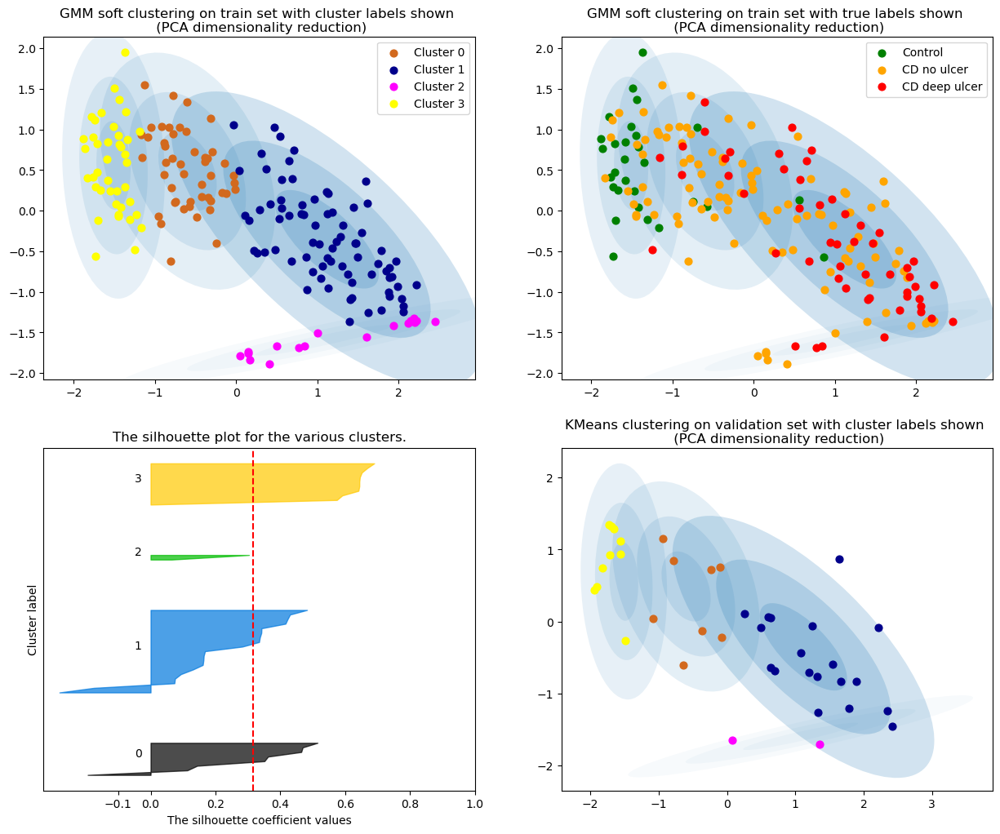

The average silhouette_score is : 0.3152938
Accuracy: 0.28205128205128205
F1 score: 0.3191280264450996
Perplexity = 190
[0 2 3 2 0 0 1 2 0 1 1 2 3 1 2 2 3 2 3 2 3 3 1 3 1 3 2 3 3 3 1 0 2 0 3 0 3
 3 1 0 1 2 1 1 2 0 0 3 3 2 1 2 2 0 0 3 3 1 2 3 2 0 1 1 0 2 0 0 3 2 0 0 0 3
 3 0 0 2 2 2 1 1 1 1 2 0 3 2 3 1 3 3 0 1 1 3 0 0 0 3 1 0 0 1 2 0 2 3 0 2 2
 1 3 0 0 1 3 1 0 3 2 1 3 1 3 1 2 1 0 2 1 1 1 1 2 0 2 1 2 2 2 3 0 2 2 1 3 3
 2 3 1 1 0 0 0 1 0 3 0 1 1 0 0 3 0 1 3 1 1 3 3 0 0 3 3 3 3 2 2 0 2 0]
num_clusters 4
num_clusters 3


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:88: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[gmm_val_labels==i, 0], X_val[gmm_val_labels==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing th

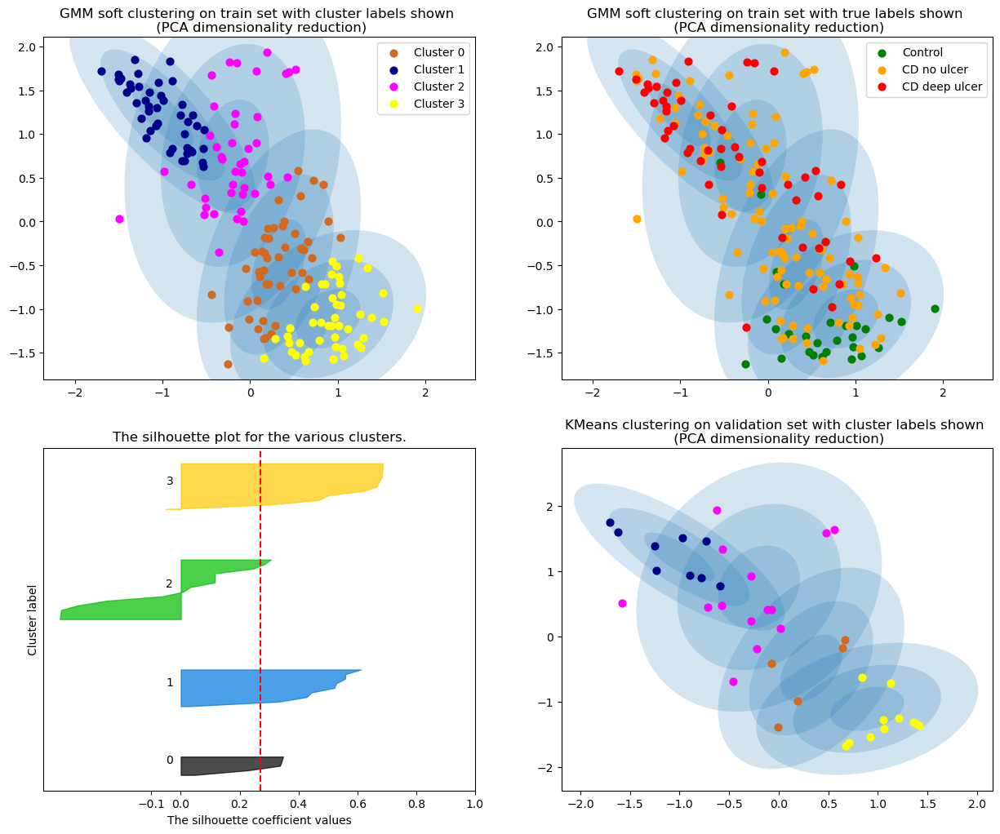

The average silhouette_score is : 0.27104875
Accuracy: 0.2564102564102564
F1 score: 0.2895590761595724
Perplexity = 200
[3 1 3 1 0 0 1 1 0 1 2 2 3 1 1 2 3 1 3 1 3 3 2 3 1 3 1 3 3 3 1 0 1 0 3 0 3
 3 1 0 1 1 2 1 1 0 0 3 3 1 2 1 1 0 0 3 3 1 0 3 1 0 1 2 0 2 0 3 0 1 0 0 3 3
 3 0 0 1 1 1 2 1 2 1 1 0 3 1 3 1 3 3 0 1 1 3 0 0 0 3 1 0 0 1 2 0 1 3 0 1 1
 1 3 0 0 1 3 1 0 3 2 1 3 1 3 1 2 1 3 1 2 1 1 1 1 0 2 1 1 2 1 3 0 1 1 1 3 3
 1 3 1 1 0 0 0 1 0 3 0 1 1 0 3 3 0 2 3 1 1 3 3 3 0 3 3 3 3 2 1 3 1 0]
num_clusters 4
num_clusters 3


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:88: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[gmm_val_labels==i, 0], X_val[gmm_val_labels==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing th

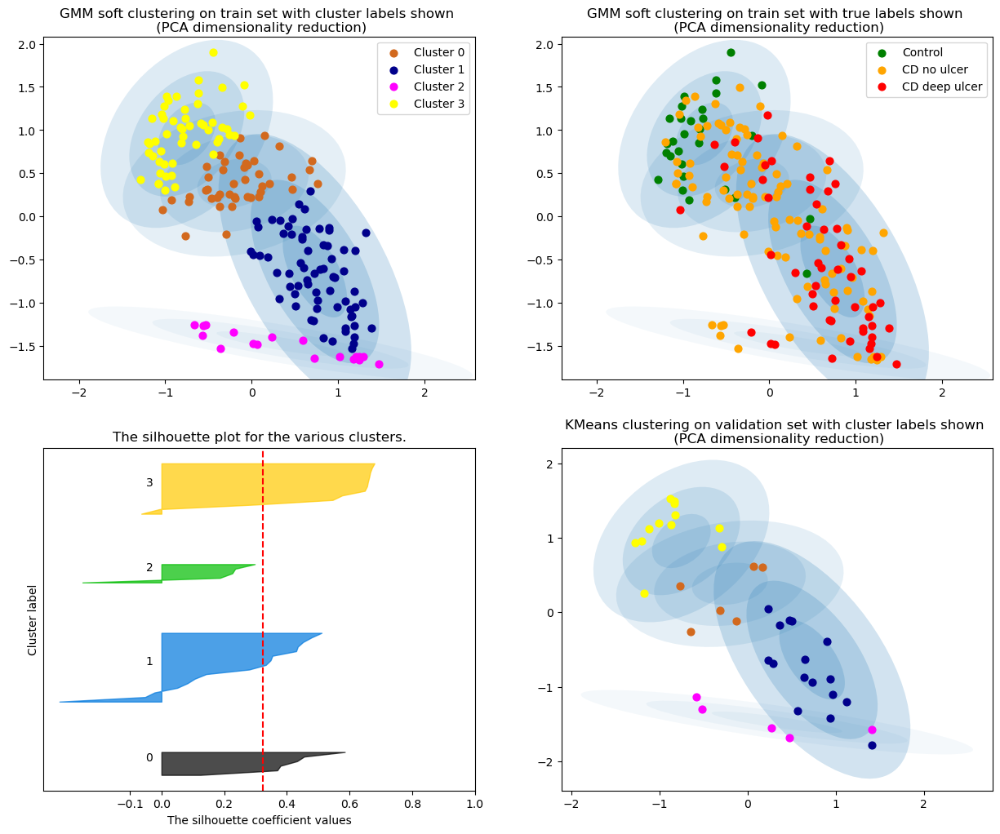

The average silhouette_score is : 0.32390288
Accuracy: 0.2564102564102564
F1 score: 0.3099150591410654
Perplexity = 210
[3 2 3 2 0 2 2 2 0 2 1 1 3 2 2 1 3 2 3 2 3 3 1 3 2 3 2 3 3 3 2 0 2 0 3 0 3
 0 2 0 2 2 1 2 2 0 0 3 3 2 1 2 2 0 0 3 3 2 0 3 2 0 2 1 0 1 0 0 0 2 0 0 3 3
 3 0 0 2 2 2 1 2 1 2 2 0 3 2 3 2 3 3 0 2 2 3 0 0 0 3 2 2 0 2 1 0 2 3 0 2 2
 2 3 0 0 2 3 2 0 3 1 2 3 2 3 2 1 2 0 2 1 2 2 2 2 0 1 2 2 1 2 3 0 2 2 2 3 3
 2 3 2 2 0 0 0 2 0 3 0 2 2 0 0 3 0 1 3 2 2 3 3 0 0 3 3 3 3 1 2 0 2 0]
num_clusters 4
num_clusters 3


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:88: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[gmm_val_labels==i, 0], X_val[gmm_val_labels==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing th

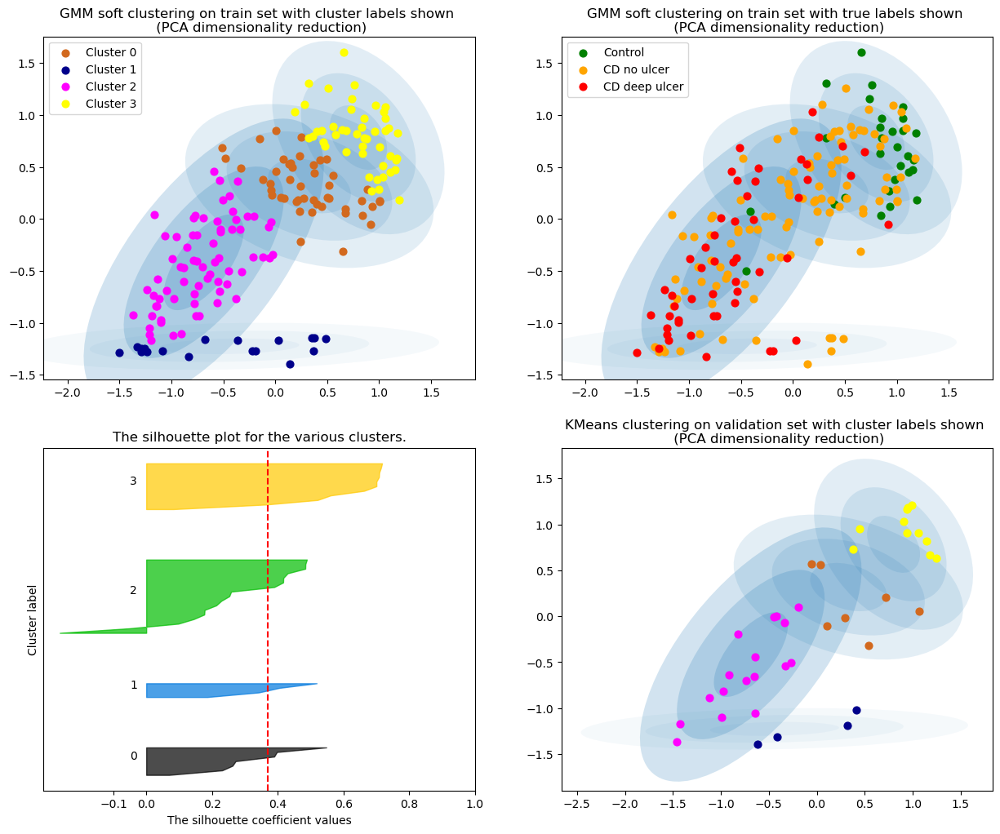

The average silhouette_score is : 0.36921626
Accuracy: 0.3333333333333333
F1 score: 0.34252646852116353
Perplexity = 220
[0 1 3 1 0 1 1 1 1 1 1 2 0 1 1 2 3 1 0 1 3 3 2 3 1 3 1 0 3 3 1 1 1 0 0 1 3
 3 1 3 1 1 1 1 1 1 3 3 3 1 2 1 1 1 0 3 3 1 0 3 1 1 1 1 0 2 0 0 3 1 1 1 0 3
 0 0 0 1 1 1 2 1 2 1 1 0 3 1 3 1 3 3 3 1 1 3 0 0 1 3 1 1 0 1 2 0 1 3 1 1 1
 1 3 1 0 1 3 1 0 3 2 1 0 1 3 1 2 1 0 1 1 1 1 1 1 1 2 1 1 2 1 3 0 1 1 1 3 3
 1 3 1 1 3 3 1 1 3 3 0 1 1 0 0 3 1 2 3 1 1 3 3 0 0 0 3 3 3 2 1 0 1 1]
num_clusters 4
num_clusters 3


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:88: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[gmm_val_labels==i, 0], X_val[gmm_val_labels==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing th

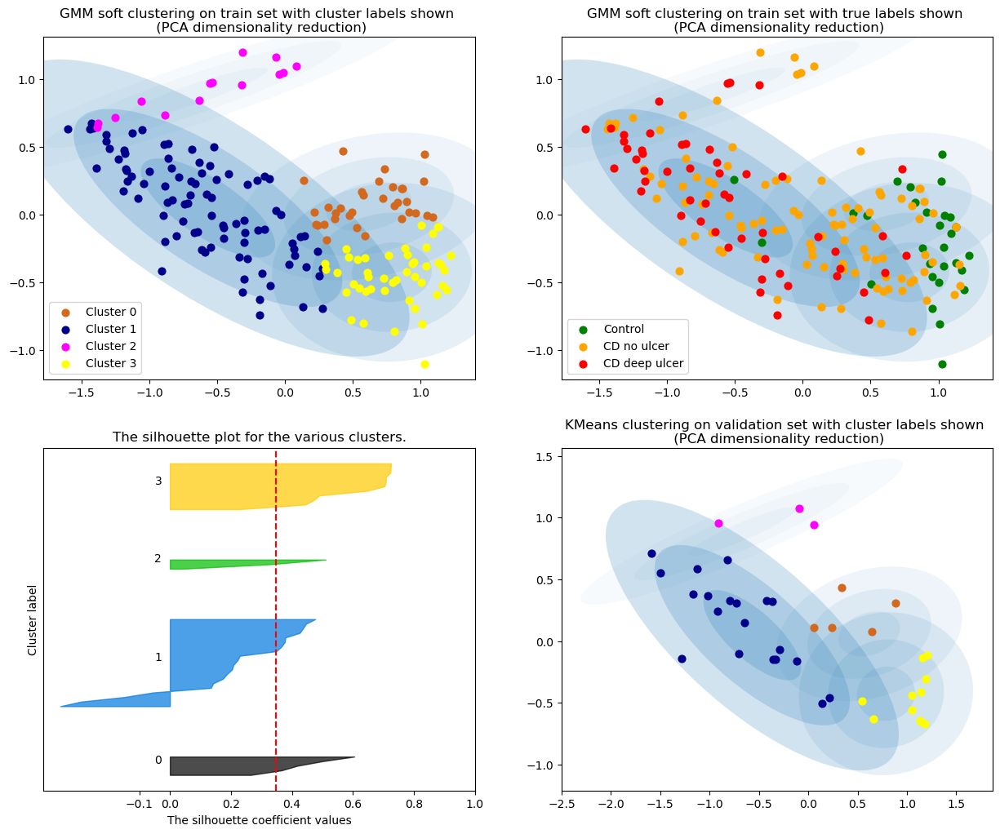

The average silhouette_score is : 0.34634486
Accuracy: 0.3076923076923077
F1 score: 0.33528693528693526
Perplexity = 230
[3 2 3 2 0 2 2 2 2 2 2 1 3 2 2 1 3 2 3 2 3 3 1 3 2 3 2 3 3 0 2 0 2 0 3 0 3
 0 2 0 2 2 2 2 2 0 0 3 3 2 1 2 2 0 0 3 3 2 0 3 2 0 2 2 0 1 0 0 0 2 2 0 0 3
 3 0 0 2 2 2 2 2 2 2 2 0 3 2 3 2 3 3 0 2 2 3 0 0 0 3 2 2 0 2 1 0 2 3 0 2 2
 2 3 0 0 2 3 2 0 3 1 2 3 2 3 2 1 2 0 2 2 2 2 2 2 0 1 2 2 1 2 3 0 2 2 2 3 3
 2 3 2 2 0 0 0 2 0 3 0 2 2 0 0 3 0 1 3 2 2 3 3 0 0 3 3 3 3 1 2 0 2 0]
num_clusters 4
num_clusters 3


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:88: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[gmm_val_labels==i, 0], X_val[gmm_val_labels==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing th

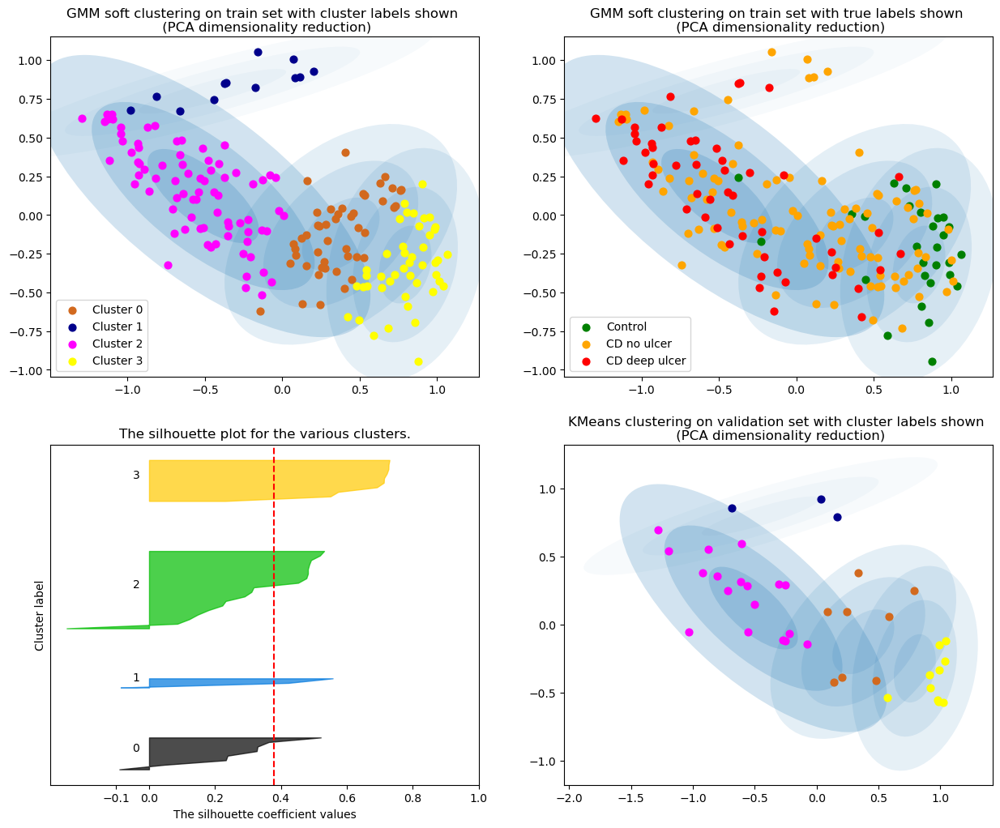

The average silhouette_score is : 0.37971804
Accuracy: 0.3076923076923077
F1 score: 0.2945956607495069
Perplexity = 240
[0 2 3 2 0 2 1 2 2 1 1 2 3 1 2 2 3 2 0 2 3 3 1 3 1 3 2 0 3 3 1 3 2 0 0 0 3
 3 2 3 1 2 1 1 2 0 3 3 3 1 1 2 2 3 0 3 3 1 2 3 2 3 1 1 0 2 0 0 3 2 2 0 0 3
 0 0 3 2 2 2 1 2 1 1 1 0 3 2 3 1 3 3 3 1 1 3 0 0 2 3 1 2 0 1 2 0 2 3 0 2 2
 1 3 0 0 1 3 1 0 3 2 2 0 1 3 1 2 1 0 2 1 1 1 1 2 0 2 1 2 2 2 3 0 2 2 1 3 3
 2 3 1 1 3 3 0 1 3 3 0 2 1 0 0 3 0 2 3 1 1 3 3 0 0 3 3 3 3 2 2 0 2 3]
num_clusters 4
num_clusters 3


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:88: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[gmm_val_labels==i, 0], X_val[gmm_val_labels==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing th

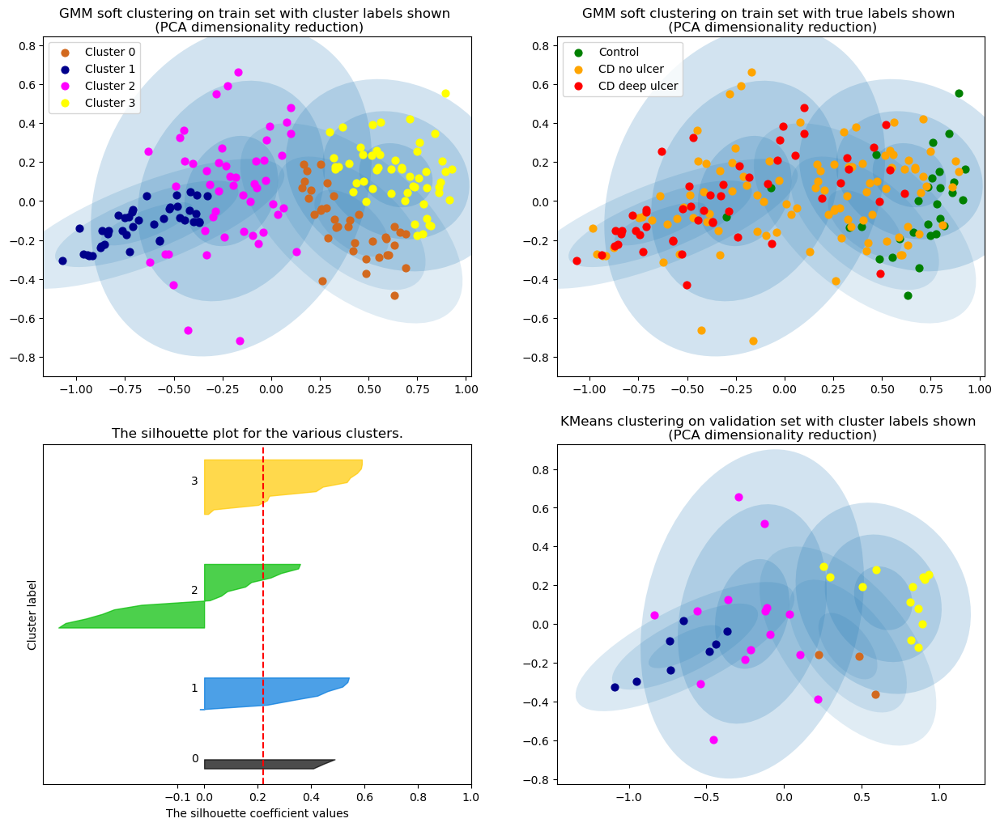

The average silhouette_score is : 0.2224598
Accuracy: 0.23076923076923078
F1 score: 0.2588319088319088
Perplexity = 250
[3 1 3 1 3 1 1 1 1 1 1 2 0 1 1 2 0 1 0 1 0 3 2 0 1 3 1 0 3 3 1 3 3 3 0 3 0
 3 1 3 1 1 1 1 1 3 3 0 3 1 1 1 3 3 3 0 3 1 3 3 1 3 1 1 3 2 3 0 3 3 1 3 0 0
 0 3 3 1 1 1 1 1 1 1 1 3 3 1 3 1 0 3 3 1 1 0 3 0 1 3 1 1 0 1 2 3 1 0 3 1 1
 1 0 3 0 1 3 1 3 0 2 1 0 1 0 1 2 1 0 1 1 1 1 1 1 3 2 1 1 2 3 0 0 1 1 1 0 3
 1 3 1 1 3 3 3 1 3 3 0 1 1 3 0 0 3 2 3 1 1 0 0 0 3 0 3 0 0 2 1 0 3 1]
num_clusters 4
num_clusters 3


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:88: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[gmm_val_labels==i, 0], X_val[gmm_val_labels==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing th

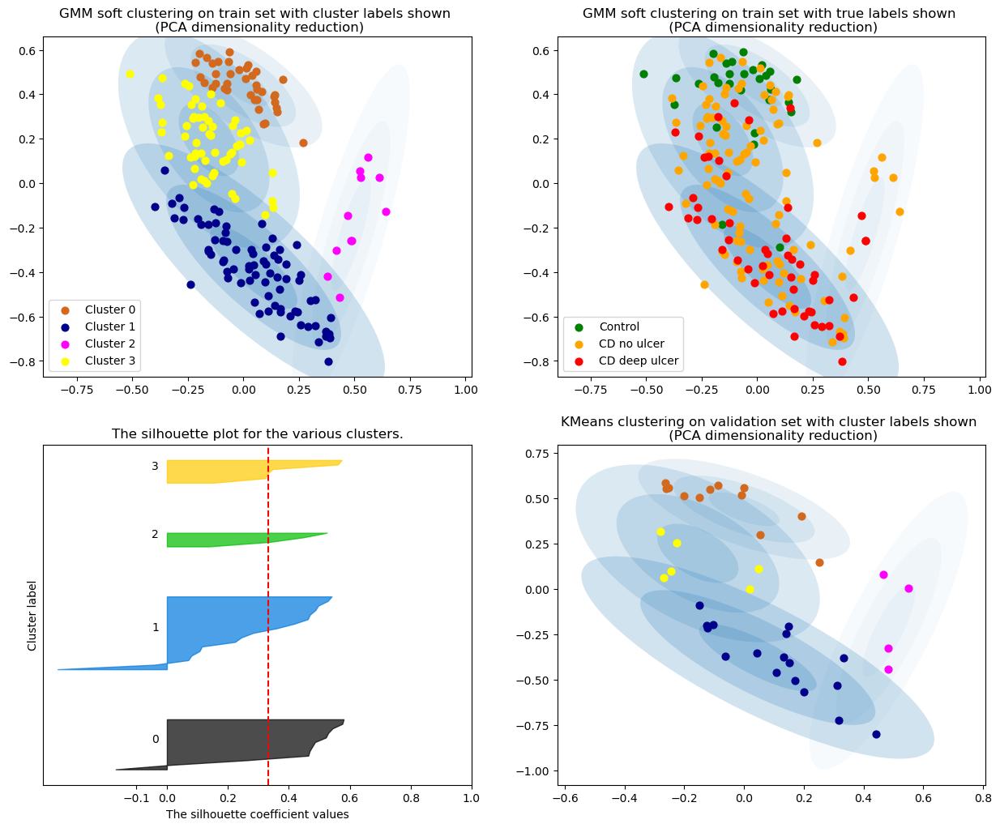

The average silhouette_score is : 0.33292
Accuracy: 0.358974358974359
F1 score: 0.3453030127238272


In [57]:

# perplexities = [10, 20, 50, 70]
# perplexities = [10, 20, 50, 70, 100, 150, 200, 250]
perplexities = np.arange(0, 251, 10)[1:]
sil_scores = []
acc_scores = []
f1_scores = []

# perplexity = 24
for perplexity in perplexities:
    gmm_pca, X_train_pca, X_test_pca, X_val_pca = fit_gmm(full_pca_dataset, perplexity, num_c)
    print("Perplexity =",perplexity)
    sil, acc, f1 = plot_gmm(gmm_pca, X_train_pca, X_val_pca, train_disease_labels, "PCA", num_c=num_c, plot_sil=True)
    sil_scores.append(sil)
    acc_scores.append(acc)
    f1_scores.append(f1)
    


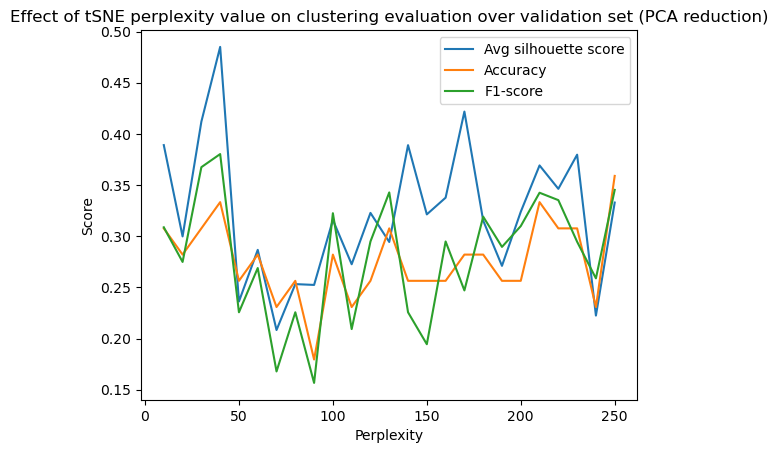

In [58]:
plot_val_scores(sil_scores, acc_scores, f1_scores, "PCA")

#### Testing

[1 0 2 2 3 0 1 2 3 2 2 2 1 1 0 1 3 3 0 1 1 1 1 0 1 1 1 0 2 2 2 1 3 3 0 1 0
 1 2]
num_clusters 4
num_clusters 3


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,


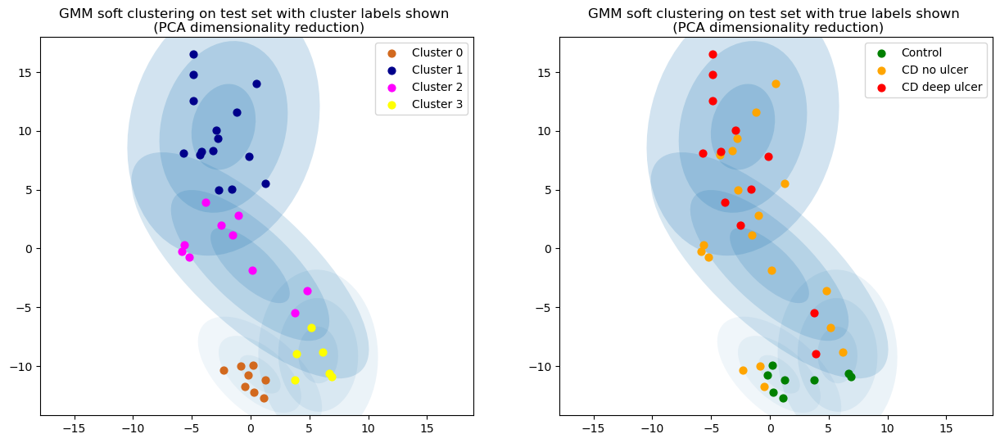

In [59]:
perplexity = 40
gmm_pca, X_train_pca, X_test_pca, X_val_pca = fit_gmm(full_pca_dataset, perplexity, num_c)
gmm_labels_pca = plot_gmm(gmm_pca, X_test_pca, X_val_pca, test_disease_labels, "PCA", num_c=num_c, test=True)


### Fit GMM with autoencoder dimensionality reduction

#### Training

In [60]:
# X_train_ae

Perplexity = 10
[0 3 2 3 0 3 3 3 3 1 1 1 2 3 3 1 2 3 2 3 2 0 1 0 3 0 3 2 0 0 3 0 3 0 2 0 2
 0 3 0 3 3 1 1 3 0 0 2 0 3 1 3 3 0 0 2 0 3 0 0 3 0 3 3 0 1 0 2 0 3 0 0 0 2
 2 0 0 3 3 3 1 3 1 1 3 0 2 3 0 3 2 0 0 3 3 2 0 0 3 2 3 3 0 1 1 0 3 2 0 3 3
 3 2 0 0 3 0 3 0 0 1 3 2 3 2 3 1 3 2 3 1 3 3 3 3 0 1 3 3 1 3 2 0 3 3 3 2 0
 3 0 3 3 0 0 0 1 0 0 2 3 1 0 0 2 0 3 0 3 3 2 2 2 0 2 0 2 2 1 3 2 3 0]
num_clusters 4
num_clusters 3


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:88: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[gmm_val_labels==i, 0], X_val[gmm_val_labels==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing th

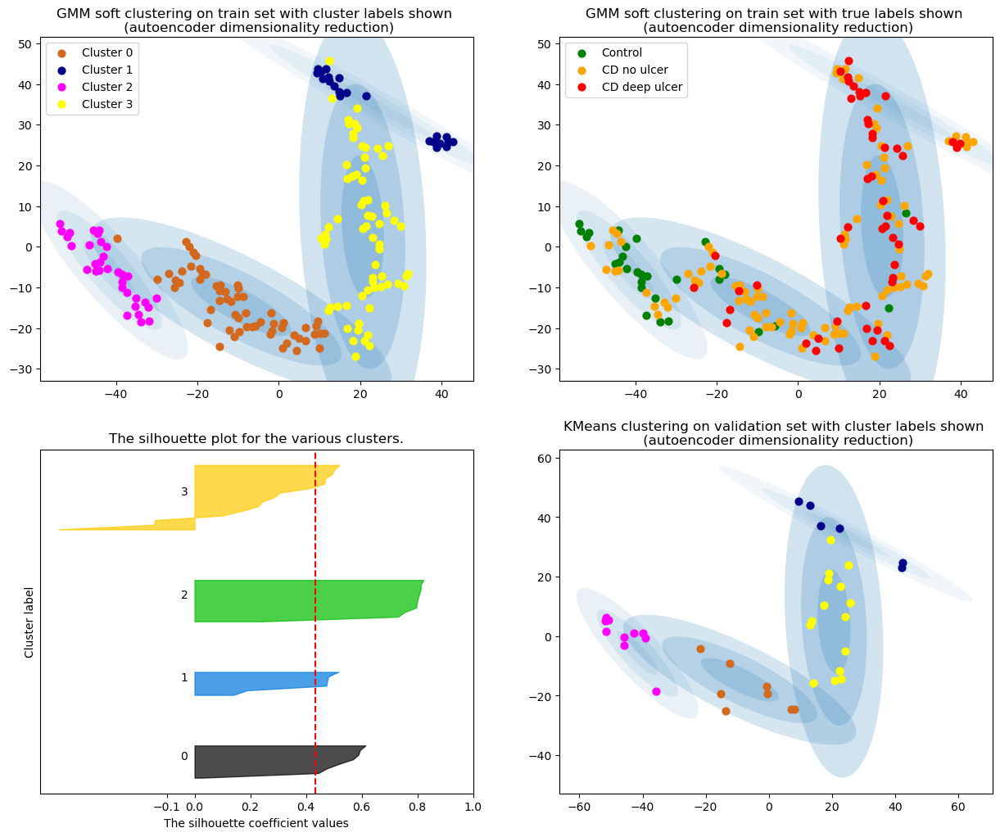

The average silhouette_score is : 0.4333287
Accuracy: 0.1282051282051282
F1 score: 0.18914418914418915
Perplexity = 20
[0 2 0 2 2 2 3 3 2 3 1 1 0 3 3 1 0 3 0 3 0 0 1 0 3 0 2 0 0 0 3 2 2 2 0 2 0
 0 3 2 3 2 1 1 2 2 2 0 0 3 1 3 3 2 2 0 0 3 2 0 2 2 3 3 2 1 2 0 2 3 2 2 0 0
 0 2 0 3 3 3 1 3 3 1 3 2 0 3 0 3 0 0 2 3 3 0 2 0 2 0 3 2 2 3 1 2 3 0 2 3 3
 3 0 2 2 3 0 3 2 0 1 3 0 3 0 3 1 3 0 3 1 3 3 3 2 2 1 3 3 1 3 0 2 3 2 3 0 0
 2 0 3 3 2 2 2 1 2 0 0 3 1 2 0 0 2 3 0 3 3 0 0 0 2 0 0 0 0 1 3 0 2 2]
num_clusters 4
num_clusters 3


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:88: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[gmm_val_labels==i, 0], X_val[gmm_val_labels==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing th

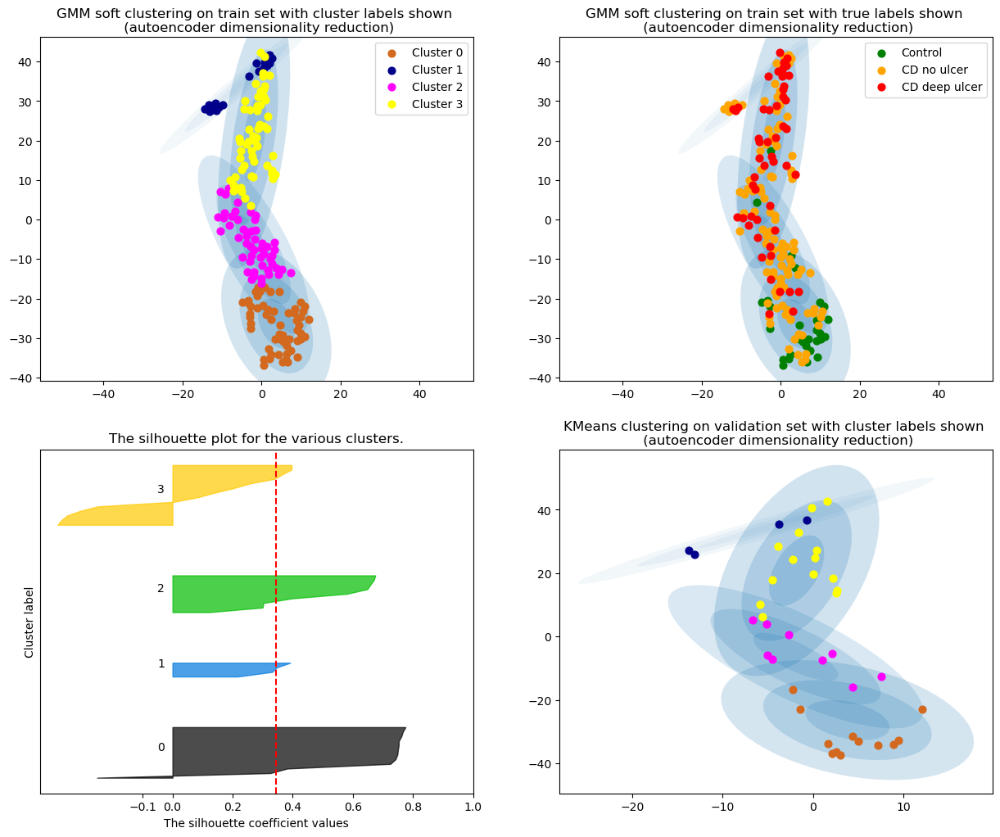

The average silhouette_score is : 0.3439068
Accuracy: 0.2564102564102564
F1 score: 0.2642003546980923
Perplexity = 30
[0 3 0 3 2 3 3 3 3 3 1 1 0 3 3 1 0 3 0 3 0 0 1 0 3 0 3 0 0 0 3 2 2 2 0 2 0
 2 3 2 3 3 1 1 3 2 2 0 0 3 1 3 3 2 2 0 0 3 2 0 3 2 3 1 2 1 2 0 2 3 2 2 0 0
 0 2 2 3 2 3 1 3 1 1 3 2 0 3 0 3 0 0 2 3 3 0 2 0 3 0 3 2 2 3 1 2 3 0 2 3 3
 3 0 2 2 3 2 3 2 0 1 3 0 3 0 3 1 3 0 3 1 3 3 3 2 2 1 3 3 1 3 0 2 3 3 3 0 0
 3 0 3 3 2 2 2 1 2 0 0 3 1 2 0 0 2 3 0 3 3 0 0 0 2 0 0 0 0 1 3 0 2 2]
num_clusters 4
num_clusters 3


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:88: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[gmm_val_labels==i, 0], X_val[gmm_val_labels==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing th

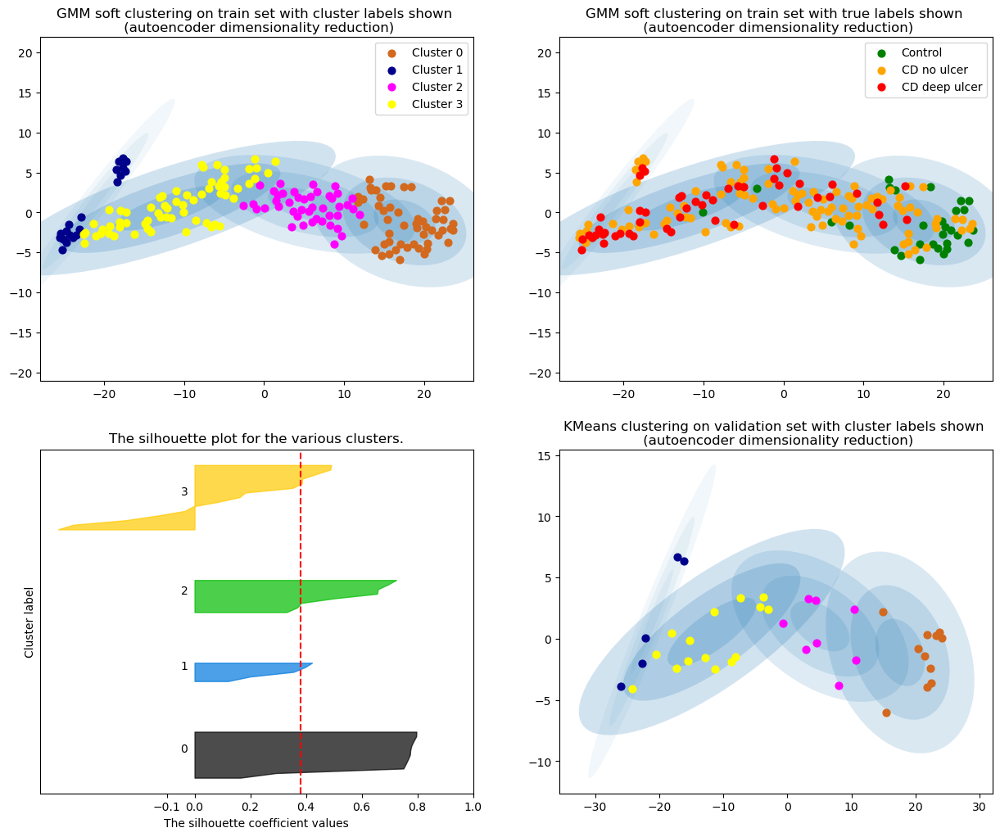

The average silhouette_score is : 0.38131148
Accuracy: 0.2564102564102564
F1 score: 0.2780389363722697
Perplexity = 40
[0 3 0 0 0 3 3 3 0 3 3 1 2 3 0 1 2 0 2 3 2 0 1 2 3 0 0 2 0 0 3 0 0 0 2 0 2
 0 3 0 3 3 3 3 0 0 0 2 0 3 3 0 0 0 0 2 0 3 0 0 3 0 3 3 0 1 0 2 0 0 0 0 0 2
 2 0 0 0 0 3 3 3 3 3 3 0 2 3 0 3 2 0 0 3 3 2 0 0 0 0 3 0 0 3 1 0 3 2 0 3 3
 3 2 0 0 3 0 3 0 2 1 3 2 3 2 3 1 3 2 0 3 3 3 3 0 0 1 3 3 1 0 2 0 3 0 3 2 0
 3 0 3 3 0 0 0 3 0 0 2 3 3 0 0 2 0 3 0 3 3 2 2 2 0 2 0 2 2 1 3 2 0 0]
num_clusters 4
num_clusters 3


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:88: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[gmm_val_labels==i, 0], X_val[gmm_val_labels==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing th

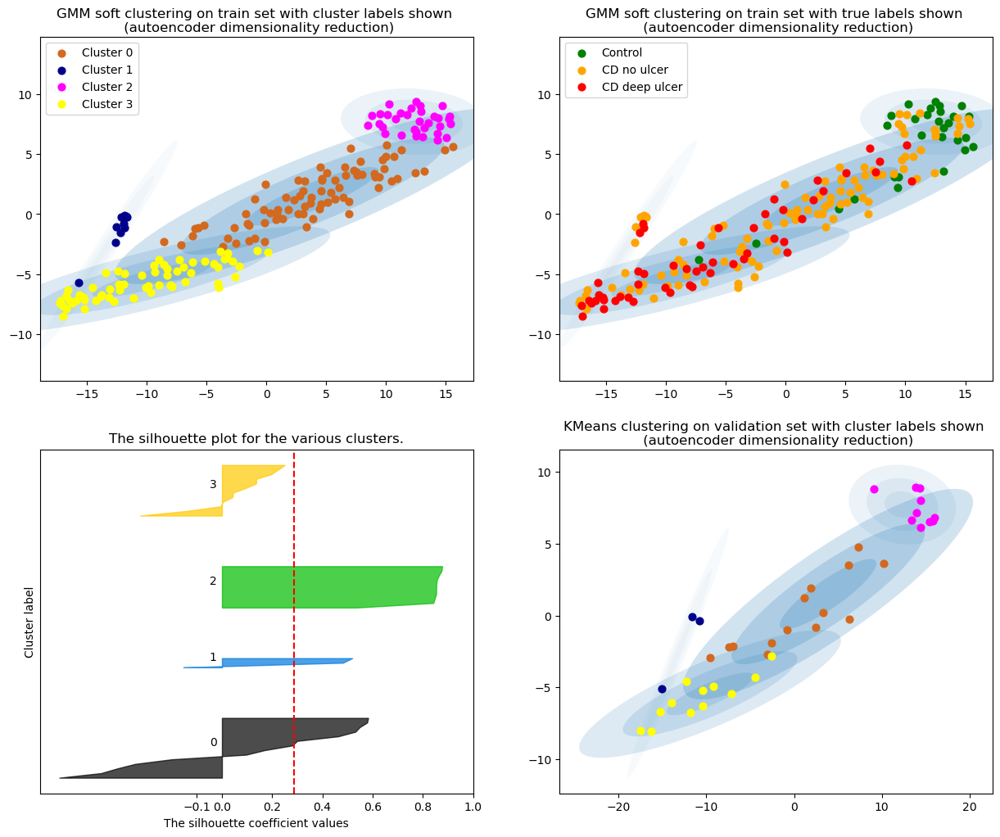

The average silhouette_score is : 0.28761613
Accuracy: 0.07692307692307693
F1 score: 0.11822843822843823
Perplexity = 50
[0 2 0 2 0 2 2 2 2 2 1 1 3 2 0 1 3 2 3 2 3 0 1 3 2 0 2 3 0 0 2 0 0 0 3 0 3
 0 2 0 2 2 2 1 2 0 0 3 0 2 1 0 0 0 0 3 0 2 0 0 2 0 2 2 0 1 0 3 0 0 0 0 0 3
 3 0 0 2 0 2 2 2 1 2 2 0 3 2 0 2 3 0 0 2 2 3 0 0 2 0 2 2 0 2 1 0 2 3 0 2 2
 2 3 0 0 2 0 2 0 3 1 2 3 2 3 2 1 2 3 2 1 2 2 2 0 0 1 2 2 1 0 3 0 2 2 2 3 0
 2 0 2 2 0 0 0 2 0 0 3 2 1 0 0 3 0 2 0 2 2 3 3 3 0 3 0 3 3 1 2 3 0 0]
num_clusters 4
num_clusters 3


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:88: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[gmm_val_labels==i, 0], X_val[gmm_val_labels==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing th

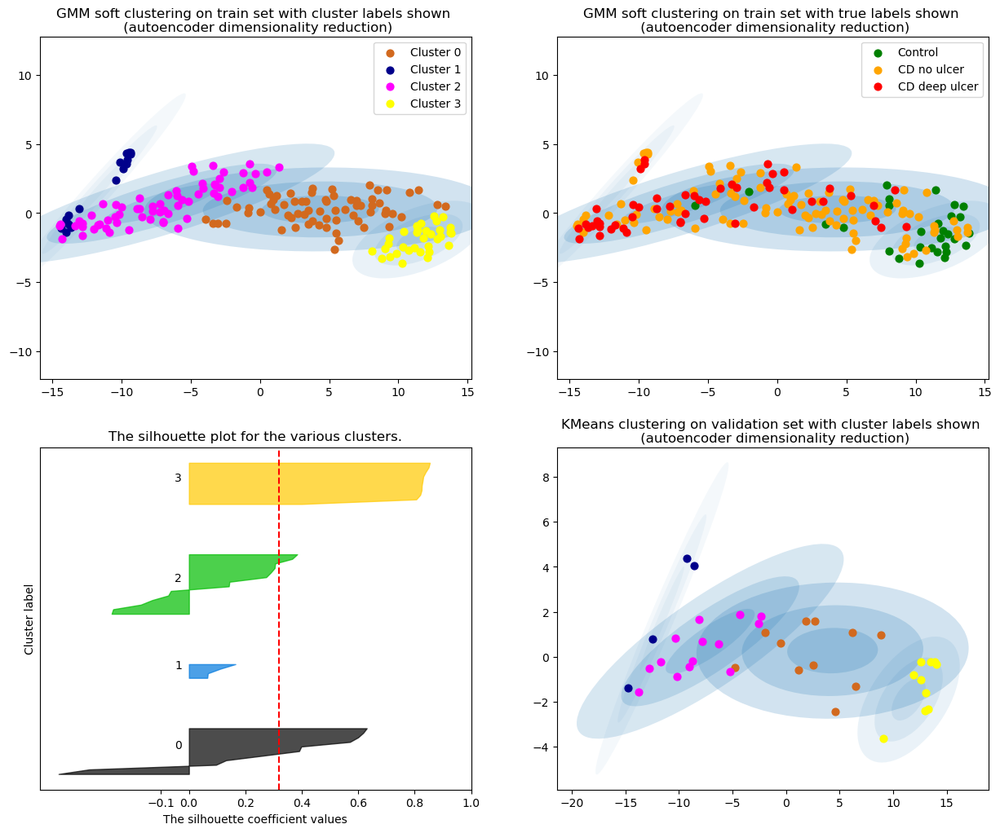

The average silhouette_score is : 0.3176918
Accuracy: 0.2564102564102564
F1 score: 0.2958579881656805
Perplexity = 60
[0 2 0 2 2 2 1 1 2 3 3 1 0 3 2 1 0 2 0 2 0 0 3 0 1 2 2 0 0 0 3 2 2 2 0 2 0
 2 3 2 3 1 3 3 2 2 2 0 0 1 3 2 2 2 2 0 0 1 2 2 1 2 3 3 2 1 2 0 2 2 2 2 0 0
 0 2 2 1 2 2 3 1 3 3 1 2 0 3 0 1 0 0 2 3 3 0 2 0 2 0 3 2 2 3 1 2 2 0 2 1 1
 3 0 2 0 3 2 3 2 0 1 1 0 3 0 3 1 3 0 1 3 1 3 3 2 2 1 3 1 1 2 0 2 1 2 3 0 0
 2 2 3 3 2 2 2 3 2 0 0 1 3 2 0 0 2 3 0 3 3 0 0 0 2 0 0 0 0 1 2 0 2 2]
num_clusters 4
num_clusters 3


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:88: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[gmm_val_labels==i, 0], X_val[gmm_val_labels==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing th

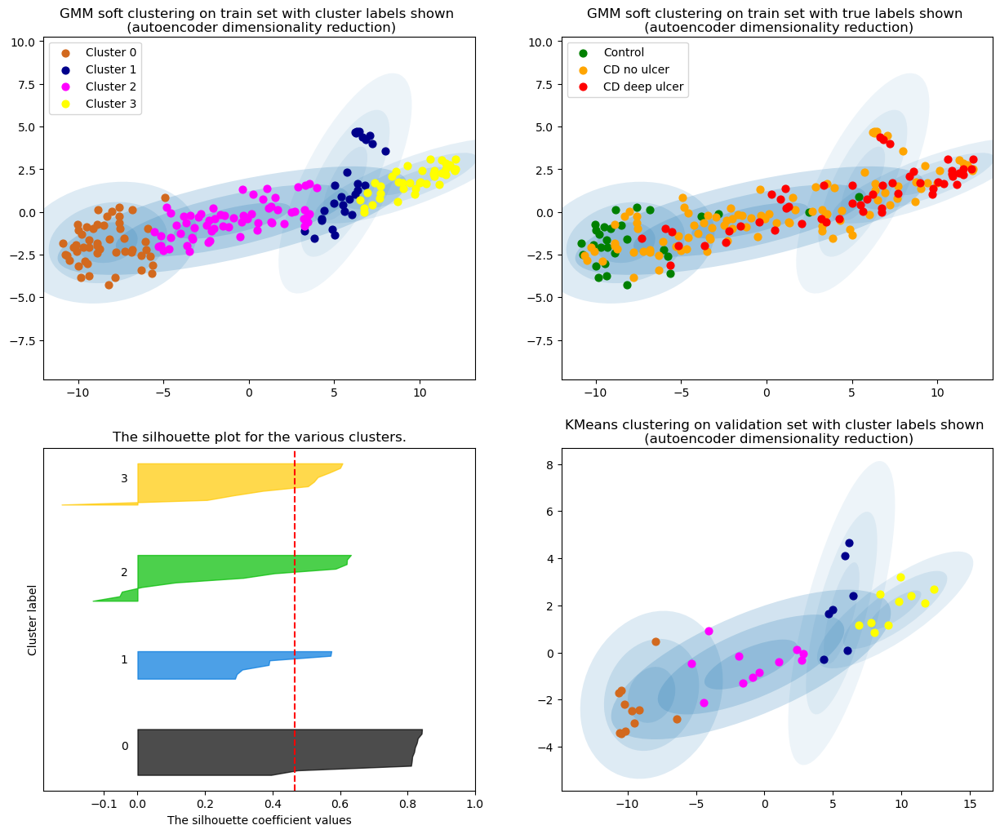

The average silhouette_score is : 0.46552932
Accuracy: 0.3333333333333333
F1 score: 0.3549138892092415
Perplexity = 70
[0 0 0 2 0 0 2 0 0 2 2 1 3 2 0 1 3 2 3 2 3 0 1 3 2 0 0 3 0 0 2 0 0 0 3 0 3
 0 2 0 2 0 2 2 0 0 0 3 0 2 2 2 0 0 0 3 0 2 0 0 0 0 2 2 0 1 0 3 0 0 0 0 0 3
 3 0 0 0 2 2 2 2 2 2 2 0 3 2 0 2 3 0 0 2 2 3 0 0 0 0 2 0 0 2 1 0 2 3 0 2 2
 2 3 0 0 2 0 2 0 3 1 2 3 2 3 2 1 2 3 0 2 2 2 2 2 0 1 2 2 1 0 3 0 2 0 2 3 0
 2 0 2 2 0 0 0 2 0 0 3 2 2 0 0 3 0 2 0 2 2 3 3 3 0 3 0 3 3 1 2 3 2 0]
num_clusters 4
num_clusters 3


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:88: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[gmm_val_labels==i, 0], X_val[gmm_val_labels==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing th

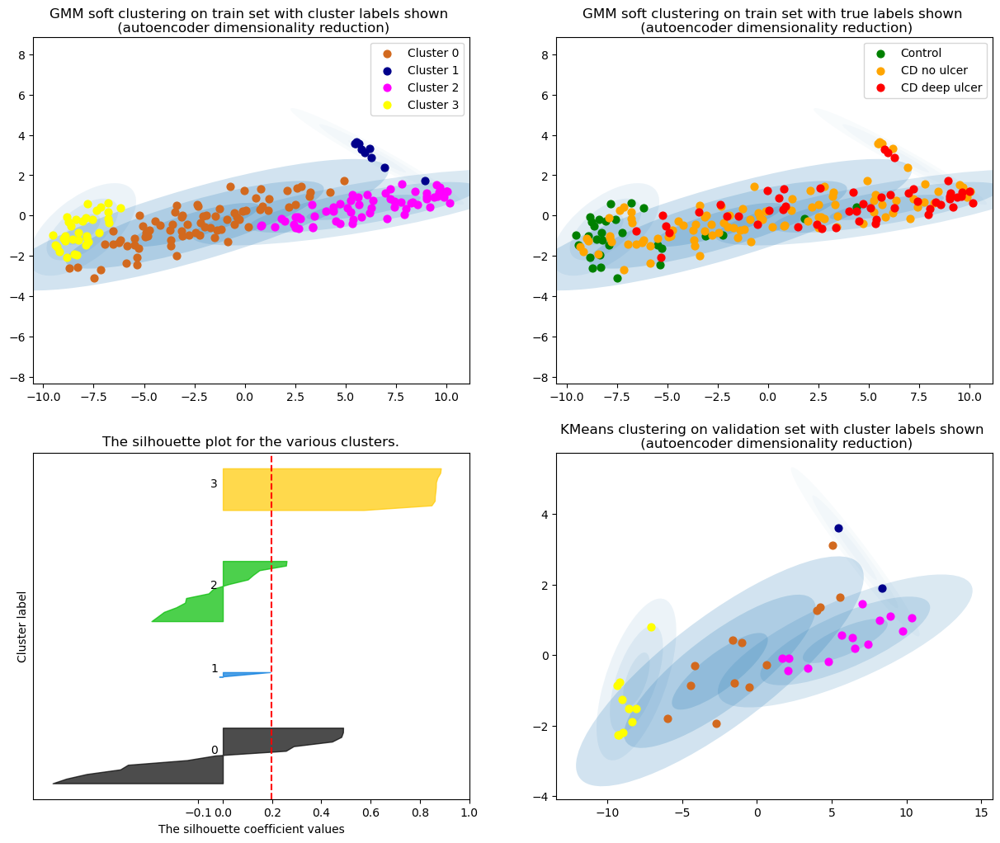

The average silhouette_score is : 0.19666278
Accuracy: 0.23076923076923078
F1 score: 0.23635765943458248
Perplexity = 80
[0 1 0 1 0 1 1 1 1 1 1 2 3 1 0 2 3 1 3 1 3 0 2 3 1 0 1 3 0 0 1 0 0 0 3 0 3
 0 1 0 1 1 1 1 1 0 0 3 0 1 1 0 0 0 0 3 3 1 0 0 1 0 1 1 0 2 0 3 0 0 0 0 0 3
 3 0 0 0 0 1 1 1 1 1 1 0 3 1 0 1 3 0 0 1 1 3 0 0 1 0 1 1 0 1 2 0 1 3 0 1 1
 1 3 0 3 1 0 1 0 3 2 1 3 1 3 1 2 1 3 0 1 1 1 1 0 0 2 1 1 2 0 3 0 1 1 1 3 0
 1 0 1 1 0 0 0 1 0 0 3 1 1 0 0 3 0 1 0 1 1 3 3 3 0 3 0 3 3 2 1 3 0 0]
num_clusters 4
num_clusters 3


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:88: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[gmm_val_labels==i, 0], X_val[gmm_val_labels==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing th

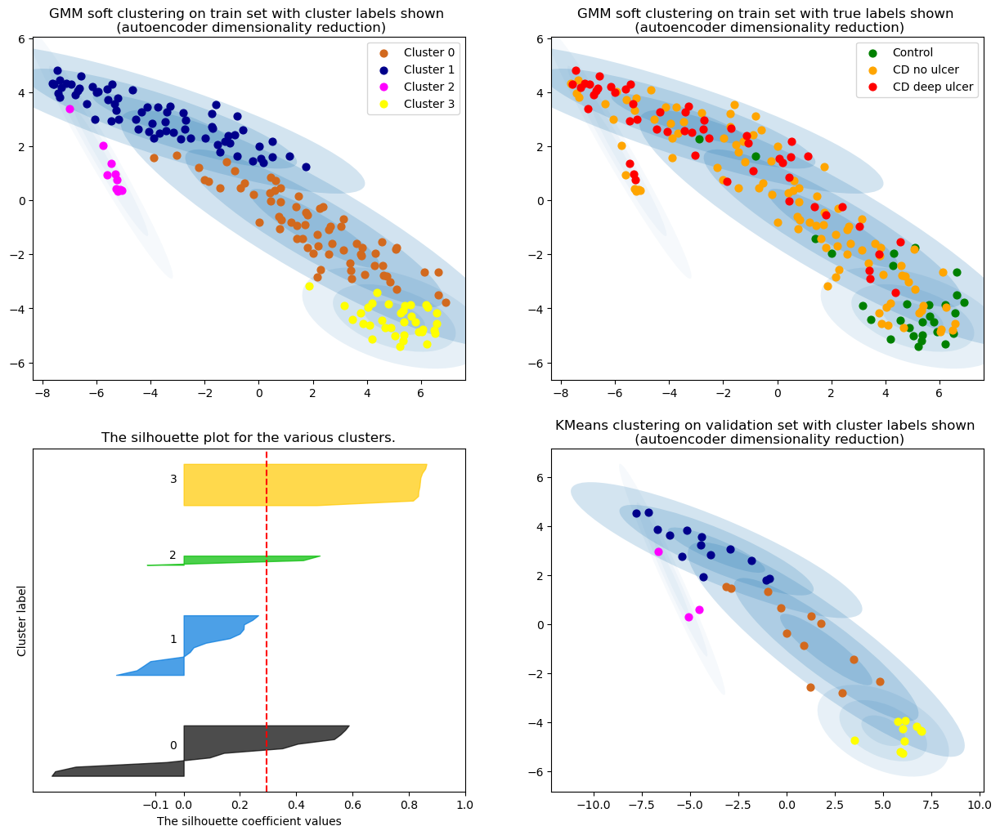

The average silhouette_score is : 0.29391977
Accuracy: 0.20512820512820512
F1 score: 0.2603988603988604
Perplexity = 90
[3 1 3 1 0 1 1 1 1 1 2 2 3 1 0 2 3 1 3 1 3 3 2 3 1 0 1 3 3 0 1 0 0 0 3 0 3
 0 1 0 1 1 2 2 1 0 0 3 3 1 2 0 0 0 0 3 3 1 0 0 1 0 1 2 0 2 0 3 0 0 0 0 3 3
 3 0 0 1 0 1 2 1 2 1 1 0 3 1 3 1 3 3 0 1 1 3 0 0 1 3 1 1 0 1 2 0 1 3 0 1 1
 1 3 0 0 1 0 1 0 3 2 1 3 1 3 1 2 1 3 1 2 1 1 1 0 0 2 1 1 2 0 3 0 1 1 1 3 3
 1 0 1 1 0 0 0 1 0 3 3 1 1 0 0 3 0 1 3 1 1 3 3 3 0 3 3 3 3 2 1 3 0 0]
num_clusters 4
num_clusters 3


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:88: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[gmm_val_labels==i, 0], X_val[gmm_val_labels==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing th

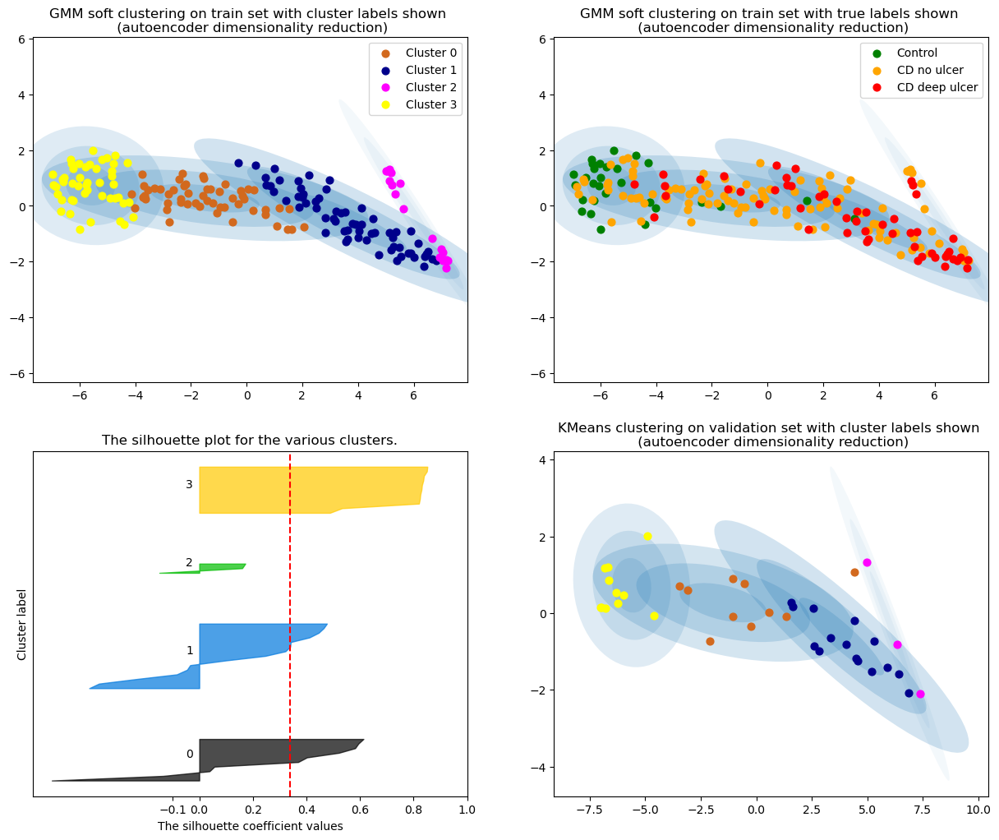

The average silhouette_score is : 0.33742887
Accuracy: 0.20512820512820512
F1 score: 0.2544698544698545
Perplexity = 100
[0 1 0 1 0 1 1 1 1 1 1 2 3 1 0 2 3 1 3 1 3 0 2 3 1 0 1 3 0 0 1 0 0 0 3 0 3
 0 1 0 1 1 1 1 1 0 0 3 0 1 1 0 0 0 0 3 3 1 0 0 1 0 1 1 0 2 0 3 0 0 0 0 0 3
 3 0 0 0 0 1 1 1 1 1 1 0 3 1 3 1 3 0 0 1 1 3 0 3 1 0 1 1 3 1 2 0 1 3 0 1 1
 1 3 0 3 1 0 1 0 3 2 1 3 1 3 1 2 1 3 0 1 1 1 1 0 0 2 1 1 2 0 3 3 1 1 1 3 0
 1 0 1 1 0 0 0 1 0 0 3 1 1 0 3 3 0 1 0 1 1 3 3 3 0 3 0 3 3 2 1 3 0 0]
num_clusters 4
num_clusters 3


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:88: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[gmm_val_labels==i, 0], X_val[gmm_val_labels==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing th

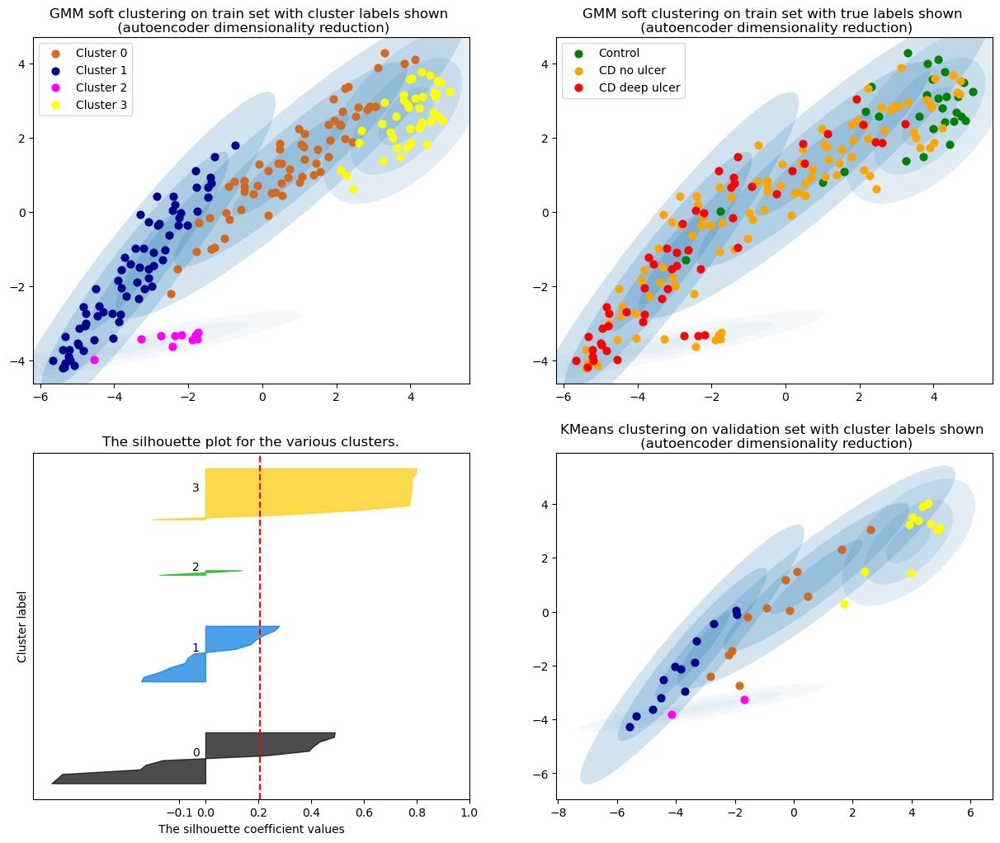

The average silhouette_score is : 0.20665526
Accuracy: 0.1794871794871795
F1 score: 0.23736263736263735
Perplexity = 110
[0 1 0 1 0 1 1 1 1 1 2 2 3 1 0 2 3 1 3 1 3 0 2 3 1 0 1 3 0 0 1 0 0 0 3 0 3
 0 1 0 1 1 2 1 1 0 0 3 0 1 2 1 0 0 0 3 3 1 0 0 1 0 1 2 0 2 0 3 0 0 0 0 0 3
 3 0 0 0 0 1 2 1 2 1 1 0 3 1 3 1 3 0 0 1 1 3 0 3 1 0 1 1 3 1 2 0 1 3 0 1 1
 1 3 0 3 1 0 1 0 3 2 1 3 1 3 1 2 1 3 0 2 1 1 1 0 0 2 1 1 2 0 3 3 1 1 1 3 0
 1 0 1 1 0 0 0 1 0 0 3 1 1 0 3 3 0 1 0 1 1 3 3 3 0 3 0 3 3 2 1 3 0 0]
num_clusters 4
num_clusters 3


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:88: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[gmm_val_labels==i, 0], X_val[gmm_val_labels==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing th

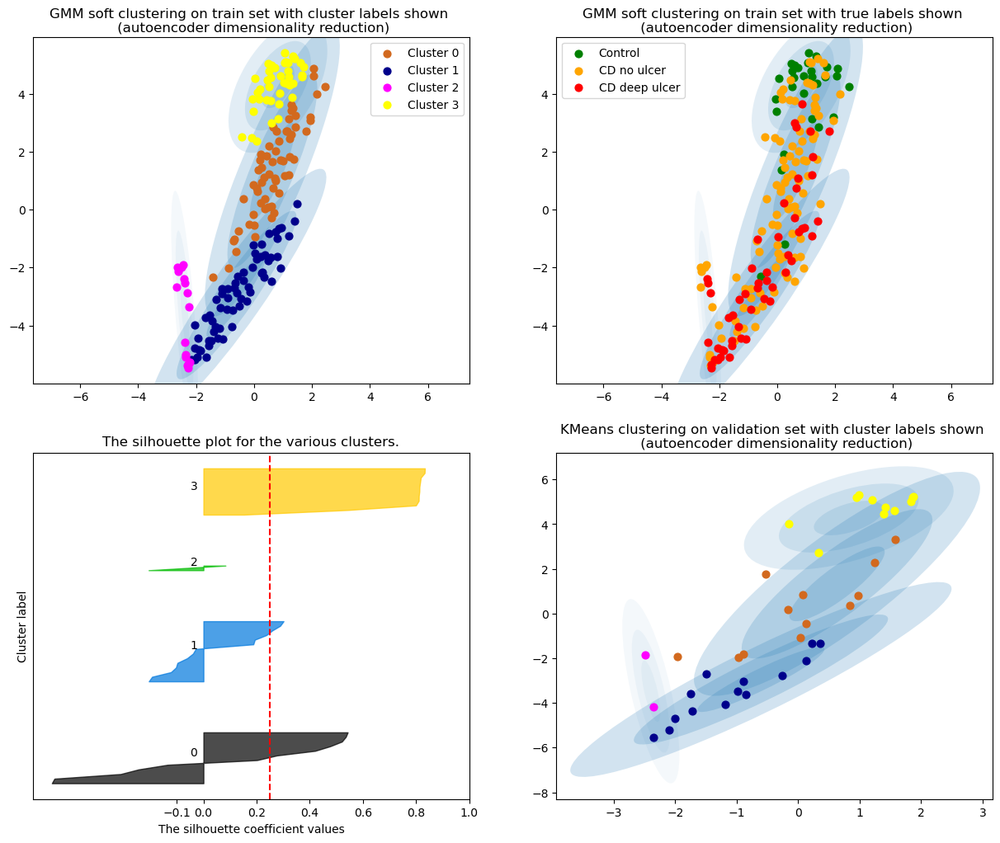

The average silhouette_score is : 0.24821006
Accuracy: 0.20512820512820512
F1 score: 0.2633292633292633
Perplexity = 120
[0 1 3 1 0 1 1 1 1 1 2 2 3 1 0 2 3 1 3 1 3 3 2 3 1 0 1 3 0 0 1 0 0 0 3 0 3
 0 1 0 1 1 2 1 1 0 0 3 0 1 2 1 0 0 0 3 3 1 0 0 1 0 1 2 0 2 0 3 0 0 0 0 0 3
 3 0 3 0 0 1 2 1 2 1 1 0 3 1 3 1 3 0 0 1 1 3 0 3 1 3 1 1 3 1 2 0 1 3 0 1 1
 1 3 0 3 1 0 1 0 3 2 1 3 1 3 1 2 1 3 0 2 1 1 1 0 0 2 1 1 2 0 3 3 1 1 1 3 3
 1 0 1 1 0 0 0 1 0 0 3 1 1 0 3 3 0 1 0 1 1 3 3 3 0 3 0 3 3 2 1 3 0 0]
num_clusters 4
num_clusters 3


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:88: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[gmm_val_labels==i, 0], X_val[gmm_val_labels==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing th

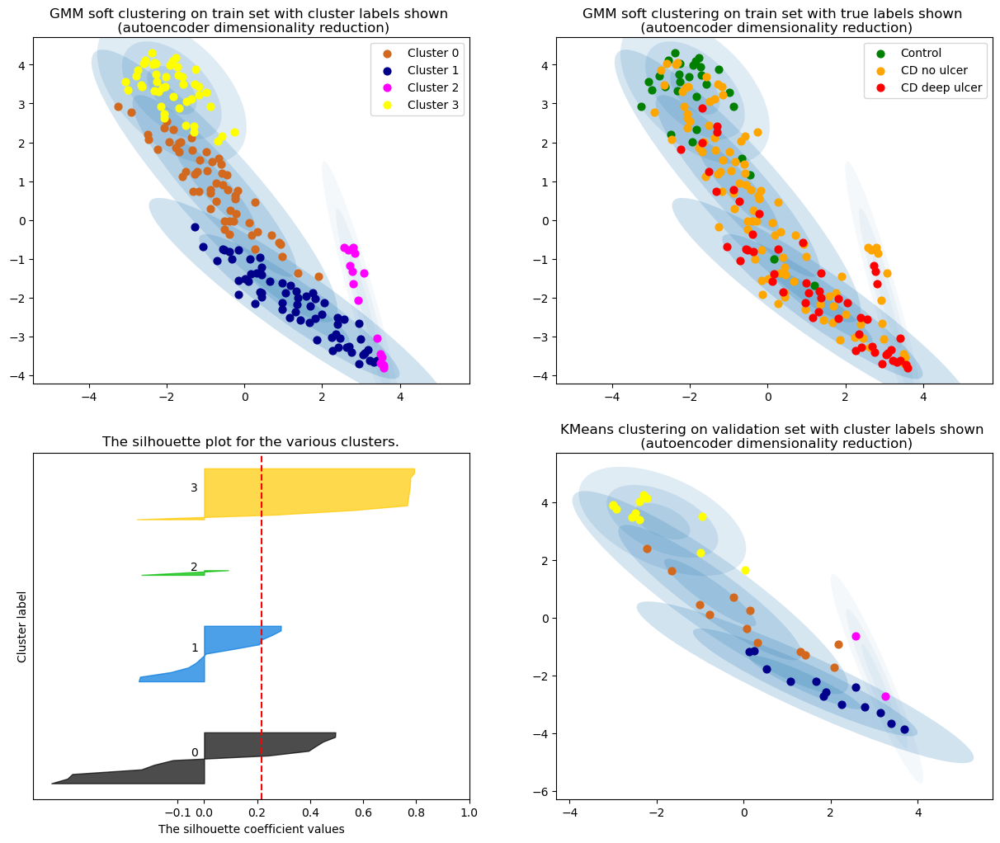

The average silhouette_score is : 0.21660317
Accuracy: 0.1794871794871795
F1 score: 0.23736263736263735
Perplexity = 130
[3 0 3 0 0 0 1 1 0 2 2 1 3 2 1 1 3 1 3 1 3 3 2 3 1 3 0 3 3 3 2 0 0 0 3 0 3
 0 2 0 2 1 2 2 0 0 0 3 3 1 2 1 1 0 0 3 3 1 0 0 1 0 1 2 0 1 0 3 0 1 0 0 3 3
 3 0 0 1 0 1 2 1 2 2 1 0 3 1 3 1 3 3 0 2 1 3 0 3 0 3 2 0 0 2 1 0 1 3 0 1 1
 2 3 0 0 2 0 2 0 3 1 1 3 2 3 2 1 2 3 1 2 1 1 2 0 0 1 2 1 1 1 3 0 1 0 2 3 3
 1 0 2 2 0 0 0 2 0 3 3 1 2 0 3 3 0 2 3 2 1 3 3 3 0 3 3 3 3 1 1 3 0 0]
num_clusters 4
num_clusters 3


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:88: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[gmm_val_labels==i, 0], X_val[gmm_val_labels==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing th

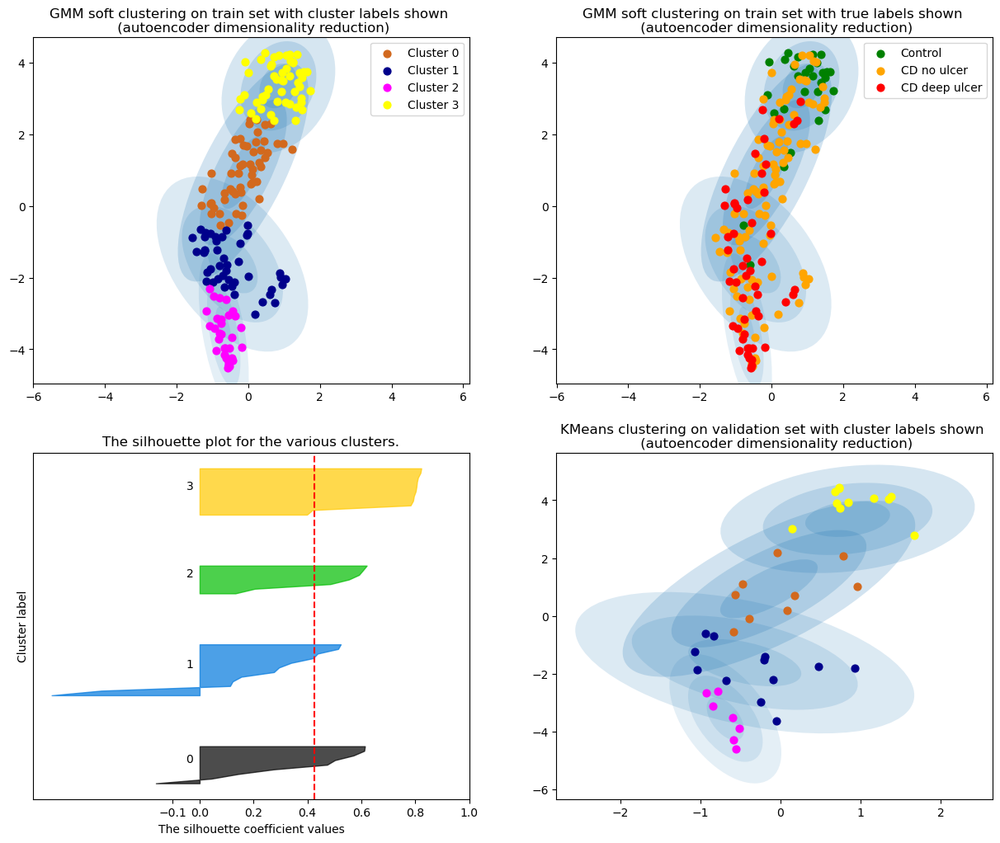

The average silhouette_score is : 0.4254703
Accuracy: 0.3333333333333333
F1 score: 0.42740335000396923
Perplexity = 140
[3 1 3 1 0 1 1 1 1 1 2 2 3 1 1 2 3 1 3 1 3 0 2 3 1 0 1 3 3 0 1 0 0 0 3 0 3
 0 1 0 1 1 2 2 1 0 0 3 0 1 2 1 1 0 0 3 3 1 0 0 1 0 1 2 0 2 0 3 0 1 0 0 0 3
 3 0 0 1 1 1 2 1 2 1 1 0 3 1 3 1 3 3 0 1 1 3 0 0 1 3 1 1 0 1 2 0 1 3 0 1 1
 1 3 0 0 1 0 1 0 3 2 1 3 1 3 1 2 1 3 1 2 1 1 1 0 0 2 1 1 2 1 3 0 1 1 1 3 0
 1 0 1 1 0 0 0 2 0 0 3 1 2 0 0 3 0 2 0 1 1 3 3 3 0 3 0 3 3 2 1 3 0 0]
num_clusters 4
num_clusters 3


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:88: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[gmm_val_labels==i, 0], X_val[gmm_val_labels==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing th

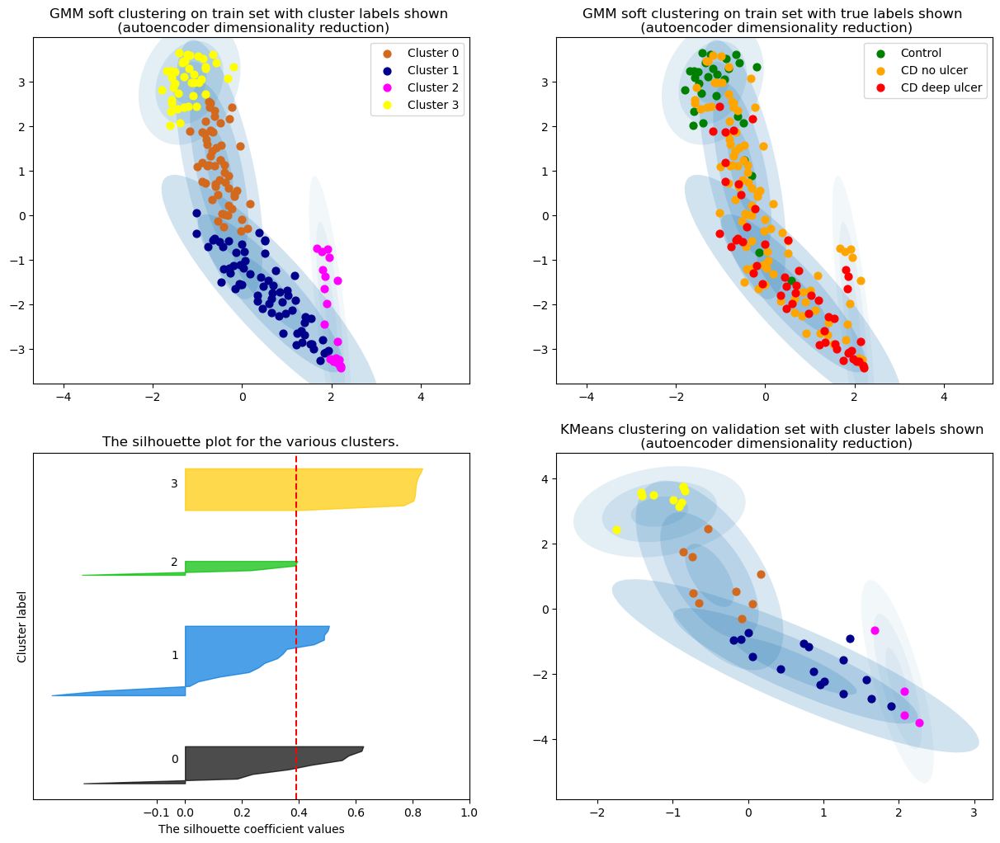

The average silhouette_score is : 0.39139858
Accuracy: 0.2564102564102564
F1 score: 0.3144399460188934
Perplexity = 150
[0 0 3 0 0 0 1 1 0 2 2 1 3 1 1 1 3 0 3 0 3 0 1 3 1 0 0 3 3 0 2 0 0 0 3 0 3
 0 1 0 1 0 2 2 0 0 0 3 0 1 2 0 1 0 0 3 0 1 0 0 1 0 1 2 0 1 0 3 0 1 0 0 0 3
 3 0 0 1 0 0 2 1 2 2 1 0 3 1 3 1 3 3 0 1 1 3 0 0 0 3 1 0 0 2 1 0 0 3 0 1 1
 1 3 0 0 2 0 1 0 3 1 1 3 1 3 2 1 2 3 1 2 1 1 2 0 0 1 2 1 1 0 3 0 1 0 1 3 0
 0 0 2 2 0 0 0 2 0 0 0 1 2 0 0 3 0 1 0 1 1 3 3 3 0 3 0 3 3 1 1 3 0 0]
num_clusters 4
num_clusters 3


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:88: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[gmm_val_labels==i, 0], X_val[gmm_val_labels==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing th

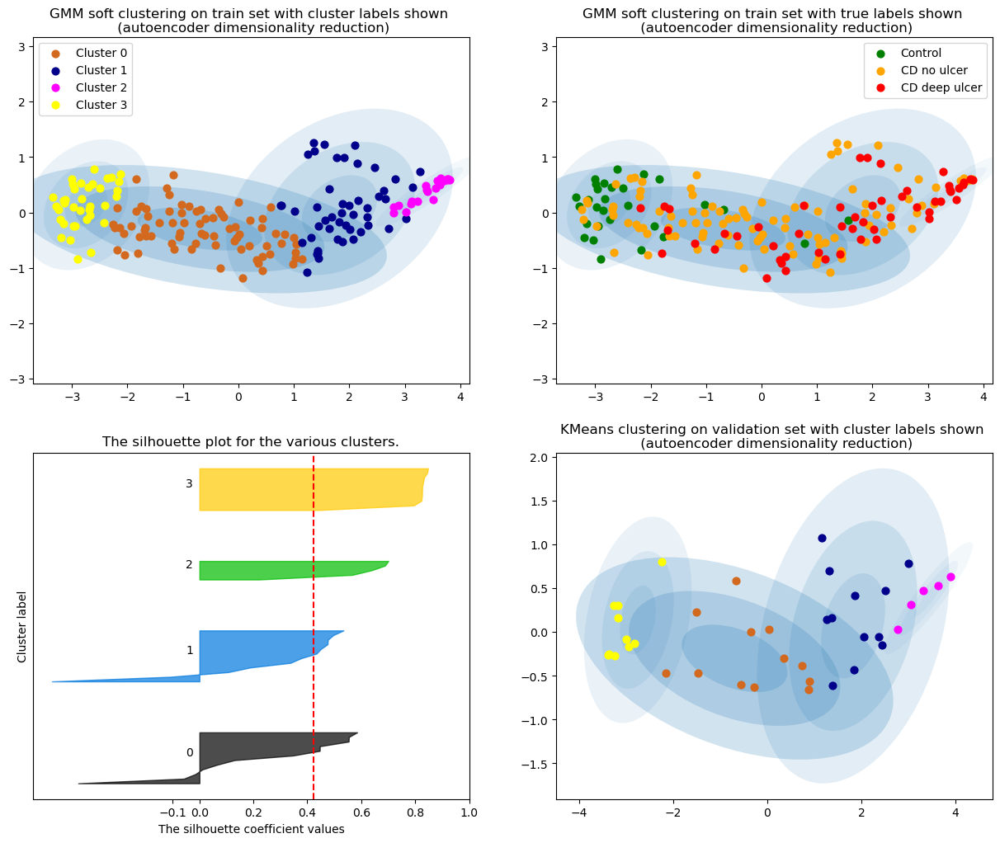

The average silhouette_score is : 0.42413038
Accuracy: 0.2564102564102564
F1 score: 0.3408748114630467
Perplexity = 160
[3 0 3 0 0 0 2 2 0 1 1 2 3 2 2 2 3 2 3 2 3 0 2 3 2 0 0 3 0 0 1 0 0 0 3 0 3
 0 2 0 2 0 1 1 0 0 0 3 0 2 1 2 2 0 0 3 3 2 0 0 2 0 2 1 0 2 0 3 0 2 0 0 0 3
 3 0 0 2 0 2 1 2 1 1 2 0 3 2 3 2 3 3 0 2 2 3 0 0 2 3 2 0 0 1 2 0 2 3 0 2 2
 2 3 0 0 1 0 2 0 3 2 2 3 2 3 1 2 1 3 2 1 2 2 1 0 0 2 1 2 2 2 3 0 2 0 2 3 0
 0 0 1 1 0 0 0 1 0 0 3 2 1 0 0 3 0 2 0 2 2 3 3 3 0 3 0 3 3 2 2 3 2 0]
num_clusters 4
num_clusters 3


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:88: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[gmm_val_labels==i, 0], X_val[gmm_val_labels==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing th

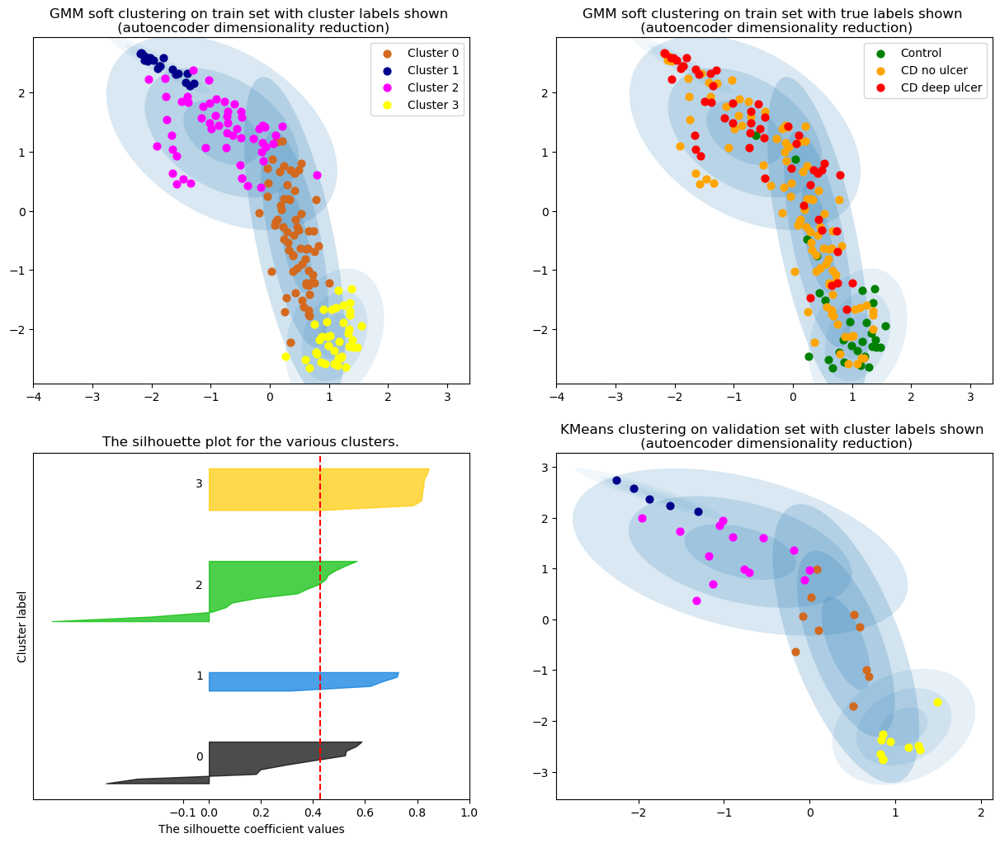

The average silhouette_score is : 0.42673784
Accuracy: 0.23076923076923078
F1 score: 0.24925122361019797
Perplexity = 170
[3 0 3 0 0 0 1 1 0 2 2 1 3 1 1 1 3 1 0 0 3 0 1 3 1 0 0 3 3 0 2 0 0 0 3 0 3
 0 1 0 1 0 2 2 0 0 0 3 0 1 2 0 1 0 0 3 0 1 0 0 1 0 1 2 0 1 0 0 0 1 0 0 0 3
 3 0 0 1 0 0 2 1 2 2 1 0 3 1 3 1 3 3 0 1 1 3 0 0 0 3 1 0 0 2 1 0 0 3 0 1 1
 1 3 0 0 2 0 1 0 3 1 1 3 1 3 2 1 2 3 1 2 1 1 2 0 0 1 2 1 1 1 3 0 1 0 1 3 0
 0 0 2 2 0 0 0 2 0 0 0 1 2 0 0 3 0 1 0 1 1 3 3 3 0 3 0 3 3 1 1 3 0 0]
num_clusters 4
num_clusters 3


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:88: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[gmm_val_labels==i, 0], X_val[gmm_val_labels==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing th

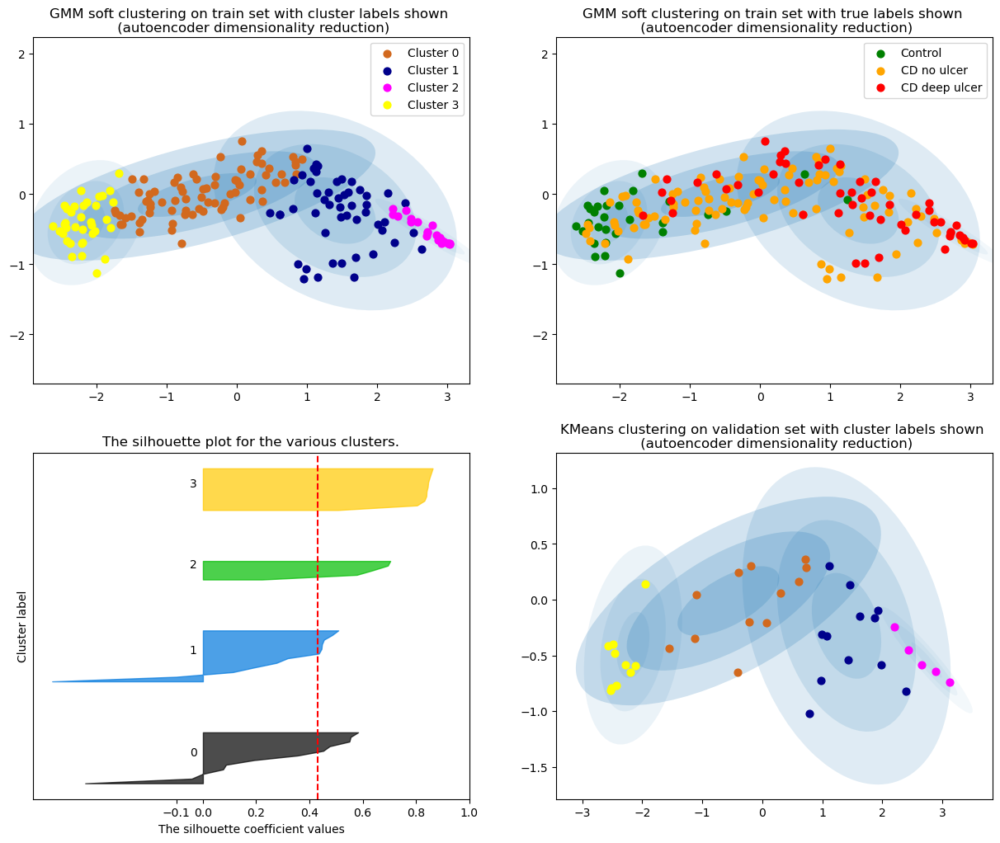

The average silhouette_score is : 0.43000734
Accuracy: 0.2564102564102564
F1 score: 0.3408748114630467
Perplexity = 180
[3 0 3 2 0 2 2 2 0 1 1 2 3 1 2 2 3 2 3 2 3 3 1 3 2 0 0 3 3 0 1 0 0 0 3 0 3
 0 2 0 1 2 1 1 0 0 0 3 3 2 1 2 2 0 0 3 3 2 2 0 2 0 2 1 0 2 0 3 0 2 0 0 3 3
 3 0 0 2 2 2 1 2 1 1 2 0 3 2 3 2 3 3 0 2 2 3 0 3 2 3 1 2 0 1 2 0 2 3 0 2 2
 1 3 0 0 1 0 1 0 3 2 2 3 1 3 1 2 1 3 2 1 2 2 1 0 0 2 1 2 2 2 3 0 2 0 1 3 3
 2 0 1 1 0 0 0 1 0 3 3 2 1 0 0 3 0 2 3 1 2 3 3 3 0 3 3 3 3 2 2 3 2 0]
num_clusters 4
num_clusters 3


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:88: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[gmm_val_labels==i, 0], X_val[gmm_val_labels==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing th

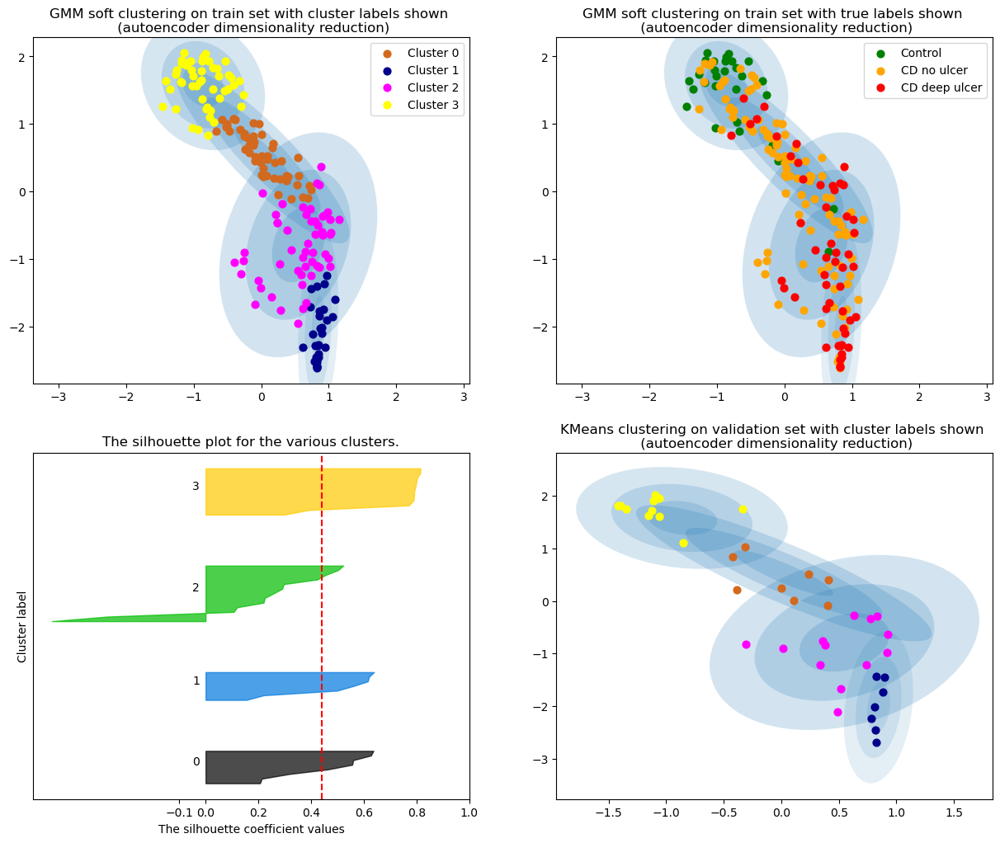

The average silhouette_score is : 0.44136962
Accuracy: 0.1794871794871795
F1 score: 0.20088417329796643
Perplexity = 190
[0 0 3 0 0 0 1 1 0 2 2 1 3 2 1 1 3 0 3 0 3 0 1 3 1 0 0 3 0 0 2 0 0 0 3 0 3
 0 1 0 1 0 2 2 0 0 0 3 0 1 2 0 1 0 0 3 0 1 0 0 1 0 1 2 0 1 0 3 0 1 0 0 0 3
 3 0 0 1 0 0 2 1 2 2 1 0 3 1 0 1 3 0 0 1 1 3 0 0 0 3 1 0 0 2 1 0 0 3 0 1 1
 1 3 0 0 1 0 1 0 3 1 1 3 1 3 2 1 2 3 1 2 1 1 2 0 0 1 2 1 1 1 3 0 1 0 1 3 0
 0 0 2 2 0 0 0 2 0 0 3 1 2 0 0 3 0 1 0 1 1 3 3 3 0 3 0 3 3 1 1 3 0 0]
num_clusters 4
num_clusters 3


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:88: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[gmm_val_labels==i, 0], X_val[gmm_val_labels==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing th

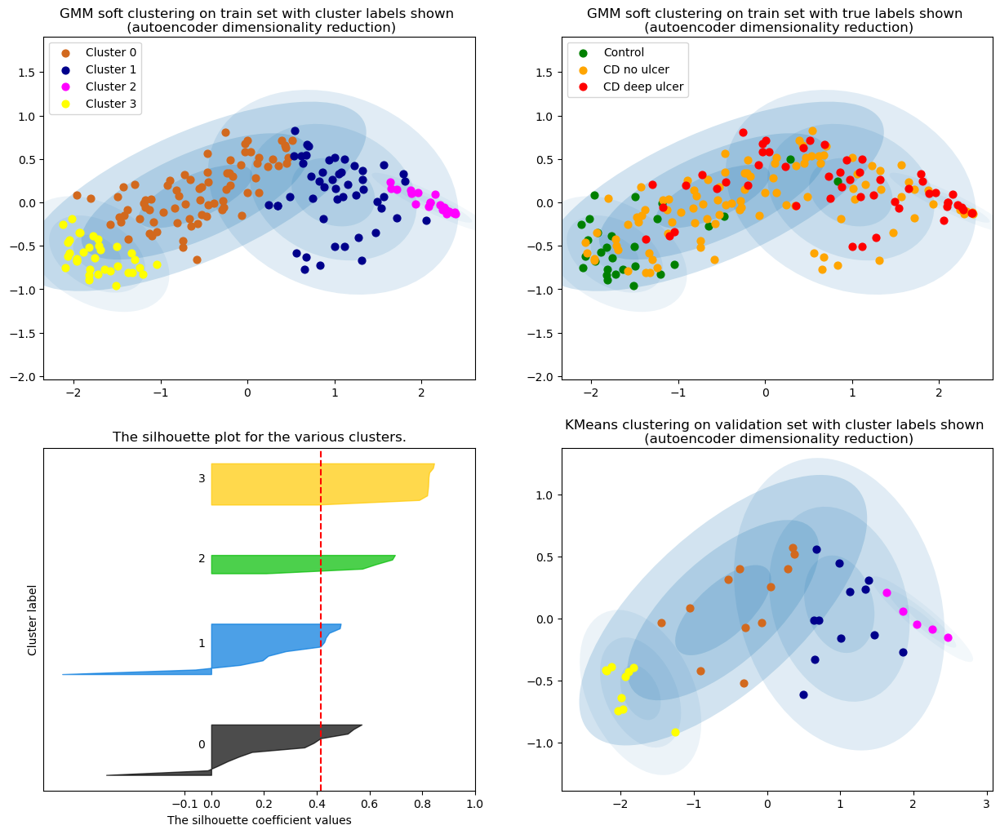

The average silhouette_score is : 0.41532424
Accuracy: 0.2564102564102564
F1 score: 0.3408748114630467
Perplexity = 200
[0 0 0 0 0 0 1 1 0 2 2 1 3 2 1 1 3 0 3 0 3 0 1 3 1 0 0 3 0 0 2 0 0 0 3 0 3
 0 1 0 1 0 2 2 0 0 0 3 0 1 2 0 1 0 0 3 0 1 0 0 0 0 1 2 0 1 0 3 0 1 0 0 0 3
 3 0 0 1 0 0 2 1 2 2 1 0 3 1 0 1 3 0 0 1 1 3 0 0 0 3 1 0 0 2 1 0 0 3 0 1 1
 1 3 0 0 1 0 1 0 3 1 1 3 1 3 2 1 1 3 1 2 1 1 2 0 0 1 2 1 1 0 3 0 1 0 1 3 0
 0 0 2 2 0 0 0 2 0 0 3 1 2 0 0 3 0 1 0 1 1 3 3 3 0 3 0 3 3 1 1 3 0 0]
num_clusters 4
num_clusters 3


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:88: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[gmm_val_labels==i, 0], X_val[gmm_val_labels==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing th

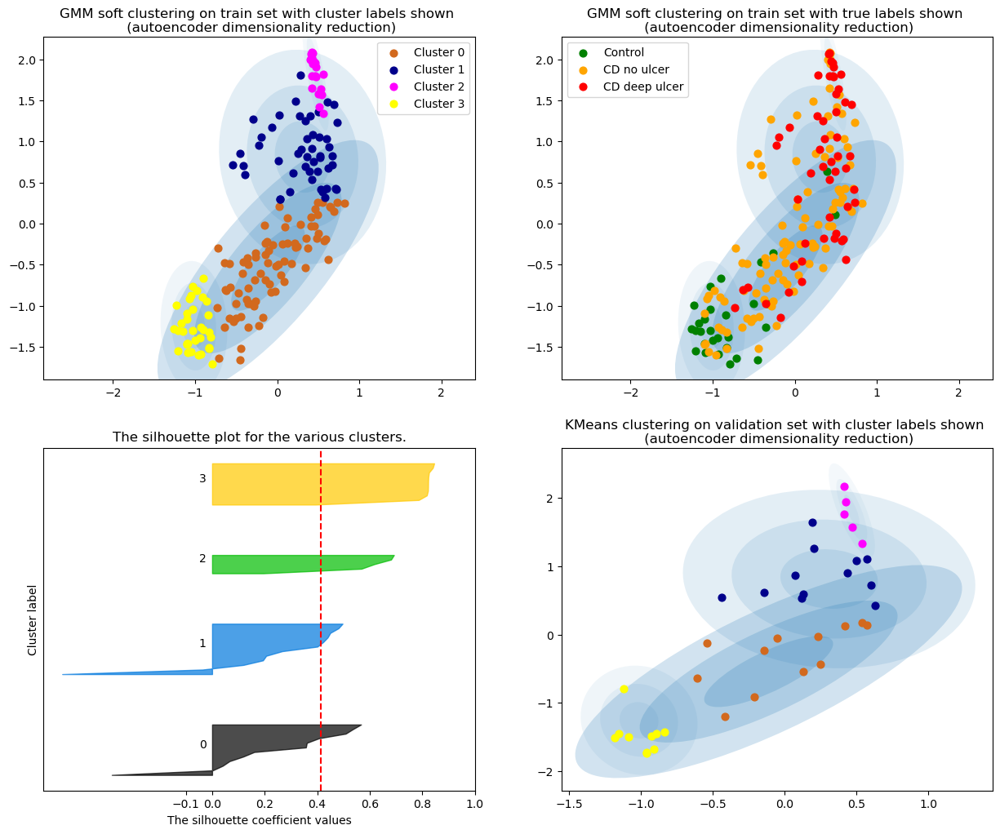

The average silhouette_score is : 0.41408247
Accuracy: 0.2564102564102564
F1 score: 0.3408748114630467
Perplexity = 210
[0 0 0 2 0 2 2 2 0 2 2 1 3 2 1 1 3 2 3 2 3 0 2 3 1 0 0 3 0 0 2 0 0 0 3 0 3
 0 2 0 2 2 2 2 0 0 0 3 0 2 2 2 1 0 0 3 0 2 0 0 0 0 2 2 0 1 0 3 0 1 0 0 0 3
 3 0 0 1 0 2 2 2 2 2 2 0 3 2 0 2 3 0 0 2 2 3 0 0 2 3 2 2 0 2 1 0 2 3 0 2 2
 2 3 0 0 2 0 2 0 3 1 2 3 2 3 2 1 2 3 1 2 2 2 2 0 0 1 2 2 1 0 3 0 2 0 2 3 0
 2 0 2 2 0 0 0 2 0 0 3 1 2 0 0 3 0 2 0 2 2 3 3 3 0 3 0 3 3 1 2 3 0 0]
num_clusters 4
num_clusters 3


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:88: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[gmm_val_labels==i, 0], X_val[gmm_val_labels==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing th

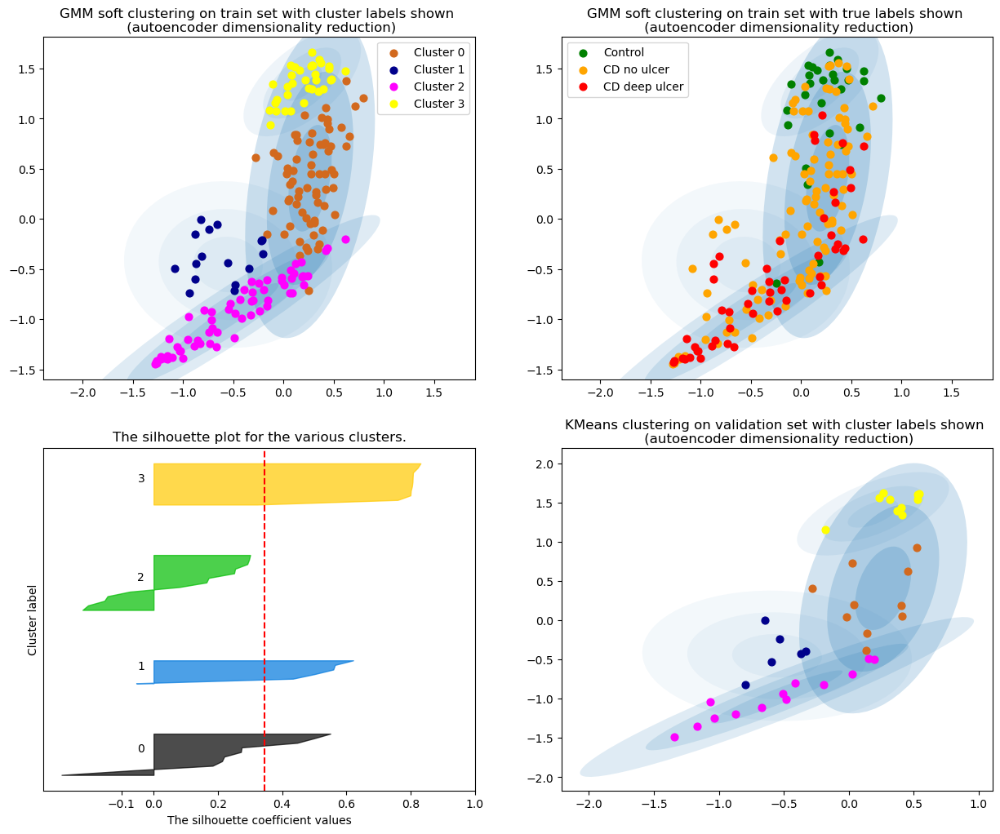

The average silhouette_score is : 0.34615344
Accuracy: 0.28205128205128205
F1 score: 0.3334798534798535
Perplexity = 220
[3 0 0 0 0 0 2 2 0 2 2 1 3 2 1 1 3 2 3 2 3 0 2 3 1 0 0 3 0 0 2 0 0 0 3 0 3
 0 2 0 2 2 2 2 0 0 0 3 0 2 2 2 1 0 0 3 3 2 0 0 0 0 2 2 0 1 0 3 0 1 0 0 0 3
 3 0 0 1 0 2 2 2 2 2 2 0 3 2 0 2 3 0 0 2 2 3 0 0 2 0 2 0 3 2 1 0 0 3 0 2 2
 2 3 0 3 2 0 2 0 3 1 2 3 2 3 2 1 2 3 1 2 2 2 2 0 0 1 2 2 1 1 3 3 2 0 2 3 0
 2 0 2 2 0 0 0 2 0 0 3 1 2 0 3 3 0 2 0 2 2 3 3 3 0 3 0 3 3 1 2 3 0 0]
num_clusters 4
num_clusters 3


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:88: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[gmm_val_labels==i, 0], X_val[gmm_val_labels==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing th

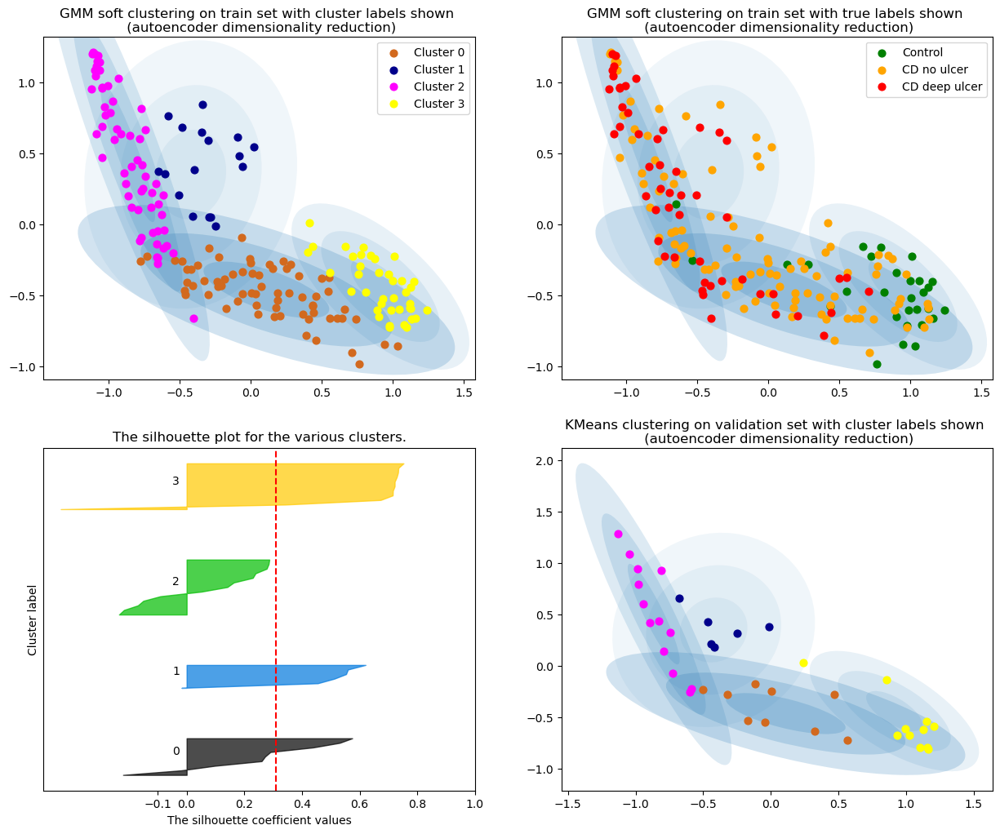

The average silhouette_score is : 0.31063074
Accuracy: 0.28205128205128205
F1 score: 0.3334798534798535
Perplexity = 230
[3 0 0 0 0 0 1 1 0 1 1 2 3 1 2 2 3 1 3 1 3 0 1 3 1 0 0 3 0 0 1 0 0 0 3 0 3
 0 1 0 1 1 1 1 0 0 0 3 0 1 1 1 2 0 0 3 3 1 0 0 0 0 1 1 0 2 0 3 0 2 0 0 0 3
 3 0 0 2 0 1 1 1 1 1 1 0 3 1 0 1 3 0 0 1 1 3 0 3 1 3 1 0 3 1 2 0 0 3 0 1 1
 1 3 0 3 1 0 1 0 3 2 1 3 1 3 1 2 1 3 2 1 1 1 1 0 0 2 1 1 2 2 3 3 1 0 1 3 0
 1 0 1 1 0 0 0 1 0 0 3 2 1 0 3 3 0 1 0 1 1 3 3 3 0 3 0 3 3 2 1 3 0 0]
num_clusters 4
num_clusters 3


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:88: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[gmm_val_labels==i, 0], X_val[gmm_val_labels==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing th

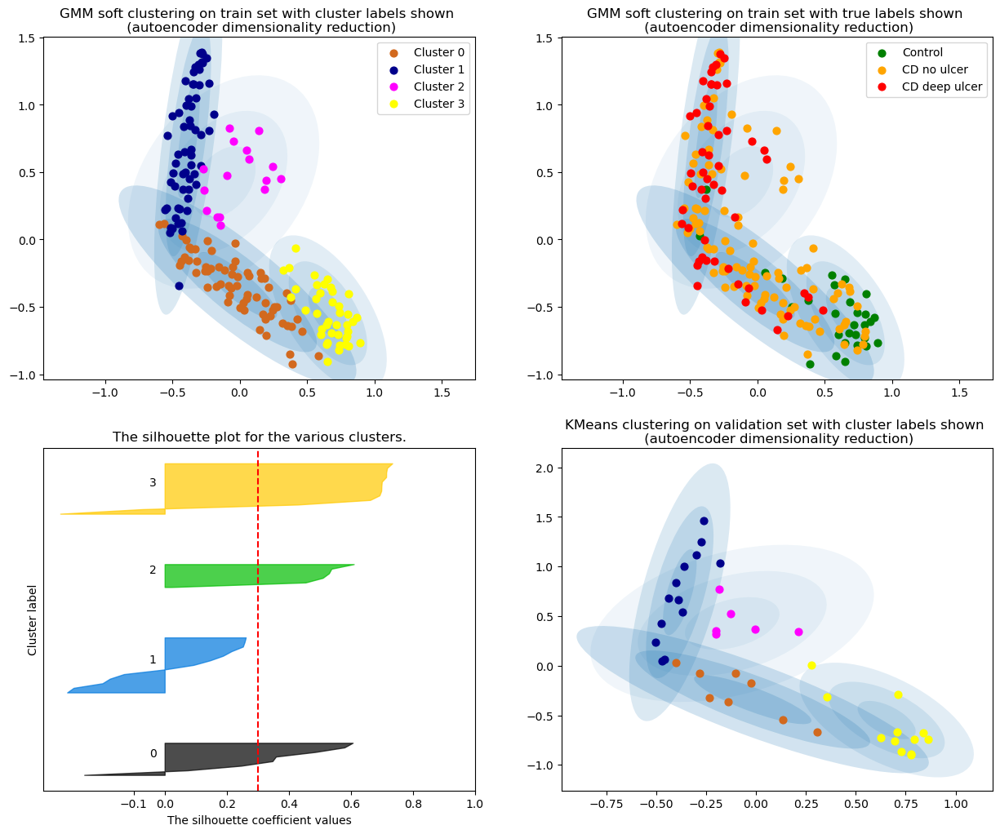

The average silhouette_score is : 0.3009871
Accuracy: 0.20512820512820512
F1 score: 0.26178266178266174
Perplexity = 240
[0 2 0 2 2 2 1 1 2 3 3 1 0 3 1 1 0 1 0 2 0 0 3 0 1 2 2 0 2 2 3 2 2 2 0 2 0
 2 1 2 1 2 3 3 2 2 2 0 2 1 3 2 1 2 2 0 0 1 2 2 2 2 1 3 2 1 2 0 2 1 2 2 0 0
 0 2 0 1 2 1 3 1 3 3 1 2 0 1 0 1 0 2 2 1 1 0 2 0 2 0 1 2 0 3 1 2 2 0 2 1 1
 1 0 2 0 3 2 1 2 0 1 1 0 1 0 3 1 3 0 1 3 1 1 3 2 2 1 3 1 1 1 0 0 1 2 3 0 0
 2 2 3 3 2 2 2 3 2 2 0 1 3 2 0 0 2 1 2 1 1 0 0 0 2 0 2 0 0 1 1 0 2 2]
num_clusters 4
num_clusters 3


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:88: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[gmm_val_labels==i, 0], X_val[gmm_val_labels==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing th

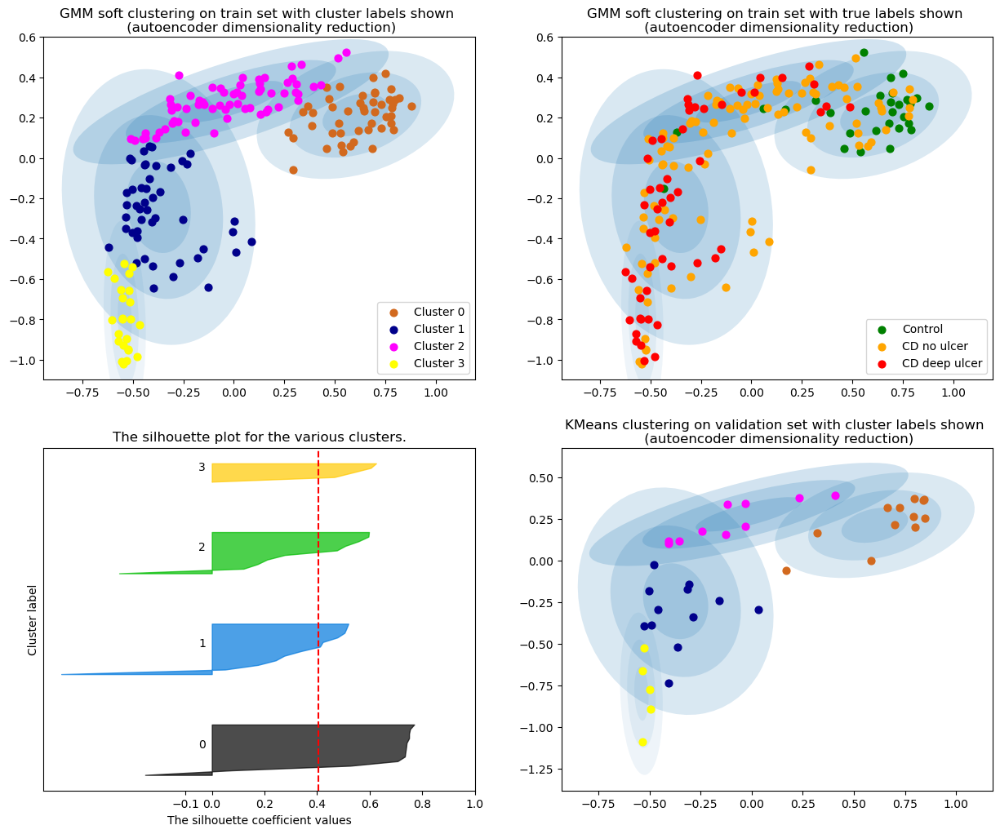

The average silhouette_score is : 0.40421724
Accuracy: 0.38461538461538464
F1 score: 0.3916083916083916
Perplexity = 250
[3 2 3 2 0 2 2 2 0 1 1 1 3 1 2 1 3 2 3 2 3 0 1 3 2 0 2 3 0 0 1 0 0 0 3 0 3
 0 1 0 2 2 1 1 2 0 0 3 0 2 1 2 2 0 0 3 3 2 0 0 2 0 2 1 0 1 0 3 0 2 0 0 3 3
 3 0 0 2 2 2 1 2 1 1 2 0 3 2 0 2 3 3 0 1 2 3 0 0 2 3 1 2 0 1 1 0 2 3 0 2 2
 2 3 0 3 1 0 2 0 3 1 2 3 2 3 1 1 1 3 1 1 2 2 1 2 0 1 2 2 1 2 3 0 2 0 2 3 3
 2 0 1 1 0 0 0 1 0 0 3 2 1 0 3 3 0 1 0 2 2 3 3 3 0 3 0 3 3 1 2 3 2 0]
num_clusters 4
num_clusters 3


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:88: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[gmm_val_labels==i, 0], X_val[gmm_val_labels==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing th

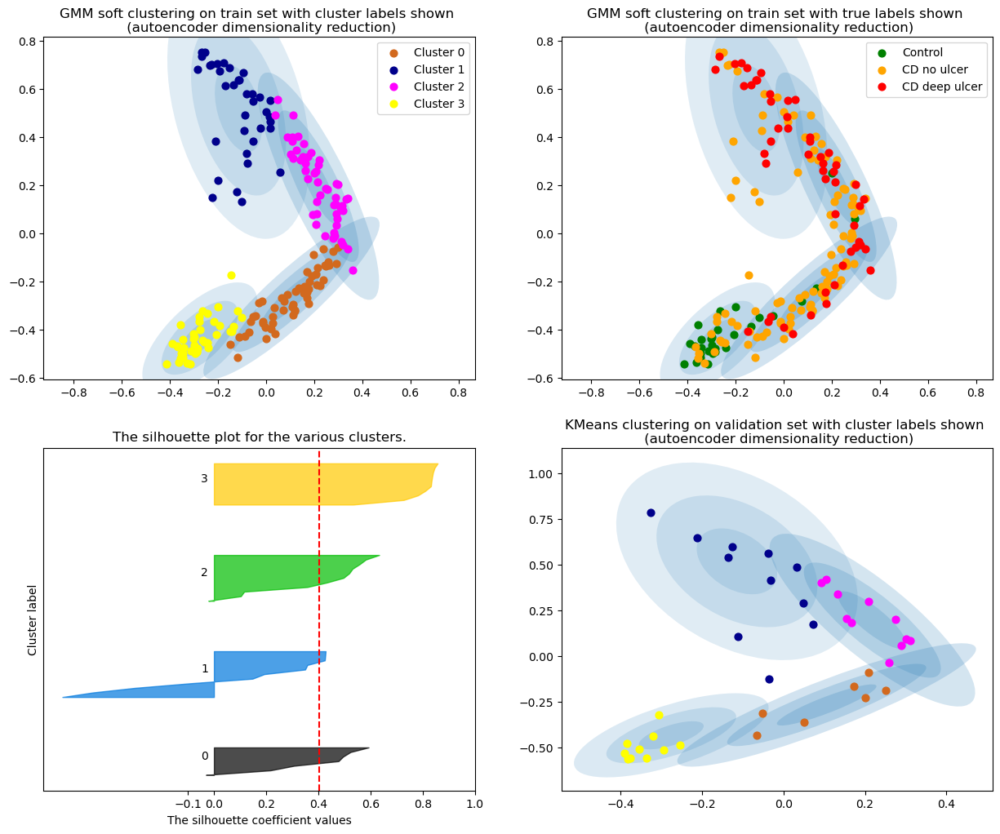

The average silhouette_score is : 0.40175295
Accuracy: 0.3333333333333333
F1 score: 0.39985135637309543


In [61]:
# perplexities = [10, 20, 50, 70]
# perplexities = [10, 20, 50, 70, 100, 150, 200, 250]
perplexities = np.arange(0, 251, 10)[1:]
sil_scores = []
acc_scores = []
f1_scores = []

# perplexity = 24
for perplexity in perplexities:
    gmm_ae, X_train_ae, X_test_ae, X_val_ae = fit_gmm(full_ae_dataset, perplexity, num_c)
    print("Perplexity =",perplexity)
    sil, acc, f1 = plot_gmm(gmm_ae, X_train_ae, X_val_ae, train_disease_labels, "autoencoder", num_c=num_c, plot_sil=True)
    sil_scores.append(sil)
    acc_scores.append(acc)
    f1_scores.append(f1)



    

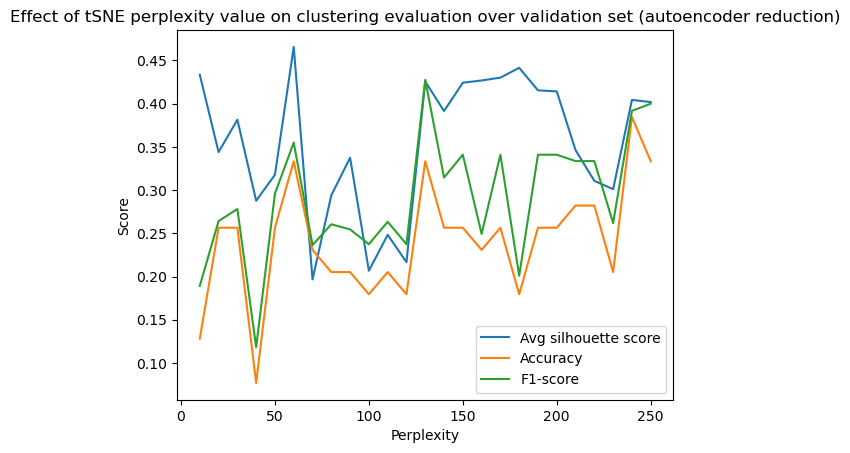

In [62]:
plot_val_scores(sil_scores, acc_scores, f1_scores, "autoencoder")

### Testing

In [63]:

# def test_gmm_prediction_ae(x_test_scaled, train_disease_labels, test_disease_labels):
#     # preprocessing
    
    
#     num_c = 4
#     full_dataset = full_ds.copy()
#     split_pt = len(full_dataset) - len(x_test_scaled)
#     full_dataset.iloc[split_pt:,:] = x_test_scaled
# #     print("split_pt:",split_pt)

#     with open("data/d_labels", "rb") as fp:   # Unpickling
#         full_disease_labels = pickle.load(fp)
# #     full_disease_labels = np.concatenate([train_disease_labels, val_disease_labels, test_disease_labels])
#     train_disease_labels = full_disease_labels[:split_pt]
#     test_disease_labels = full_disease_labels[split_pt:]
    
#     full_ae_dataset = ae_encode_dataset(full_dataset)
#     perplexity = 120
#     gmm, X_train, X_test, X_val = fit_gmm(full_ae_dataset, perplexity, num_c, split_pt=split_pt) # tSNE -> 2D pts

# #     print("X_train:",X_train.shape)
# #     print("X_test:",X_test.shape)
# #     print("test_disease_labels:",test_disease_labels.shape)
# #     print("train_disease_labels:",train_disease_labels.shape)
    
    
#     plot_gmm(gmm, X_test, X_val, test_disease_labels, "autoencoder", num_c=num_c, test=True)
    
#     test_set_clusters, probs = final_gmm_model_get_clusters(gmm, X_train, X_test,train_disease_labels)
# #     cls, probs = get_class_probs(X_test, gmm, assignments, couple)
#     return test_set_clusters, probs

In [64]:
# cls, probs = test_gmm_prediction_ae(x_test_scaled.tail(39), train_disease_labels, test_disease_labels)

In [65]:
# print(probs)

In [66]:
# test_disease_labels[-15:].shape

In [67]:
# accuracy_score(test_disease_labels, cls)

[2 3 1 0 3 3 1 3 3 0 0 0 2 1 3 2 3 3 0 1 2 1 1 3 2 2 1 3 0 0 0 1 3 3 0 2 0
 1 0]
num_clusters 4
num_clusters 3


C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,


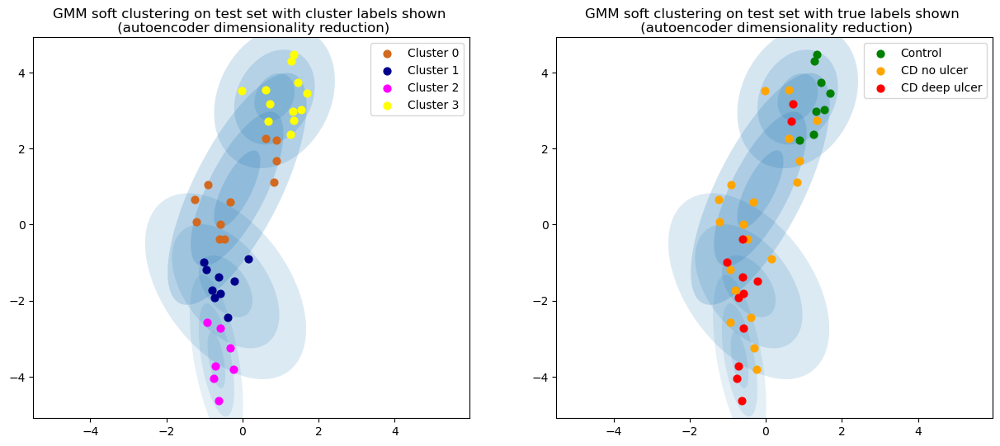

In [68]:
perplexity = 130
gmm_ae, X_train_ae, X_test_ae, X_val_ae = fit_gmm(full_ae_dataset, perplexity, num_c) # get 2D points
gmm_labels_ae = plot_gmm(gmm_ae, X_test_ae, X_val_ae, test_disease_labels, "autoencoder", num_c=num_c, test=True)

In [69]:
# np.where(X_test_ae >-30 )
# and X_test_ae[0] <-20
# (X_test_ae > -30 && X_test_ae < -20).all()
# y.logical_and(a, b)
# (X_test_ae[:,0] > -30) and (X_test_ae[:,1] < -20)
# arr = np.logical_and(X_test_ae[:,0] < -20, X_test_ae[:,1] < -12, X_test_ae[:,1] > -20)
# np.where(arr)

In [70]:
# X_test_ae[18,:]

## Process GMM cluster models

In [71]:
import scipy.stats
from scipy.stats import multivariate_normal


In [72]:
# vis
# x, y = np.mgrid[0:30:.01, 0:30:.01]
# pos = np.dstack((x, y))
# fig2 = plt.figure()
# ax2 = fig2.add_subplot(111)
# # for i in range(2):
# ax2.contourf(x, y, comps[0].pdf(pos))
# ax2.contourf(x, y, comps[2].pdf(pos))

In [73]:
def get_amount_matrix_gmm(gmm, X_train, train_disease_labels):
    mu, covar, w = gmm.means_, gmm.covariances_, gmm.weights_
    # print("means:",mu)
    # print("covariances_:",covar)
    # print("weights_:",w)
    
    comps = [multivariate_normal(mu[i], covar[i]) for i in range(num_c)]
    
    # make matrix to record amount of each class in each mixture component
    amounts = np.zeros((3, num_c))
    
    
    classes = ["control", "CD_no_ulcer", "CD_deep_ulcer"]
    for c, cls in enumerate(classes):
        for i, comp in enumerate(comps): # add up contributions for each component
            weight = w[i]
            pts = X_train[train_disease_labels==c]
            curr_sum = np.sum(comp.pdf(pts)) * weight
            amounts[c][i] = curr_sum
    print(amounts)
    #                cluster 0, cluster 1, cluster 2, cluster 3
    # control 
    # CD no ulcer
    # CD deep ulcer
    
    return amounts


def sum_to_one(vals): 
#     print(t, u)
    for i in range(vals.shape[0]):
        row = vals[i,:]
        vals[i,:] = row / row.sum()
    
    return vals


In [74]:
def get_class_probs(X_test, gmm, assignments, couple):
    clus_probs = sum_to_one(gmm.predict_proba(X_test))
#     print("clus_probs:",clus_probs)
    num_classes = 3
    
    arr = np.zeros((X_test.shape[0], num_classes))
    for c in range(num_classes):
        if assignments[c] == couple:
            arr[:,c] = np.max(clus_probs[:,couple], axis=1)
        else:
            cluster = assignments[c][0]
            arr[:,c] = clus_probs[:,cluster]
    arr = sum_to_one(arr)
            
    return np.argmax(arr, axis=1), arr

In [75]:
# gmm_prediction_ae(x_test_scaled)

In [76]:
# gmm_prediction_ae(x_test_scaled.iloc[[41],:])

In [77]:
def final_gmm_model_get_clusters(gmm, X_train, X_test, train_disease_labels):
    # process
    amounts = get_amount_matrix_gmm(gmm, X_train, train_disease_labels)
    assignments, couple = process_clusters(amounts, X_train, num_c)
    # retrieve clusters
#     gmm_labels = gmm.predict(X_test)
#     test_set_clusters = get_final_clusters(assignments, couple, gmm_labels)
    test_set_clusters, probs = get_class_probs(X_test, gmm, assignments, couple)
#     print(test_set_clusters)
#     print(probs)
    
    return test_set_clusters, probs



### Post-processed GMM models on test set

In [78]:
# gmm_labels_list = [gmm_labels_ae, gmm_labels_pca]
gmm_models_list = [gmm_ae, gmm_pca]
train_set_list = [X_train_ae, X_train_pca]
test_set_list = [X_test_ae, X_test_pca]


In [79]:
# X_test_ae

C:\Users\shard\AppData\Local\Temp\ipykernel_22504\2466639589.py:54: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_test[test_set_clusters==i, 0], X_test[test_set_clusters==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\2466639589.py:54: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_test[test_set_clusters==i, 0], X_test[test_set_clusters==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_22504\437439158.py:21: Matp

autoencoder
[[2.51795068e-01 1.01692486e-01 9.59587160e-04 1.50305965e+00]
 [2.68889718e+00 1.00887558e+00 1.39093795e+00 1.77108383e+00]
 [8.41099406e-01 8.31936701e-01 1.92216020e+00 2.30460157e-01]]
PCA
[[0.04275353 0.00480695 0.0062074  0.04586414]
 [0.05109045 0.10104818 0.17561614 0.05692414]
 [0.00175867 0.10508606 0.05890847 0.00603537]]


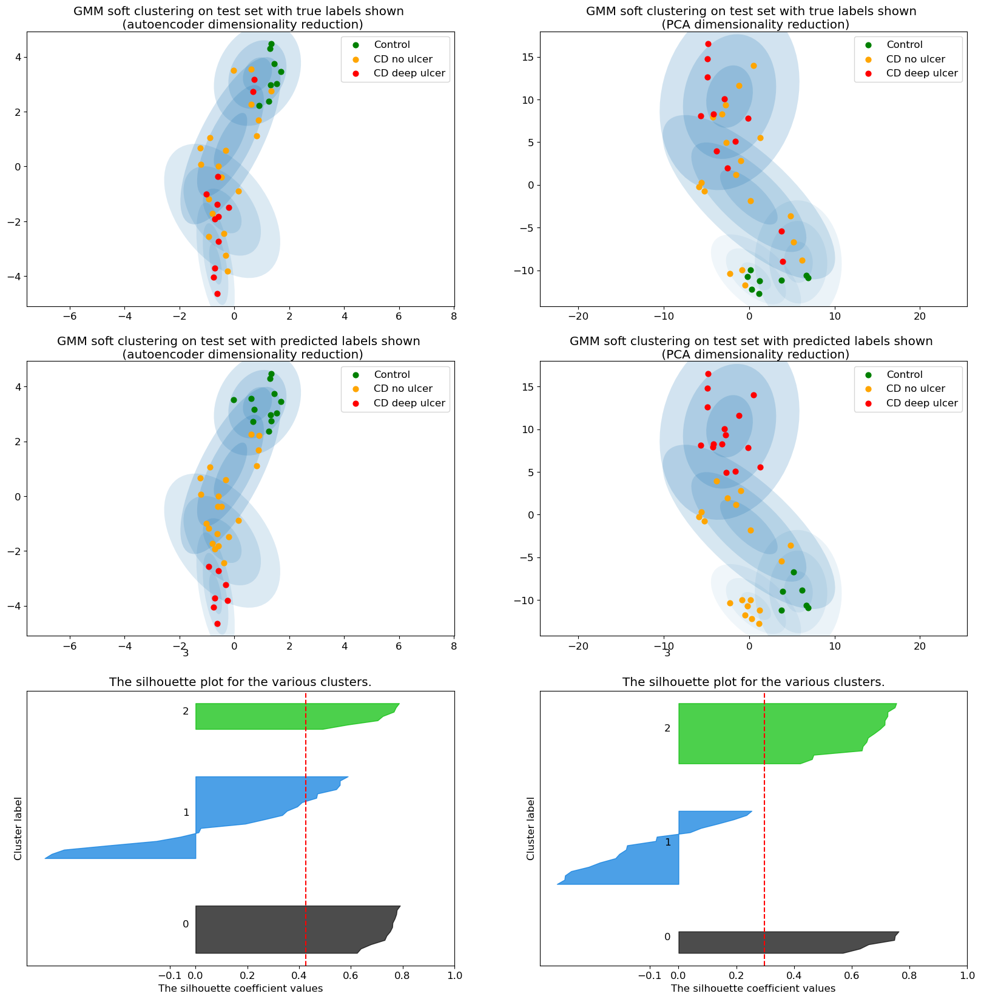

Autoencoder:
Average silhouette score: 0.4257145
Accuracy: 0.6153846153846154
F1 score: 0.5979307242465138
PCA:
Average silhouette score: 0.2981507
Accuracy: 0.5384615384615384
F1 score: 0.5335885335885335


In [80]:
plt.rcParams.update({'font.size': 12})

def plot_final_gmm_models(gmm_models_list, test_disease_labels, train_set_list, test_set_list, num_c):
#         left = -8
#         right = 8
#         ax.set_xlim(left, right)
#         ax.set_ylim(left, right)
        
        
#         if i==0:
#             num_clusters = num_c
#             cluster_names = ["Cluster " + str(i) for i in range(num_clusters)]
#             colours = ["chocolate", "darkblue", "magenta", "yellow", "blue"]
#             ax.set_title("GMM soft clustering on " + dset + " set with cluster labels shown \n (" + reduction + " dimensionality reduction)",
#                          wrap=True)
#         else:
#     fig, ax = plt.subplots()
    (fig, subplots) = plt.subplots(3, 2, figsize=(20, 20))
    reduction = ["autoencoder", "PCA"]
    final_clusters_lst = []
    final_probs_lst = []
    label_type = ["true","predicted"]
    for t in range(2):
        label = label_type[t]
        for i in range(len(gmm_models_list)):
    #         print(i)
            ax = subplots[t][i]
            gmm = gmm_models_list[i]
    #         gmm_labels = gmm_labels_list[i]
            X_train = train_set_list[i]
            X_test = test_set_list[i]
    #         amounts = get_amount_matrix_gmm(gmm, X_train, train_disease_labels)
    #         assignments, couple = process_clusters(amounts, X_train, num_c)
    #         test_set_clusters = get_final_clusters(assignments, couple, gmm_labels)
            if t > 0:
                print(reduction[i])
                test_set_clusters, probs = final_gmm_model_get_clusters(gmm, X_train, X_test, train_disease_labels)
                final_clusters_lst.append(test_set_clusters)
                final_probs_lst.append(probs)
            else:
                test_set_clusters = test_disease_labels




            reduc = reduction[i]
            num_clusters = 3
            cluster_names = ["Control", "CD no ulcer", "CD deep ulcer"]
            colours = ["green", "orange", "red"]
            ax.set_title("GMM soft clustering on test set with "+ label +" labels shown \n (" + reduc + " dimensionality reduction)",
                        wrap=True)

            for i in range(num_clusters):
                ax.scatter(X_test[test_set_clusters==i, 0], X_test[test_set_clusters==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2) 

            ax.axis('equal')


            w_factor = 0.2 / gmm.weights_.max()
            for pos, covar, w in zip(gmm.means_, gmm.covariances_, gmm.weights_):
                draw_ellipse(pos, covar, alpha=w * w_factor, ax=ax)
            ax.legend()

#     s_avgs = []
#     for j in range(2):
#         ax = subplots[2][j]
#         X_test = test_set_list[j]
#         test_clusters = final_clusters_lst[j]

#         silhouette_avg, sample_silhouette_values = compute_silh_scores(X_test, test_clusters)
#         s_avgs.append(silhouette_avg)
#         plot_silhouette(num_c, test_clusters, sample_silhouette_values, silhouette_avg, ax)
        
#             s_avgs = []


    s_avgs = []        
    accs = []
    f1_scores = []
    for j in range(2):
        ax = subplots[2][j]
        X_test = test_set_list[j]
        test_clusters = final_clusters_lst[j]

#         silhouette_avg, sample_silhouette_values = compute_silh_scores(X_test, test_clusters)
#         print(silhouette_avg)
        sil, sample_silhouette_values, acc, f1 = compute_metrics(X_test, test_disease_labels, test_clusters)
        s_avgs.append(sil)
        accs.append(acc)
        f1_scores.append(f1)
        plot_silhouette(num_c, test_clusters, sample_silhouette_values, sil, ax)

    plt.show()


    print_scores(s_avgs, accs, f1_scores)


    return final_clusters_lst, final_probs_lst
        
final_clusters_lst, final_probs_lst = plot_final_gmm_models(gmm_models_list, test_disease_labels, train_set_list, test_set_list, num_c)

3rd graph - substructure clustering processed in combination with true labels to obtain final 3 cluster clustering; model can now be easily coupled to shap - why better than simple k=3 clustering

In [81]:
x_test_scaled.iloc[[18],:]

,AADAC,APOA1,APOA4,APOB,APOC3,AQP9,C6,CEACAM7,CHI3L1,ABCC2,...,HDLBP,PIAS4,ADH1B,LOC100507531,FAM83A,NXF4,RNF125,DARS,DNAI1,MBTPS1
Patient_ID,,,,,,,,,,,,,,,,,,,,,
46_CD_deep_ulcer,0.438089,0.482152,0.410237,0.378247,0.438691,0.705762,0.339106,0.559666,0.878088,0.228893,...,0.964177,0.715558,0.716592,0.0,0.684122,0.0,0.136883,0.624877,0.0,0.877226


In [82]:
# plt.figure()
# plt.scatter(X_test_ae[final_clusters_gmm_ae.reshape(1,-1)[0]==0,0], X_test_ae[final_clusters_gmm_ae.reshape(1,-1)[0]==0,1], color='g')
# plt.scatter(X_test_ae[final_clusters_gmm_ae.reshape(1,-1)[0]==1,0], X_test_ae[final_clusters_gmm_ae.reshape(1,-1)[0]==1,1], color='yellow')
# plt.scatter(X_test_ae[final_clusters_gmm_ae.reshape(1,-1)[0]==2,0], X_test_ae[final_clusters_gmm_ae.reshape(1,-1)[0]==2,1], color='red')
# plt.show()

In [83]:
# final_probs_gmm_ae[final_clusters_gmm_ae.reshape(1,-1)[0]==2]

In [84]:
# final_clusters_gmm_ae.reshape(1,-1)[0]==0

## Evaluation of final clustering models

In [85]:
final_clusters_gmm_ae, final_clusters_gmm_pca = final_clusters_lst
final_probs_gmm_ae, final_probs_gmm_pca = final_probs_lst

In [86]:
test_disease_labels = test_disease_labels.reshape(1,-1)[0]

In [87]:
test_labels = test_disease_labels.reshape(-1,1)

In [88]:
test_disease_labels

array([1, 0, 2, 1, 1, 1, 2, 2, 0, 1, 1, 1, 2, 1, 0, 2, 0, 2, 0, 1, 2, 1,
       2, 0, 1, 2, 1, 0, 1, 1, 1, 2, 1, 0, 1, 1, 1, 2, 2])

## CD vs control (binary classification)

In [89]:
test_disease_labels_binary = test_disease_labels.copy()
test_disease_labels_binary[test_disease_labels_binary==2] = 1
test_disease_labels_binary = test_disease_labels_binary.reshape(-1,1)

### GMM

In [90]:
final_clusters_gmm_ae_binary = final_clusters_gmm_ae.copy()
final_clusters_gmm_ae_binary[final_clusters_gmm_ae_binary==2] = 1
final_clusters_gmm_ae_binary = final_clusters_gmm_ae_binary.reshape(-1,1)

In [91]:
final_clusters_gmm_pca_binary = final_clusters_gmm_pca.copy()
final_clusters_gmm_pca_binary[final_clusters_gmm_pca_binary==2] = 1
final_clusters_gmm_pca_binary = final_clusters_gmm_pca_binary.reshape(-1,1)

In [92]:
# AE
accuracy_score(test_disease_labels_binary, final_clusters_gmm_ae_binary)

0.8461538461538461

In [93]:
f1_score(test_disease_labels_binary, final_clusters_gmm_ae_binary)

0.896551724137931

In [94]:
silhouette_avg, sample_silhouette_values = compute_silh_scores(X_test_ae, final_clusters_gmm_ae_binary)
silhouette_avg

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\utils\validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\utils\validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


0.5133401

In [95]:
# PCA
accuracy_score(test_disease_labels_binary, final_clusters_gmm_pca_binary)

0.7948717948717948

In [96]:
f1_score(test_disease_labels_binary, final_clusters_gmm_pca_binary)

0.875

In [97]:
silhouette_avg, sample_silhouette_values = compute_silh_scores(X_test_pca, final_clusters_gmm_pca_binary)
silhouette_avg

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\utils\validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\utils\validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


0.23317353

### KMeans

In [98]:
final_clusters_km_ae_binary = final_clusters_ae.copy()
final_clusters_km_ae_binary[final_clusters_km_ae_binary==2] = 1
final_clusters_km_ae_binary = final_clusters_km_ae_binary.reshape(-1,1)

final_clusters_km_pca_binary = final_clusters_pca.copy()
final_clusters_km_pca_binary[final_clusters_km_pca_binary==2] = 1
final_clusters_km_pca_binary = final_clusters_km_pca_binary.reshape(-1,1)

In [99]:
# AE
accuracy_score(test_disease_labels_binary, final_clusters_km_ae_binary)

0.8461538461538461

In [100]:
f1_score(test_disease_labels_binary, final_clusters_km_ae_binary)

0.8928571428571428

In [101]:
silhouette_avg, sample_silhouette_values = compute_silh_scores(X_test_ae, final_clusters_km_ae_binary)
silhouette_avg

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\utils\validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\utils\validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


0.58710295

In [102]:
# PCA
accuracy_score(test_disease_labels_binary, final_clusters_km_pca_binary)

0.8461538461538461

In [103]:
f1_score(test_disease_labels_binary, final_clusters_km_pca_binary)

0.8928571428571428

In [104]:
silhouette_avg, sample_silhouette_values = compute_silh_scores(X_test_pca, final_clusters_km_pca_binary)
silhouette_avg

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\utils\validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\utils\validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


0.5321082

## Control, CD no ulcer, CD deep ulcer (multiclass)

### GMM

In [105]:
final_clusters_gmm_ae = final_clusters_gmm_ae.reshape(-1,1)
final_clusters_gmm_pca = final_clusters_gmm_pca.reshape(-1,1)


In [106]:
final_clusters_gmm_ae.shape

(39, 1)

In [107]:
test_disease_labels.shape

(39,)

### Autoencoder

In [108]:
accuracy = accuracy_score(test_disease_labels, final_clusters_gmm_ae)
accuracy

0.6153846153846154

In [109]:
f1_score(test_disease_labels, final_clusters_gmm_ae, average='weighted')

0.5979307242465138

In [110]:
silhouette_avg, sample_silhouette_values = compute_silh_scores(X_test_ae, final_clusters_gmm_ae)
silhouette_avg

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\utils\validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\utils\validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


0.4257145

### PCA

In [111]:
accuracy = accuracy_score(test_disease_labels, final_clusters_gmm_pca)
accuracy

0.5384615384615384

In [112]:
f1_score(test_disease_labels, final_clusters_gmm_pca, average='weighted')

0.5335885335885335

In [113]:
silhouette_avg, sample_silhouette_values = compute_silh_scores(X_test_pca, final_clusters_gmm_pca)
silhouette_avg

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\utils\validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\utils\validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


0.2981507

### KMeans

In [114]:
final_clusters_ae = final_clusters_ae.reshape(-1,1)
final_clusters_pca = final_clusters_pca.reshape(-1,1)

### Autoencoder

In [115]:
km_ae_accuracy = accuracy_score(test_disease_labels, final_clusters_ae)
km_ae_accuracy

0.6410256410256411

In [116]:
f1_score(test_disease_labels, final_clusters_ae, average='weighted')

0.6192696192696193

In [117]:
silhouette_avg, sample_silhouette_values = compute_silh_scores(X_test_ae, final_clusters_ae)
silhouette_avg

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\utils\validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\utils\validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


0.5006465

### PCA

In [118]:
km_pca_accuracy = accuracy_score(test_disease_labels, final_clusters_pca)
km_pca_accuracy

0.6153846153846154

In [119]:
f1_score(test_disease_labels, final_clusters_pca, average='weighted')

0.601931401931402

In [120]:
silhouette_avg, sample_silhouette_values = compute_silh_scores(X_test_pca, final_clusters_pca)
silhouette_avg

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\utils\validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\utils\validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


0.39453965

## Find class probabilities from cluster model

In [121]:
def get_probs(point, comps, assignments, w):
    probs = []
    for elem in assignments:
        p_cand = []
        for cluster in elem:
            p = comps[cluster].pdf(point) * w[cluster]
#             print("p:",p)
            p_cand.append(p)
#         print(p_cand)
        p = max(p_cand)
        probs.append(p)
        
    return probs

def sum_to_one(vals): 
#     print(t, u)
    for i in range(vals.shape[0]):
        row = vals[i,:]
        vals[i,:] = row / row.sum()
    
    return vals




In [122]:
def get_proba(gmm, assignments, X_test):
    # GMM mixture component distributions
    mu, covar, w = gmm.means_, gmm.covariances_, gmm.weights_
    # print("means:",mu)
    # print("covariances_:",covar)
    # print("weights_:",w)
    comps = [multivariate_normal(mu[i], covar[i]) for i in range(num_c)]

    X_test = X_test.tolist()
    new_list = []
    for point in X_test:
        probs = get_probs(point, comps, assignments, gmm.weights_)
#         print(probs)
        new_list.append(probs)
    pdf_vals = np.asarray(new_list)
#     pdf_vals = -np.log(pdf_vals)
    
#     plt.figure()
#     xr = np.arange(len(pdf_vals))
#     plt.scatter(xr, pdf_vals[:,0])
#     plt.scatter(xr, pdf_vals[:,1])
#     plt.scatter(xr, pdf_vals[:,2])
#     plt.show()

    # rescale so adds up to 1
#     proba = pdf_vals.copy()
#     for i in range(len(proba)):
#         row = proba[i,:]
#         rescaled = softmax(row)

#         proba[i,:] = rescaled
    proba = pdf_vals
    
    return proba

In [123]:
# amounts = get_amount_matrix_gmm(gmm_ae, X_train_ae, train_disease_labels)
# assignments_ae, couple_ae = process_clusters(amounts, X_train_ae, num_c)
# assignments_ae

In [124]:
# amounts = get_amount_matrix_gmm(gmm_pca, X_train_pca, train_disease_labels)
# assignments_pca, couple_pca = process_clusters(amounts, X_train_pca, num_c)
# assignments_pca

In [125]:
# gmm = gmm_ae
# assignments = assignments_ae

In [126]:
# gmm_ae_prob = get_proba(gmm_ae, assignments_ae, X_test_ae)

In [127]:
# gmm_pca_prob = get_proba(gmm_pca, assignments_pca, X_test_pca)